In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import os
import numpy as np
import torch.optim as optim

#RNN from scratch

### RNN with A Single Neuron

![alt txt](https://docs.google.com/drawings/d/e/2PACX-1vQXBLYvvI1dqAHdLA0hQdsP1PojmCfuSCMK2DXEL0uTvRUqvD1eYK8fsECcNCoekxCbgWJ-k7QF_1s4/pub?w=600&h=400)

And here is the code:

In [ ]:
class BasicRNN(nn.Module):
    def __init__(self, n_inputs, n_neurons):
        super(BasicRNN, self).__init__()

        # define: weight for x h, define b
        self.Wx = torch.randn(n_inputs, n_neurons)
        self.Wh = torch.randn(n_neurons, n_neurons)
        self.b = torch.zeros(1, n_neurons)

    def forward(self, X, h):
        # compute output of hidden (as y)
        y = torch.tanh(torch.mm(X, self.Wx) + torch.mm(h, self.Wh) + self.b)
        return y

And this is the code to test the model:

In [ ]:
N_INPUT = 4
N_NEURONS = 1

X1 = torch.tensor([[0,1,2,0]],dtype = torch.float) #Sequence 0
X2 = torch.tensor([[9,8,7,0]],dtype = torch.float) #Sequence 1

# test the model
model = BasicRNN(N_INPUT, N_NEURONS)
h0 = torch.zeros(1, N_NEURONS)
h1 = model(X1, h0)
h2 = model(X2, h1)
print(h1)
print(h2)


tensor([[-0.0114]])
tensor([[1.0000]])


### RNN with 5 Neurons

![alt txt](https://docs.google.com/drawings/d/e/2PACX-1vQov6BGg1fXOb7Bg5zenPh7R5j6VsZJh_D6JevQ_sm_fCxmXORxad3qLIFGG1FojzJig0qdcAQoGYoN/pub?w=600&h=404)

In [ ]:
# test the model...
N_INPUT = 4
N_NEURONS = 5

X1 = torch.tensor([[0,1,2,0]],dtype = torch.float) #Sequence 1
X2 = torch.tensor([[9,8,7,0]],dtype = torch.float) #Sequence 2

# test the model
model = BasicRNN(N_INPUT, N_NEURONS)
h0 = torch.zeros(4, N_NEURONS)
h1 = model(X1, h0)
h2 = model(X2, h1)
print(h1)
print(h2)


tensor([[-0.6557, -0.9879, -0.9989, -0.1334, -0.9214],
        [-0.6557, -0.9879, -0.9989, -0.1334, -0.9214],
        [-0.6557, -0.9879, -0.9989, -0.1334, -0.9214],
        [-0.6557, -0.9879, -0.9989, -0.1334, -0.9214]])
tensor([[-1.0000, -1.0000, -1.0000, -1.0000, -0.9843],
        [-1.0000, -1.0000, -1.0000, -1.0000, -0.9843],
        [-1.0000, -1.0000, -1.0000, -1.0000, -0.9843],
        [-1.0000, -1.0000, -1.0000, -1.0000, -0.9843]])


# RNN using nn.Linear

In [ ]:
class RNNLinear(nn.Module):
    def __init__(self, n_inputs, n_neurons):
        super(RNNLinear, self).__init__()

        # define linear layer for i2h(wx), h2h(wh)
        self.i2h = nn.Linear(n_inputs, n_neurons)
        self.h2h = nn.Linear(n_neurons, n_neurons)

    def forward(self, X, h):
        # compute output of hidden (as y)
        y = torch.tanh(self.i2h(X) + self.h2h(h))
        return y

In [ ]:
# test the model
# new object, call model for seql seq2

N_INPUT = 4
N_NEURONS = 1

X1 = torch.tensor([[0,1,2,0]],dtype = torch.float) #Sequence 1
X2 = torch.tensor([[9,8,7,0]],dtype = torch.float) #Sequence 2

# test the model
model = RNNLinear(N_INPUT, N_NEURONS)
h0 = torch.zeros(1, N_NEURONS)
h1 = model(X1, h0)
h2 = model(X2, h1)
print(h1)
print(h2)


tensor([[-0.6989]], grad_fn=<TanhBackward0>)
tensor([[-1.0000]], grad_fn=<TanhBackward0>)


#PyTorch Built-in RNN Cell

In [ ]:
# Create the input tensor: 2 batches, 4 sequences, 3 dimensions
X = torch.tensor([[
    [0, 1, 2],
    [3, 4, 5],
    [6, 7, 8],
    [9, 0, 1]],
    [[9, 8, 7],
    [0, 0, 0],
    [6, 5, 4],
    [3, 2, 1]]], dtype=torch.float)  # Shape: (2, 4, 3)

##nn.RNNCell()

In [ ]:
# Define the RNN Cell
rnn = nn.RNNCell(3, 5)  # 3-input features, 5 hidden neurons

output = []
for i in range(2):  # Loop over batches
    state = []
    h = torch.zeros(5)  # Initialize hidden state
    for j in range(4):  # Loop over sequences
        print(f"Input for batch {i}, sequence {j}: {X[i, j, :]}")
        h = rnn(X[i, j, :], h)  # Update hidden state
        state.append(h)
    output.append(state)

print("Final output hidden states:")
print(output)


print(output[-1][-1])
print(h)

Input for batch 0, sequence 0: tensor([0., 1., 2.])
Input for batch 0, sequence 1: tensor([3., 4., 5.])
Input for batch 0, sequence 2: tensor([6., 7., 8.])
Input for batch 0, sequence 3: tensor([9., 0., 1.])
Input for batch 1, sequence 0: tensor([9., 8., 7.])
Input for batch 1, sequence 1: tensor([0., 0., 0.])
Input for batch 1, sequence 2: tensor([6., 5., 4.])
Input for batch 1, sequence 3: tensor([3., 2., 1.])
Final output hidden states:
[[tensor([-0.7621, -0.0368,  0.4054, -0.0107,  0.4198],
       grad_fn=<SqueezeBackward1>), tensor([-0.9961,  0.8644,  0.8368, -0.3204,  0.9958],
       grad_fn=<SqueezeBackward1>), tensor([-1.0000,  0.9953,  0.9613, -0.8348,  1.0000],
       grad_fn=<SqueezeBackward1>), tensor([-0.9980,  0.9704,  0.9946,  0.0721,  0.9981],
       grad_fn=<SqueezeBackward1>)], [tensor([-1.0000,  0.9995,  0.9962, -0.7736,  1.0000],
       grad_fn=<SqueezeBackward1>), tensor([-0.0012, -0.7934,  0.6579, -0.0300, -0.0992],
       grad_fn=<SqueezeBackward1>), tensor([-0.9

##nn.RNN()

In [ ]:
rnn = nn.RNN(3, 5, batch_first=True)

# Pass the input through the RNN
output, h_n = rnn(X)  # output: (batch_size, sequence_length, hidden_size), h_n: (num_layers, batch_size, hidden_size)

print("Output shape:", output.shape)  # Should be (2, 4, 5)
print("Output:", output)

print("Final hidden states shape:", h_n.shape)  # Should be (num_layers, batch_size, hidden_size)
print("Final hidden states:", h_n)


print(output[:,-1,:])
print(h_n)

Output shape: torch.Size([2, 4, 5])
Output: tensor([[[-0.3527, -0.6282,  0.1045, -0.8193,  0.7291],
         [-0.8402, -0.9935,  0.6786, -0.9722,  0.9970],
         [-0.9656, -0.9999,  0.9001, -0.9956,  0.9999],
         [-0.4911, -0.9958, -0.9462,  0.9915,  0.9901]],

        [[-0.9505, -1.0000,  0.8400, -0.9619,  1.0000],
         [-0.3926,  0.3234, -0.4956, -0.1056,  0.3955],
         [-0.6546, -0.9994,  0.6649, -0.8157,  0.9973],
         [-0.6607, -0.9128, -0.4278, -0.0973,  0.9312]]],
       grad_fn=<TransposeBackward1>)
Final hidden states shape: torch.Size([1, 2, 5])
Final hidden states: tensor([[[-0.4911, -0.9958, -0.9462,  0.9915,  0.9901],
         [-0.6607, -0.9128, -0.4278, -0.0973,  0.9312]]],
       grad_fn=<StackBackward0>)
tensor([[-0.4911, -0.9958, -0.9462,  0.9915,  0.9901],
        [-0.6607, -0.9128, -0.4278, -0.0973,  0.9312]],
       grad_fn=<SliceBackward0>)
tensor([[[-0.4911, -0.9958, -0.9462,  0.9915,  0.9901],
         [-0.6607, -0.9128, -0.4278, -0.0973,  0.9

## RNN for Image Classification

![alt txt](https://docs.google.com/drawings/d/e/2PACX-1vSiMstqkE9hTYmhPD3KMeFRNNKYA2NnrCayahBOEL1TalRqaWF7rH8a7O-nP9c-mKOdZRsWtmAGZfNN/pub?w=969&h=368)


In [ ]:
import torchvision
import torchvision.transforms as transforms

BATCH_SIZE = 64

# list all transformations
transform = transforms.Compose(
    [transforms.ToTensor()])

# download and load training dataset
trainset = torchvision.datasets.MNIST(root='./data', train=True,
                                        download=True, transform=transform)
trainloader = torch.utils.data.DataLoader(trainset, batch_size=BATCH_SIZE,
                                          shuffle=True, num_workers=2)

# download and load testing dataset
testset = torchvision.datasets.MNIST(root='./data', train=False,
                                       download=True, transform=transform)
testloader = torch.utils.data.DataLoader(testset, batch_size=BATCH_SIZE,
                                         shuffle=False, num_workers=2)

Failed to download (trying next):
HTTP Error 403: Forbidden



100%|██████████| 9912422/9912422 [00:00<00:00, 51466553.49it/s]


Extracting ./data/MNIST/raw/train-images-idx3-ubyte.gz to ./data/MNIST/raw

Failed to download (trying next):
HTTP Error 403: Forbidden



100%|██████████| 28881/28881 [00:00<00:00, 2044760.37it/s]

Extracting ./data/MNIST/raw/train-labels-idx1-ubyte.gz to ./data/MNIST/raw



Failed to download (trying next):
HTTP Error 403: Forbidden



100%|██████████| 1648877/1648877 [00:00<00:00, 13813079.88it/s]


Extracting ./data/MNIST/raw/t10k-images-idx3-ubyte.gz to ./data/MNIST/raw

Failed to download (trying next):
HTTP Error 403: Forbidden



100%|██████████| 4542/4542 [00:00<00:00, 7875373.61it/s]

Extracting ./data/MNIST/raw/t10k-labels-idx1-ubyte.gz to ./data/MNIST/raw



![alt txt](https://docs.google.com/drawings/d/e/2PACX-1vQWhELhewvq_bHgqwf4vwDb5B9DN9-jAxeTF9Y73zr-OsW6OXC-ngxAfojivXyZEhjzLXceTZU2Ncz3/pub?w=550&h=600)

In [ ]:
N_STEPS = 28 # seq
N_INPUTS = 28 # dim
N_NEURONS = 150 # node
N_OUTPUTS = 10 # class
N_EPHOCS = 10 # epoch

##Hand on

In [ ]:
class ImageRNN(nn.Module):
    def __init__(self, batch_size, n_steps, n_inputs, n_neurons, n_outputs):
        super(ImageRNN, self).__init__()

        self.n_neurons = n_neurons
        self.batch_size = batch_size
        self.n_steps = n_steps
        self.n_inputs = n_inputs
        self.n_outputs = n_outputs

        #... nn.RNN + nn.Linear
        self.basic_rnn = nn.RNN(self.n_inputs, self.n_neurons, batch_first = True)
        self.fully_connected = nn.Linear(self.n_neurons, self.n_outputs)

    def forward(self, X):
        self.hidden = torch.zeros(1, X.size(0), self.n_neurons)
        #... compute hidden and output
        output, self.hidden = self.basic_rnn(X, self.hidden)
        y = self.fully_connected(self.hidden)
        return y.view(-1, self.n_outputs)

In [ ]:
dataiter = iter(trainloader)
images, labels = next(dataiter)
model = ImageRNN(BATCH_SIZE, N_STEPS, N_INPUTS, N_NEURONS, N_OUTPUTS)
logits = model(images.view(-1, 28,28))
print(logits[0:10])

tensor([[ 0.0755,  0.0203, -0.0422, -0.1667,  0.0344, -0.0266,  0.0365,  0.0529,
         -0.0878, -0.0502],
        [ 0.0668,  0.0160, -0.0452, -0.1682,  0.0238, -0.0347,  0.0219,  0.0535,
         -0.0817, -0.0483],
        [ 0.0710,  0.0179, -0.0459, -0.1497,  0.0255, -0.0267,  0.0336,  0.0547,
         -0.0849, -0.0419],
        [ 0.0714,  0.0237, -0.0549, -0.1531,  0.0301, -0.0325,  0.0322,  0.0556,
         -0.0855, -0.0463],
        [ 0.0615,  0.0183, -0.0437, -0.1694,  0.0247, -0.0330,  0.0185,  0.0606,
         -0.0709, -0.0418],
        [ 0.0726,  0.0202, -0.0523, -0.1612,  0.0308, -0.0349,  0.0320,  0.0605,
         -0.0838, -0.0444],
        [ 0.0684,  0.0232, -0.0482, -0.1479,  0.0241, -0.0279,  0.0343,  0.0582,
         -0.0806, -0.0374],
        [ 0.0690,  0.0042, -0.0636, -0.1375,  0.0225, -0.0091,  0.0189,  0.0613,
         -0.0678, -0.0413],
        [ 0.0603,  0.0226, -0.0489, -0.1502,  0.0270, -0.0374,  0.0306,  0.0632,
         -0.0798, -0.0362],
        [ 0.0826,  

In [ ]:
# Device
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

# Model instance
model = ImageRNN(BATCH_SIZE, N_STEPS, N_INPUTS, N_NEURONS, N_OUTPUTS)
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)

def get_accuracy(logit, target, batch_size):
    ''' Obtain accuracy for training round '''
    corrects = (torch.max(logit, 1)[1].view(target.size()).data == target.data).sum()
    accuracy = 100.0 * corrects/batch_size
    return accuracy.item()

NameError: name 'ImageRNN' is not defined

In [ ]:
for epoch in range(N_EPHOCS):  # loop over the dataset multiple times
    train_running_loss = 0.0
    train_acc = 0.0
    model.train()

    # TRAINING ROUND
    for i, data in enumerate(trainloader):
         # zero the parameter gradients
        optimizer.zero_grad()

        # get the inputs
        inputs, labels = data
        inputs = inputs.view(-1, 28,28)

        # forward + backward + optimize
        outputs = model(inputs)

        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

        train_running_loss += loss.detach().item()
        train_acc += get_accuracy(outputs, labels, BATCH_SIZE)

    model.eval()
    print('Epoch:  %d | Loss: %.4f | Train Accuracy: %.2f'
          %(epoch, train_running_loss / i, train_acc/i))

Epoch:  0 | Loss: 0.6638 | Train Accuracy: 78.63
Epoch:  1 | Loss: 0.2946 | Train Accuracy: 91.47
Epoch:  2 | Loss: 0.2212 | Train Accuracy: 93.65
Epoch:  3 | Loss: 0.1926 | Train Accuracy: 94.60
Epoch:  4 | Loss: 0.1664 | Train Accuracy: 95.38
Epoch:  5 | Loss: 0.1595 | Train Accuracy: 95.57
Epoch:  6 | Loss: 0.1495 | Train Accuracy: 95.85
Epoch:  7 | Loss: 0.1364 | Train Accuracy: 96.17
Epoch:  8 | Loss: 0.1320 | Train Accuracy: 96.32
Epoch:  9 | Loss: 0.1225 | Train Accuracy: 96.56


In [ ]:
test_acc = 0.0
for i, data in enumerate(testloader, 0):
    inputs, labels = data
    inputs = inputs.view(-1, 28, 28)

    outputs = model(inputs)

    test_acc += get_accuracy(outputs, labels, BATCH_SIZE)

print('Test Accuracy: %.2f'%( test_acc/i))

Test Accuracy: 96.44


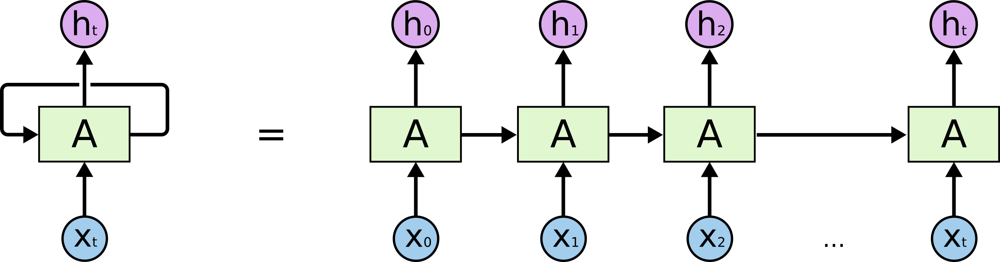

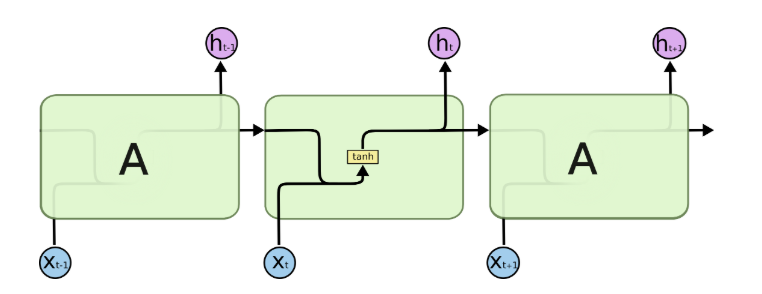

#Example

In [ ]:
import matplotlib.pyplot as plt

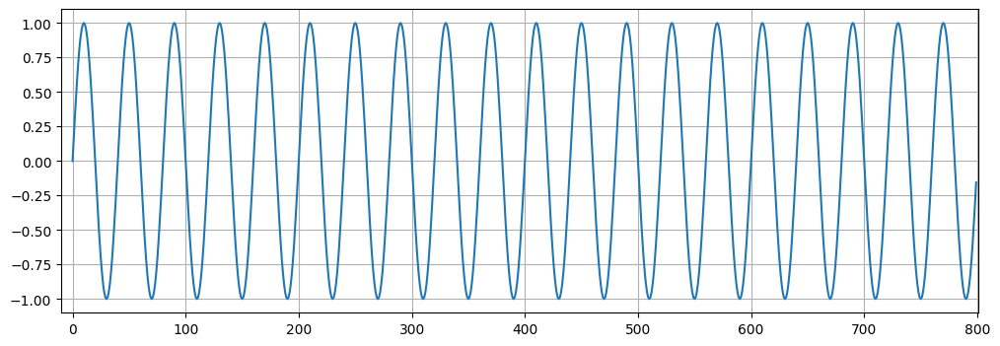

In [ ]:
# Create & plot data points
x = torch.linspace(0,799,steps=800)
y = torch.sin(x*2*3.1416/40)

plt.figure(figsize=(12,4))
plt.xlim(-10,801)
plt.grid(True)
plt.plot(y.numpy());

In [ ]:
test_size = 40

train_set = y[:-test_size]
test_set = y[-test_size:]

In [ ]:
def input_data(seq,ws):  # ws is the window size
    out = []
    L = len(seq)
    for i in range(L-ws):
        window = seq[i:i+ws]
        label = seq[i+ws:i+ws+1]
        out.append((window,label))
    return out

In [ ]:
window_size = 40

# Create the training dataset of sequence/label tuples:
train_data = input_data(train_set,window_size)

train_data[:3]

[(tensor([ 0.0000e+00,  1.5643e-01,  3.0902e-01,  4.5399e-01,  5.8779e-01,
           7.0711e-01,  8.0902e-01,  8.9101e-01,  9.5106e-01,  9.8769e-01,
           1.0000e+00,  9.8769e-01,  9.5106e-01,  8.9100e-01,  8.0901e-01,
           7.0710e-01,  5.8778e-01,  4.5398e-01,  3.0901e-01,  1.5643e-01,
          -7.2400e-06, -1.5644e-01, -3.0902e-01, -4.5400e-01, -5.8779e-01,
          -7.0711e-01, -8.0902e-01, -8.9101e-01, -9.5106e-01, -9.8769e-01,
          -1.0000e+00, -9.8769e-01, -9.5105e-01, -8.9100e-01, -8.0901e-01,
          -7.0710e-01, -5.8777e-01, -4.5398e-01, -3.0900e-01, -1.5642e-01]),
  tensor([1.4480e-05])),
 (tensor([ 1.5643e-01,  3.0902e-01,  4.5399e-01,  5.8779e-01,  7.0711e-01,
           8.0902e-01,  8.9101e-01,  9.5106e-01,  9.8769e-01,  1.0000e+00,
           9.8769e-01,  9.5106e-01,  8.9100e-01,  8.0901e-01,  7.0710e-01,
           5.8778e-01,  4.5398e-01,  3.0901e-01,  1.5643e-01, -7.2400e-06,
          -1.5644e-01, -3.0902e-01, -4.5400e-01, -5.8779e-01, -7.0711e-01

In [ ]:
class RNN(nn.Module):
    def __init__(self, input_size=1, hidden_size=50, out_size=1):
        super().__init__()
        self.hidden_size = hidden_size
        self.rnn = nn.RNN(input_size,hidden_size,batch_first=True)
        self.linear = nn.Linear(hidden_size,out_size)

    def forward(self,seq):
        hidden = torch.zeros(1,1,self.hidden_size)
        rnn_out, hidden = self.rnn(
            seq.view( 1,len(seq), -1), hidden)
        pred = self.linear(rnn_out.view(len(seq),-1))
        return pred[-1]   # we only care about the last prediction


Epoch:  1 Loss: 0.00013030
Loss on test predictions: 0.14415161311626434


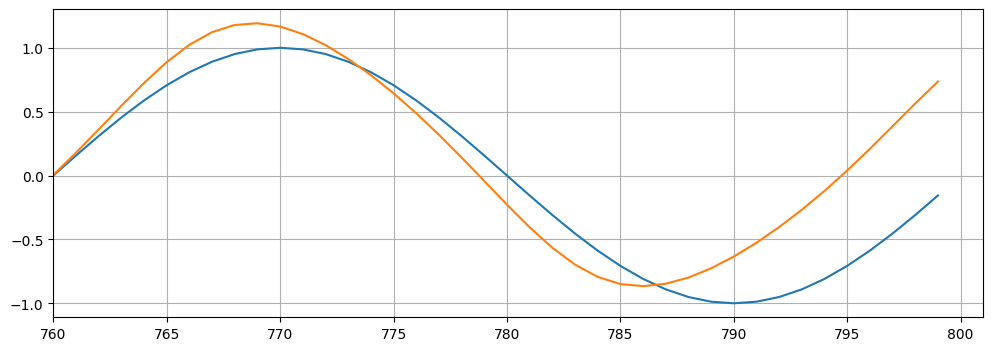

Epoch:  2 Loss: 0.00018692
Loss on test predictions: 0.08414526283740997


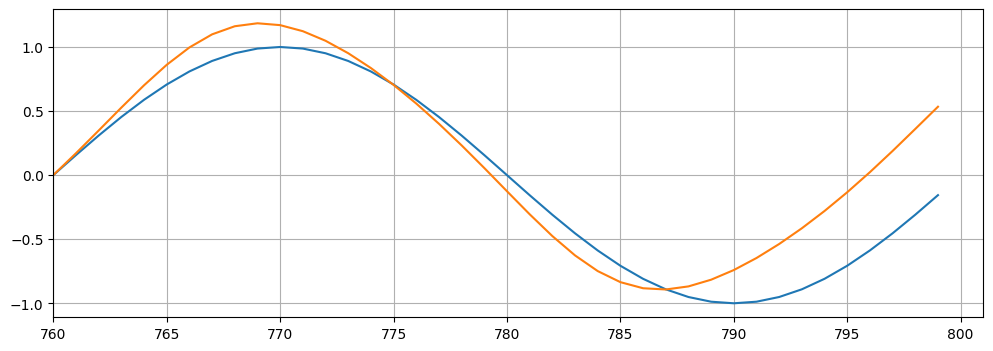

Epoch:  3 Loss: 0.00020968
Loss on test predictions: 0.04982487112283707


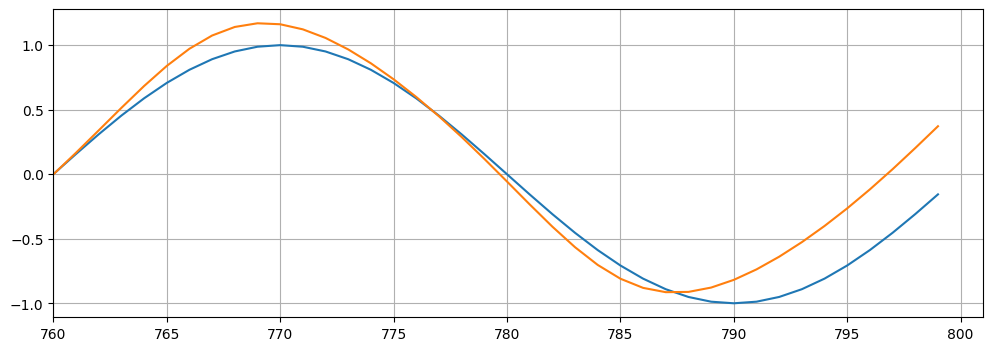

Epoch:  4 Loss: 0.00020701
Loss on test predictions: 0.030596351251006126


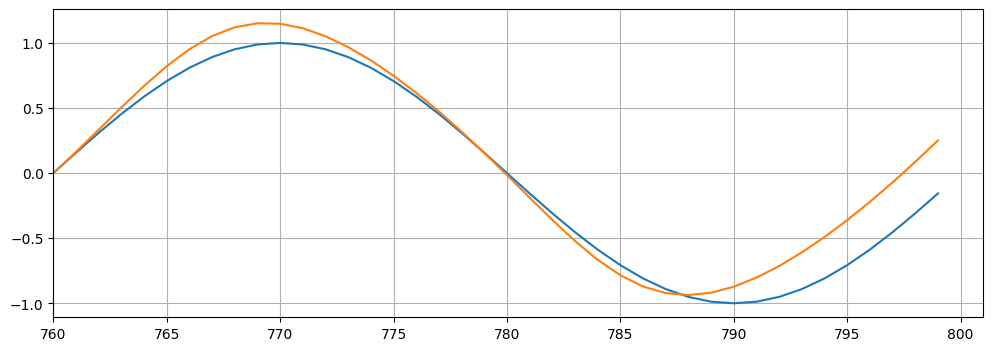

Epoch:  5 Loss: 0.00019092
Loss on test predictions: 0.019747067242860794


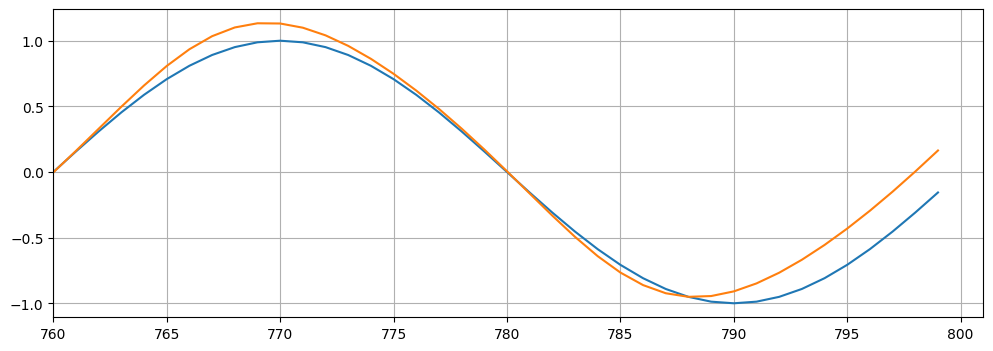

Epoch:  6 Loss: 0.00017054
Loss on test predictions: 0.013466347940266132


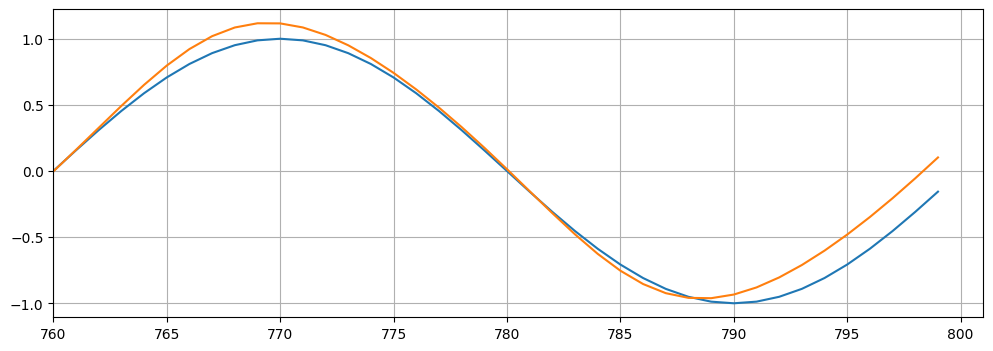

Epoch:  7 Loss: 0.00015121
Loss on test predictions: 0.009707147255539894


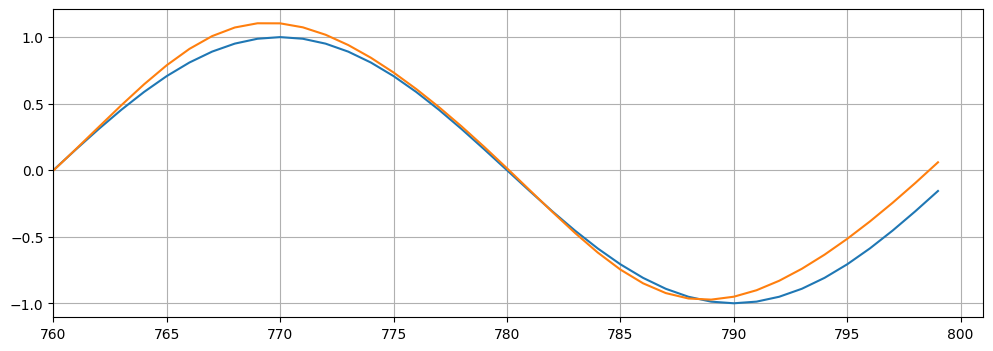

Epoch:  8 Loss: 0.00013547
Loss on test predictions: 0.007373817265033722


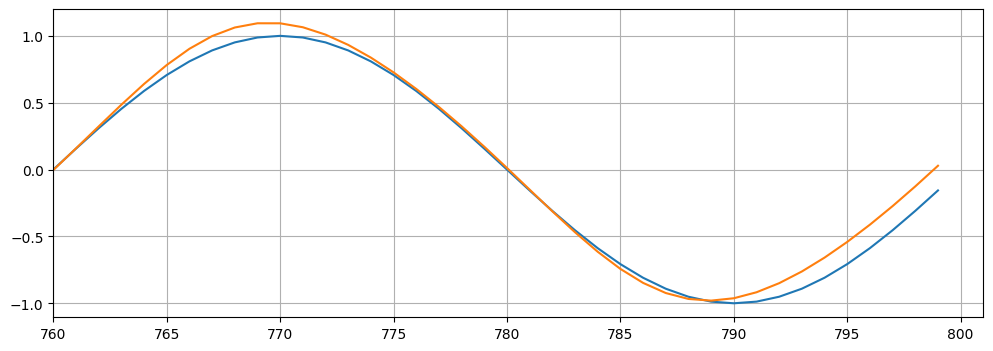

Epoch:  9 Loss: 0.00012420
Loss on test predictions: 0.005859625060111284


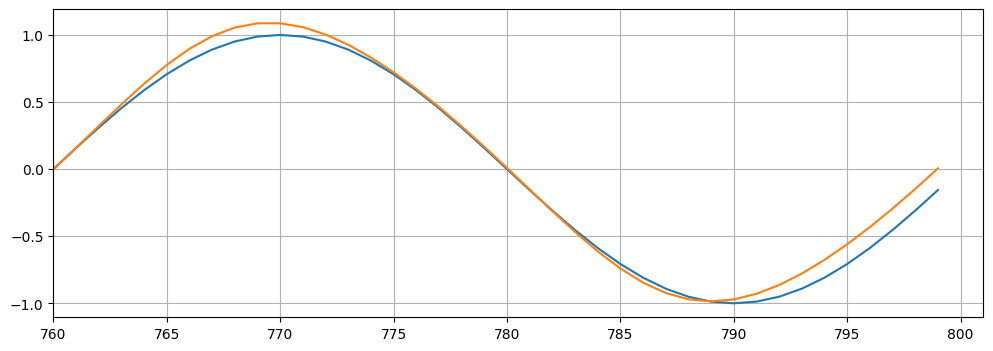

Epoch: 10 Loss: 0.00011745
Loss on test predictions: 0.004814562853425741


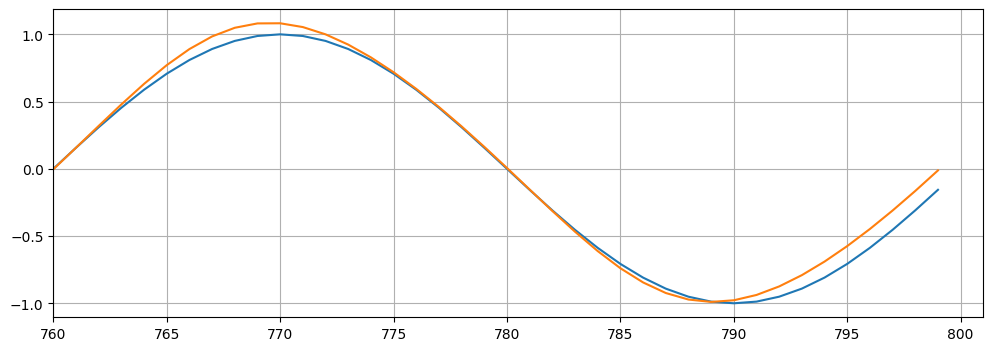

In [ ]:
model = RNN()
criterion = nn.MSELoss()
optimizer = torch.optim.SGD(model.parameters(), lr=0.01)

epochs = 10
future = 40

for i in range(epochs):

    # tuple-unpack the train_data set
    for x_train, y_train in train_data:

        # reset the parameters and hidden states
        optimizer.zero_grad()
        y_pred = model(x_train)

        loss = criterion(y_pred, y_train)
        loss.backward()
        optimizer.step()

    # print training result
    print(f'Epoch: {i+1:2} Loss: {loss.item():10.8f}')

    # MAKE PREDICTIONS
    preds = train_set[-window_size:].tolist()

    for f in range(future):
        seq = torch.FloatTensor(preds[-window_size:])
        with torch.no_grad():
            preds.append(model(seq).item())

    loss = criterion(torch.tensor(preds[-window_size:]),y[760:])
    print(f'Loss on test predictions: {loss}')

    # Plot from point 700 to the end
    plt.figure(figsize=(12,4))
    plt.xlim(760,801)
    plt.grid(True)
    plt.plot(range(760,800), y.numpy()[-window_size:])
    plt.plot(range(760,800),preds[window_size:])
    plt.show()

#LSTM

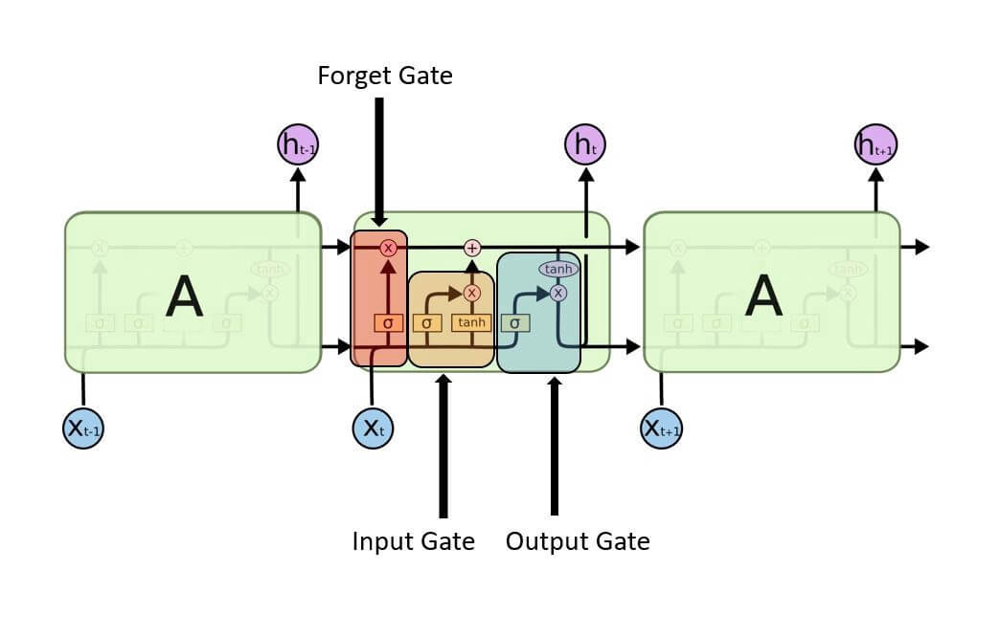

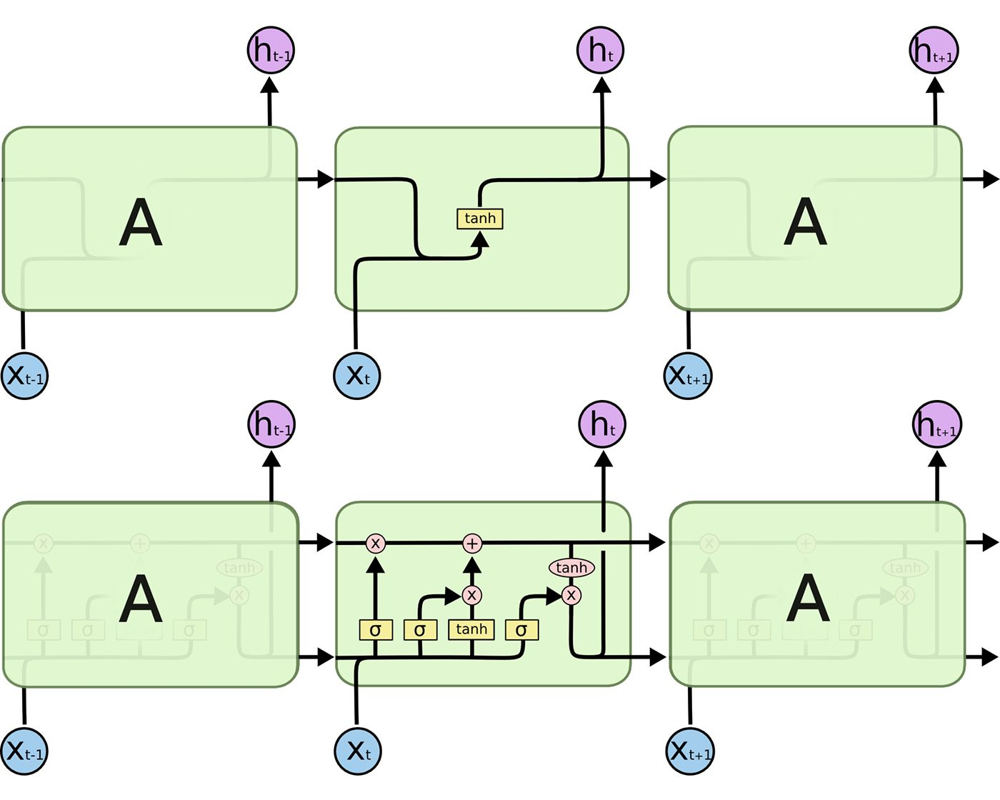

In [ ]:
class LSTM(nn.Module):
    def __init__(self, input_size=1, hidden_size=50, out_size=1):
        super().__init__()
        #...
        self.hidden_size = hidden_size
        self.lstm = nn.LSTM(input_size, hidden_size, batch_first=True)
        self.linear = nn.Linear(hidden_size, out_size)


    def forward(self,seq):
        #...
        hidden = (torch.zeros(1, 1, self.hidden_size),
                  torch.zeros(1, 1, self.hidden_size))
        latm_out, hidden = self.lstm(seq.view(1, len(seq), -1), hidden)
        pred = self.linear(latm_out.view(len(seq), -1))
        return pred[-1]


Epoch:  1 Loss: 0.08434252
Loss on test predictions: 0.599892258644104


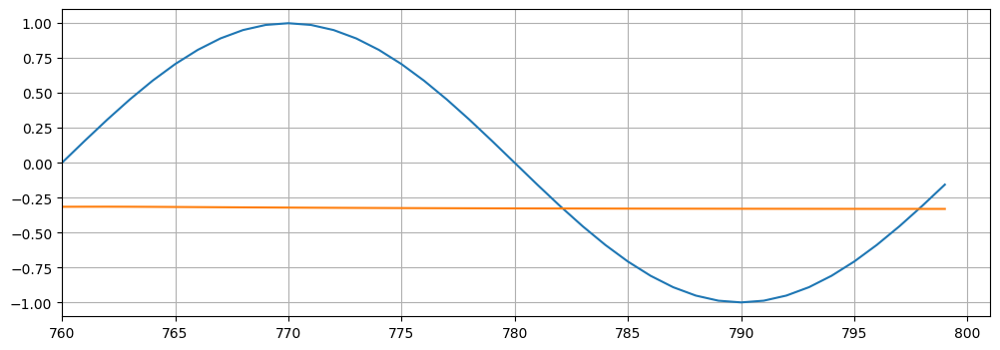

Epoch:  2 Loss: 0.05310744
Loss on test predictions: 0.5419768691062927


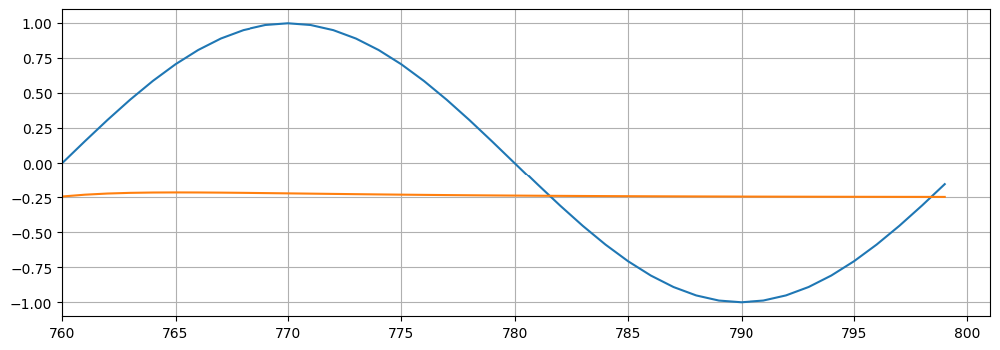

Epoch:  3 Loss: 0.01963161
Loss on test predictions: 0.41708460450172424


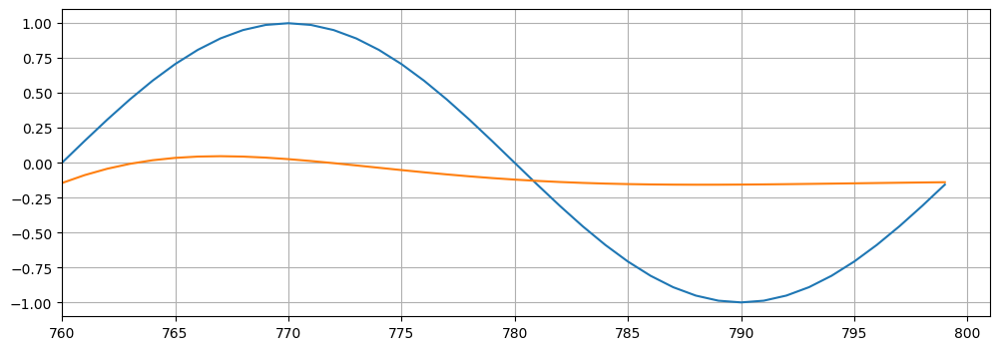

Epoch:  4 Loss: 0.00178520
Loss on test predictions: 0.10014550387859344


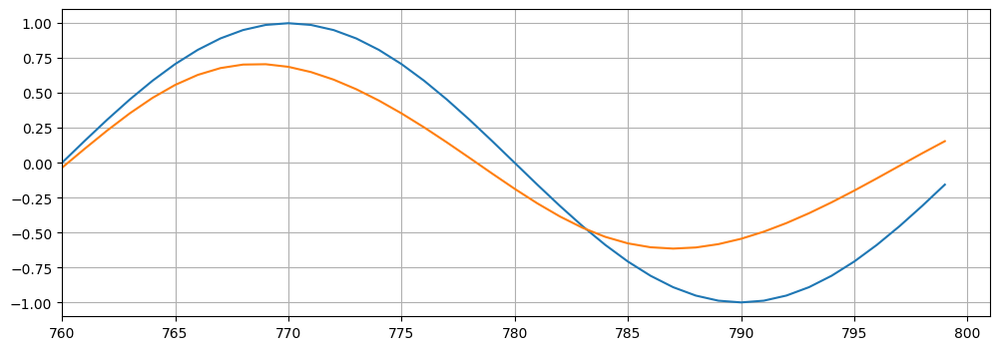

Epoch:  5 Loss: 0.00022696
Loss on test predictions: 0.004411153495311737


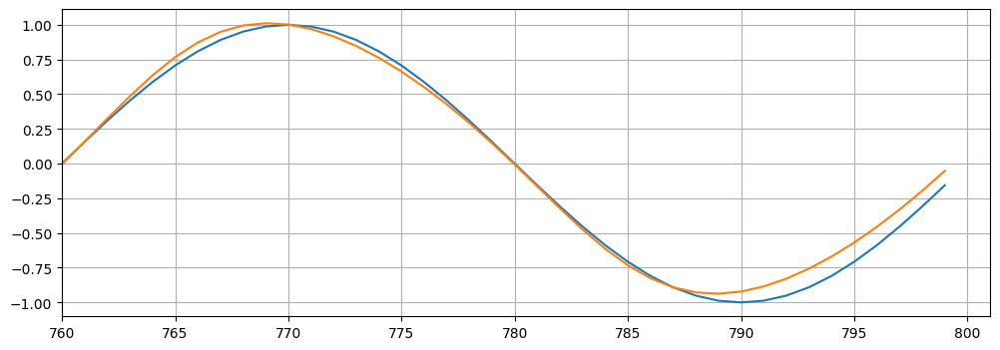

Epoch:  6 Loss: 0.00014061
Loss on test predictions: 0.0022306637838482857


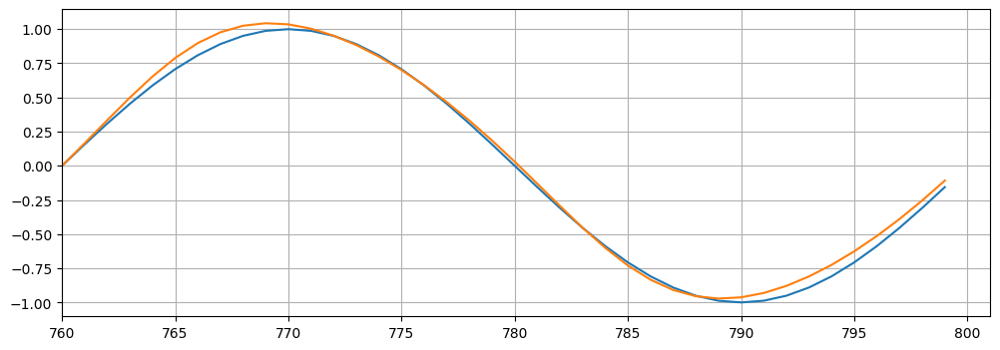

Epoch:  7 Loss: 0.00012474
Loss on test predictions: 0.002084903884679079


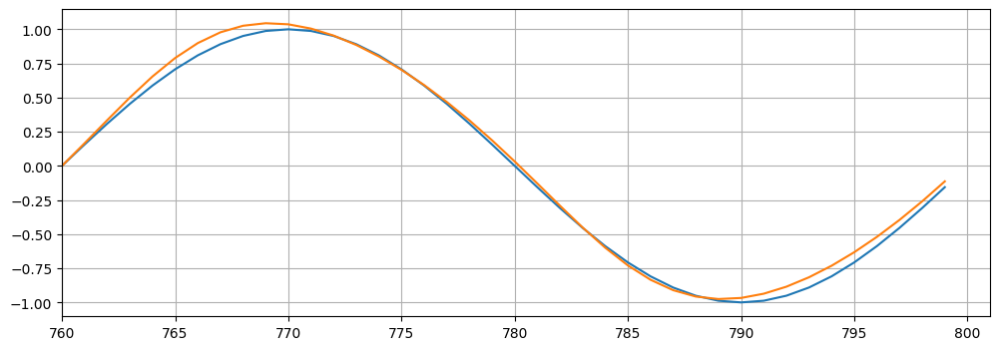

Epoch:  8 Loss: 0.00011518
Loss on test predictions: 0.002003107685595751


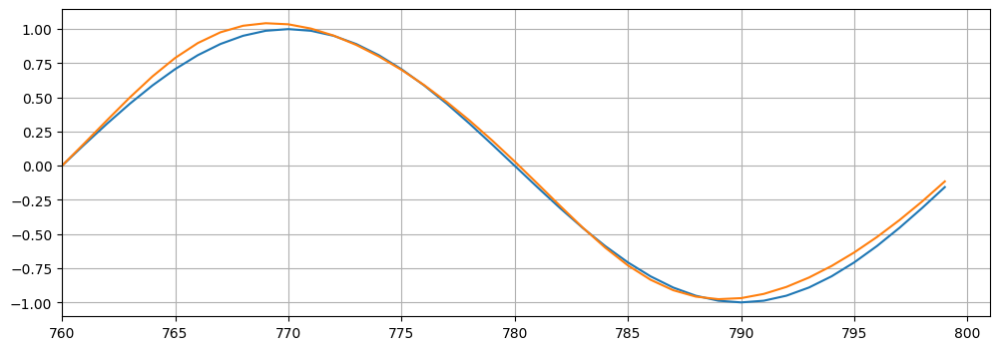

Epoch:  9 Loss: 0.00010724
Loss on test predictions: 0.0019349048379808664


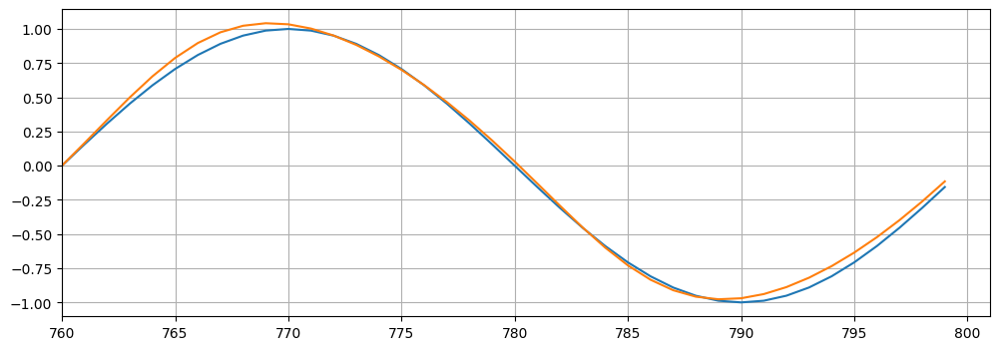

Epoch: 10 Loss: 0.00010036
Loss on test predictions: 0.0018750854069367051


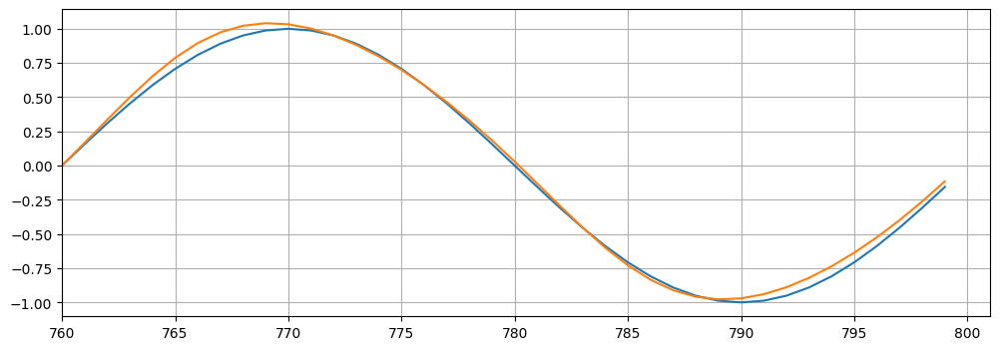

In [ ]:
model = LSTM()
criterion = nn.MSELoss()
optimizer = torch.optim.SGD(model.parameters(), lr=0.01)

epochs = 10
future = 40

for i in range(epochs):

    # tuple-unpack the train_data set
    for x_train, y_train in train_data:

        # reset the parameters and hidden states
        optimizer.zero_grad()
        y_pred = model(x_train)

        loss = criterion(y_pred, y_train)
        loss.backward()
        optimizer.step()

    # print training result
    print(f'Epoch: {i+1:2} Loss: {loss.item():10.8f}')

    # MAKE PREDICTIONS
    preds = train_set[-window_size:].tolist()

    for f in range(future):
        seq = torch.FloatTensor(preds[-window_size:])
        with torch.no_grad():
            preds.append(model(seq).item())

    loss = criterion(torch.tensor(preds[-window_size:]),y[760:])
    print(f'Loss on test predictions: {loss}')

    # Plot from point 700 to the end
    plt.figure(figsize=(12,4))
    plt.xlim(760,801)
    plt.grid(True)
    plt.plot(range(760,800), y.numpy()[-window_size:])
    plt.plot(range(760,800),preds[window_size:])
    plt.show()

#GRU

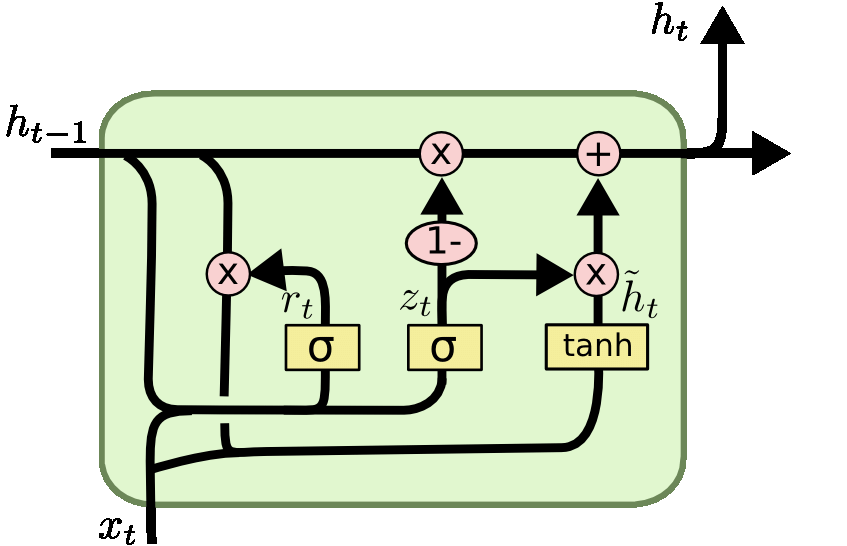

In [ ]:
class GRU(nn.Module):
    def __init__(self, input_size=1, hidden_size=50, out_size=1):
        super().__init__()
        #...
        self.hidden_size = hidden_size
        self.gru = nn.GRU(input_size, hidden_size, batch_first=True)
        self.linear = nn.Linear(hidden_size, out_size)

    def forward(self, seq):
        #...
        hidden = torch.zeros(1, 1, self.hidden_size)
        gru_out, hidden = self.gru(seq.view(1, len(seq), -1), hidden)
        pred = self.linear(gru_out.view(len(seq), -1))
        return pred[-1]

Epoch:  1 Loss: 0.05249288
Loss on test predictions: 0.5539453029632568


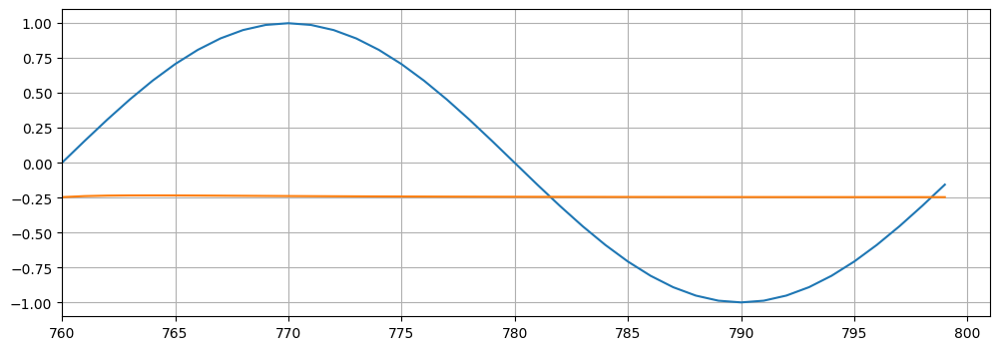

Epoch:  2 Loss: 0.02493490
Loss on test predictions: 0.4915260374546051


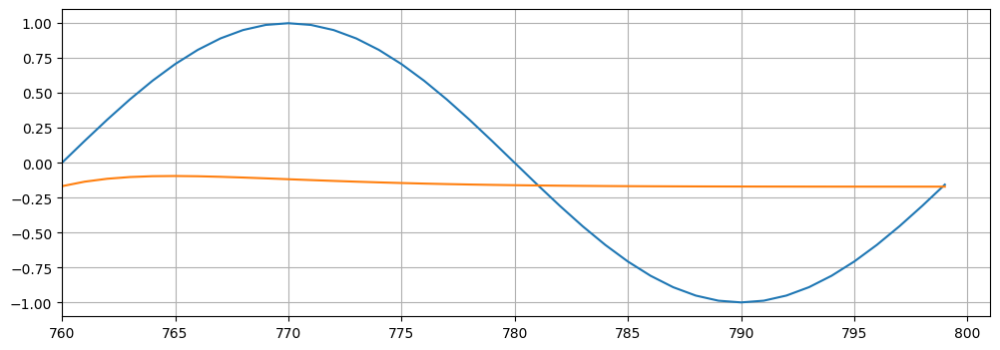

Epoch:  3 Loss: 0.00519211
Loss on test predictions: 0.3460477590560913


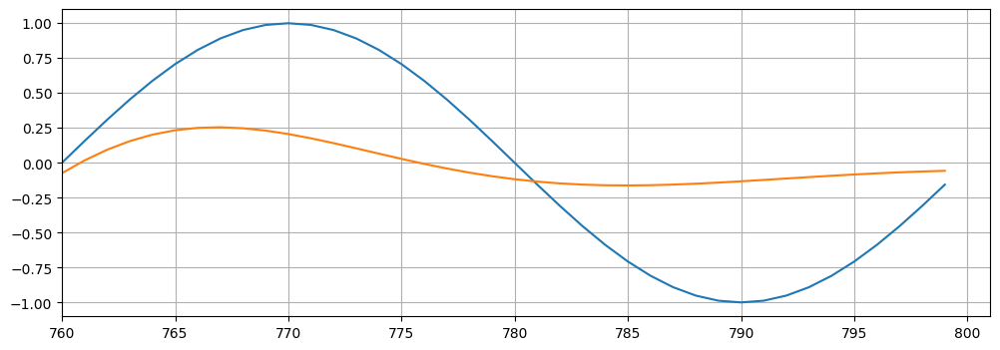

Epoch:  4 Loss: 0.00027020
Loss on test predictions: 0.08646555244922638


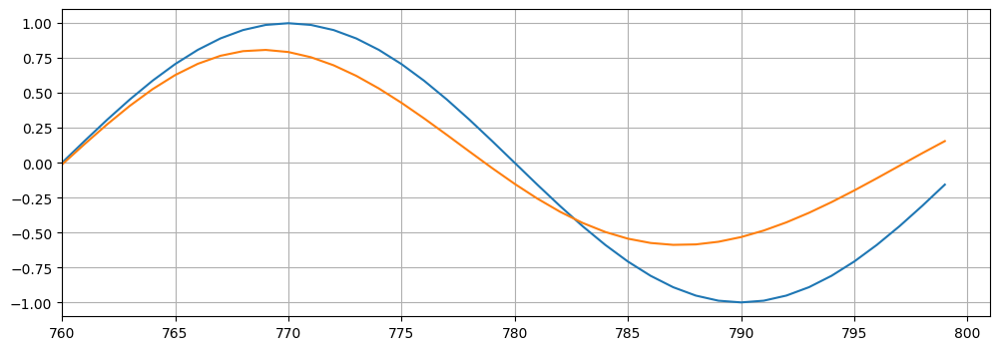

Epoch:  5 Loss: 0.00000336
Loss on test predictions: 0.010537529364228249


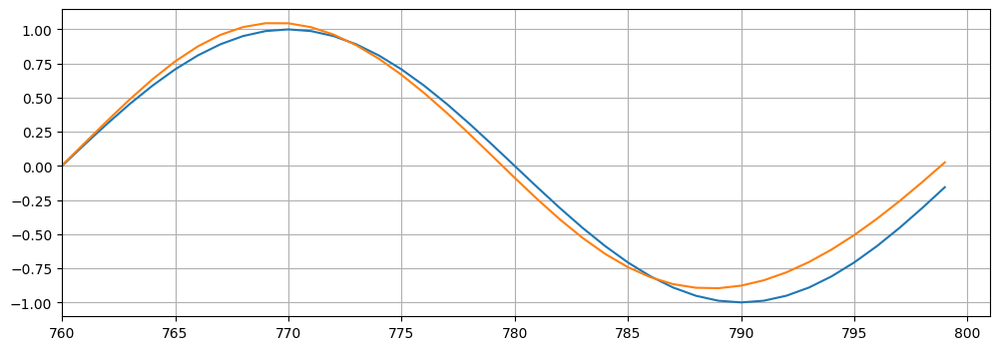

Epoch:  6 Loss: 0.00000023
Loss on test predictions: 0.005416054744273424


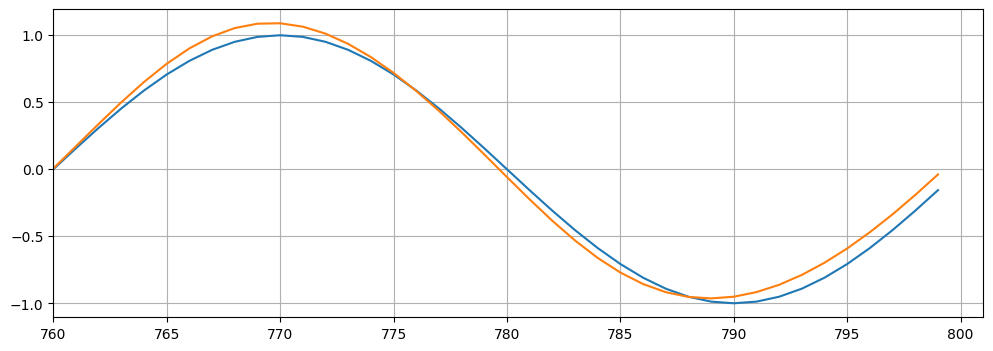

Epoch:  7 Loss: 0.00000044
Loss on test predictions: 0.004545813426375389


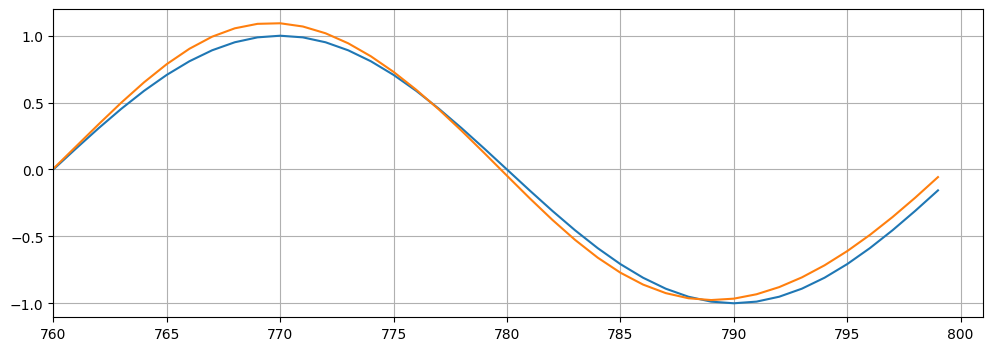

Epoch:  8 Loss: 0.00000028
Loss on test predictions: 0.004003485199064016


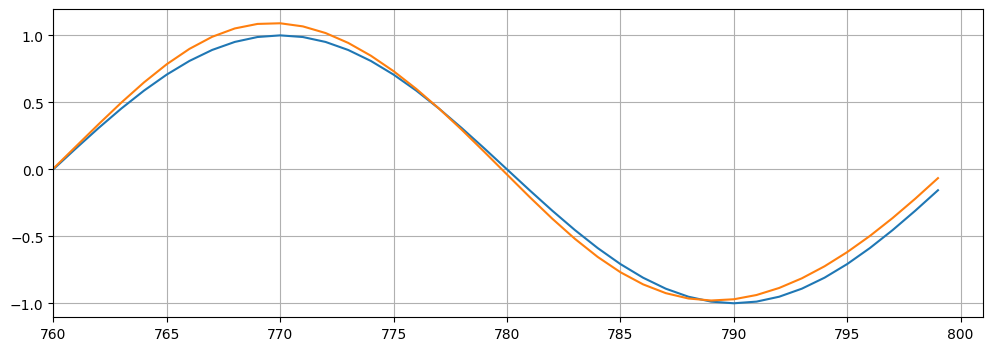

Epoch:  9 Loss: 0.00000013
Loss on test predictions: 0.0035603605210781097


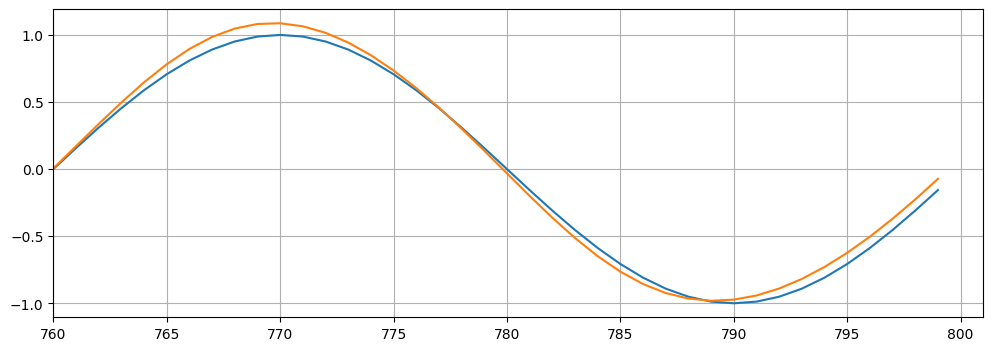

Epoch: 10 Loss: 0.00000004
Loss on test predictions: 0.0031841634772717953


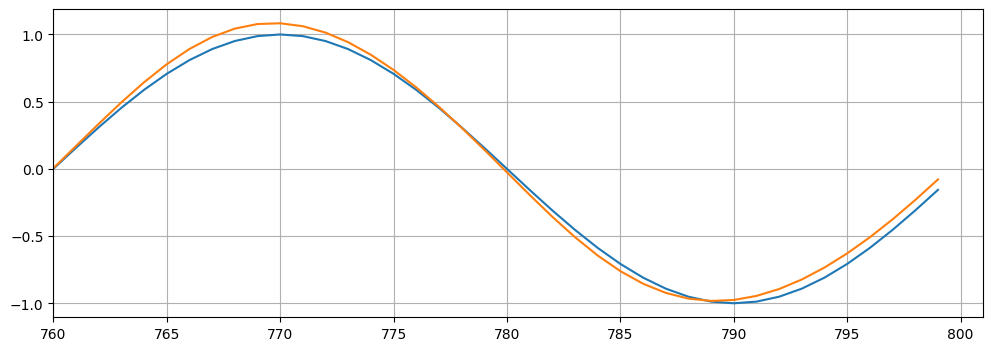

In [ ]:
model = GRU()
criterion = nn.MSELoss()
optimizer = torch.optim.SGD(model.parameters(), lr=0.01)

epochs = 10
future = 40

for i in range(epochs):

    # tuple-unpack the train_data set
    for x_train, y_train in train_data:

        # reset the parameters and hidden states
        optimizer.zero_grad()
        y_pred = model(x_train)

        loss = criterion(y_pred, y_train)
        loss.backward()
        optimizer.step()

    # print training result
    print(f'Epoch: {i+1:2} Loss: {loss.item():10.8f}')

    # MAKE PREDICTIONS
    preds = train_set[-window_size:].tolist()

    for f in range(future):
        seq = torch.FloatTensor(preds[-window_size:])
        with torch.no_grad():
            preds.append(model(seq).item())

    loss = criterion(torch.tensor(preds[-window_size:]),y[760:])
    print(f'Loss on test predictions: {loss}')

    # Plot from point 700 to the end
    plt.figure(figsize=(12,4))
    plt.xlim(760,801)
    plt.grid(True)
    plt.plot(range(760,800), y.numpy()[-window_size:])
    plt.plot(range(760,800),preds[window_size:])
    plt.show()

#[Workshop] Stock price prediction: LSTM vs GRU

##Data Preparation

In [ ]:
!gdown 1Ytf1couC1vtsPjvGNyo1XycGPM286Plh

Downloading...
From: https://drive.google.com/uc?id=1Ytf1couC1vtsPjvGNyo1XycGPM286Plh
To: /content/AOT.csv
100% 110k/110k [00:00<00:00, 40.8MB/s]


In [ ]:
import pandas as pd

data = pd.read_csv('AOT.csv', index_col='Date', parse_dates=True)
data

,Open,High,Low,Close,Adj Close,Volume
Date,,,,,,
2017-01-04,63.25,64.50,63.00,64.00,47.714363,14341900
2017-01-05,64.25,64.75,63.75,64.25,47.900749,12762900
2017-01-06,64.50,64.50,63.75,64.00,47.714363,8106700
2017-01-09,64.00,64.00,63.00,63.25,47.155212,10983300
2017-01-10,63.00,63.50,62.75,63.50,47.341595,8163200
...,...,...,...,...,...,...
2024-09-02,25.00,25.00,25.00,25.00,25.000000,0
2024-09-03,25.00,25.00,25.00,25.00,25.000000,0
2024-09-04,25.00,25.00,25.00,25.00,25.000000,0


In [ ]:
from sklearn.model_selection import train_test_split
from torch.utils.data import DataLoader, TensorDataset

from sklearn.preprocessing import MinMaxScaler

# Select relevant features (Open, High, Low, Close) as input and Volume as output
input_features = data[['Open', 'High', 'Low', 'Close']].values
output_features = data[['Volume']].values

# Set parameters for sequences
sequence_length = 40

# Create sequences for input and output
def create_sequences(input_data, output_data, seq_length):
    sequences = []
    targets = []

    for i in range(len(input_data) - seq_length):
        seq = input_data[i:i + seq_length]
        target = output_data[i + seq_length]  # Volume at the next time step
        sequences.append(seq)
        targets.append(target)

    return np.array(sequences), np.array(targets)

# Create sequences
X, y = create_sequences(input_features, output_features, sequence_length)

# Split the data into train and test sets (80% train, 20% test)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, shuffle=False)

#########
# Normalize the input features and output features using MinMaxScaler
scaler_input = MinMaxScaler()
scaler_output = MinMaxScaler()

# Fit the scaler only on the training data and transform both training and test data
X_train_reshaped = X_train.reshape(-1, X_train.shape[-1])  # Reshape for scaling
X_train_normalized = scaler_input.fit_transform(X_train_reshaped).reshape(X_train.shape)  # Scale and reshape back

X_test_reshaped = X_test.reshape(-1, X_test.shape[-1])  # Reshape for scaling
X_test_normalized = scaler_input.transform(X_test_reshaped).reshape(X_test.shape)  # Scale and reshape back

# Normalize the output features
y_train_normalized = scaler_output.fit_transform(y_train)  # Fit and transform training output
y_test_normalized = scaler_output.transform(y_test)  # Transform test output
#########

# Convert to PyTorch tensors
train_input_tensor = torch.tensor(X_train_normalized, dtype=torch.float32)
train_output_tensor = torch.tensor(y_train_normalized, dtype=torch.float32)
test_input_tensor = torch.tensor(X_test_normalized, dtype=torch.float32)
test_output_tensor = torch.tensor(y_test_normalized, dtype=torch.float32)

# Create Tensor datasets and DataLoaders
train_dataset = TensorDataset(train_input_tensor, train_output_tensor)
test_dataset = TensorDataset(test_input_tensor, test_output_tensor)

train_loader = DataLoader(train_dataset, batch_size=8, shuffle=True)  # Adjust batch size as needed
test_loader = DataLoader(test_dataset, batch_size=8, shuffle=False)     # For evaluation, no shuffle

# Display the shapes of the tensors
print("Train Input Tensor Shape:", train_input_tensor.shape)  # Should be (N_train, 40, 4)
print("Train Output Tensor Shape:", train_output_tensor.shape)  # Should be (N_train, 1)
print("Test Input Tensor Shape:", test_input_tensor.shape)  # Should be (N_test, 40, 4)
print("Test Output Tensor Shape:", test_output_tensor.shape)  # Should be (N_test, 1)

Train Input Tensor Shape: torch.Size([1460, 40, 4])
Train Output Tensor Shape: torch.Size([1460, 1])
Test Input Tensor Shape: torch.Size([365, 40, 4])
Test Output Tensor Shape: torch.Size([365, 1])


## Your work

In [ ]:
class LSTM(nn.Module):
    def __init__(self, input_size=4, hidden_size=50, num_layers=1, output_size=1):
        super().__init__()
        self.hidden_size = hidden_size
        self.num_layers = num_layers
        self.lstm = nn.LSTM(input_size, hidden_size, num_layers, batch_first=True)
        self.linear = nn.Linear(hidden_size, output_size)

    def forward(self, seq):
        h_0 = torch.zeros(self.num_layers, seq.size(0), self.hidden_size).to(seq.device)
        c_0 = torch.zeros(self.num_layers, seq.size(0), self.hidden_size).to(seq.device)
        lstm_out, _ = self.lstm(seq, (h_0, c_0))
        # lstm_out, (hn, cn) = self.lstm(seq, (h_0, c_0))
        # pred = self.linear(hn[-1])
        pred = self.linear(lstm_out[:, -1, :])
        return pred


class GRU(nn.Module):
    def __init__(self, input_size=4, hidden_size=50, num_layers=1, output_size=1):
        super().__init__()
        self.hidden_size = hidden_size
        self.num_layers = num_layers
        self.gru = nn.GRU(input_size, hidden_size, num_layers, batch_first=True)
        self.linear = nn.Linear(hidden_size, output_size)

    def forward(self, seq):
        h_0 = torch.zeros(self.num_layers, seq.size(0), self.hidden_size).to(seq.device)
        gru_out, _ = self.gru(seq, h_0)
        pred = self.linear(gru_out[:, -1, :])
        return pred

Epoch:  1 LSTM Loss: 0.01273049 GRU Loss: 0.01241170


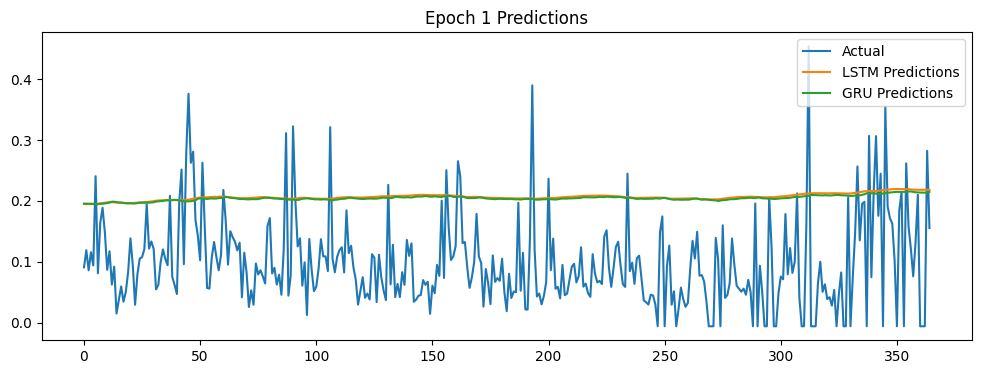

Epoch:  2 LSTM Loss: 0.01210983 GRU Loss: 0.01216055


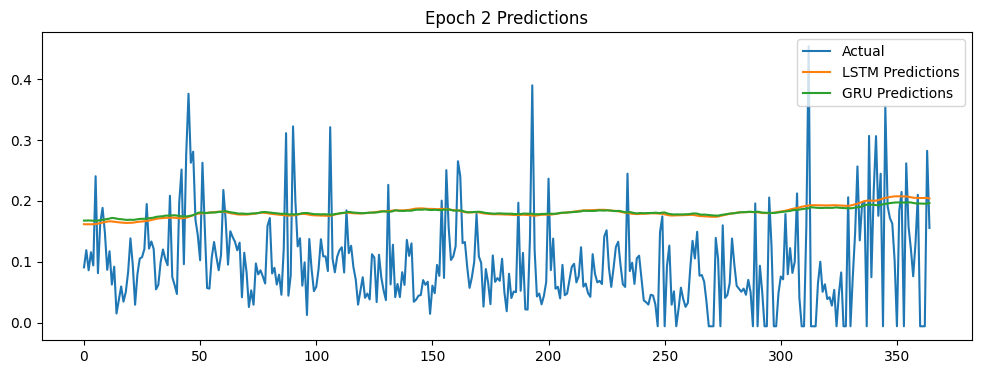

Epoch:  3 LSTM Loss: 0.01188074 GRU Loss: 0.01213955


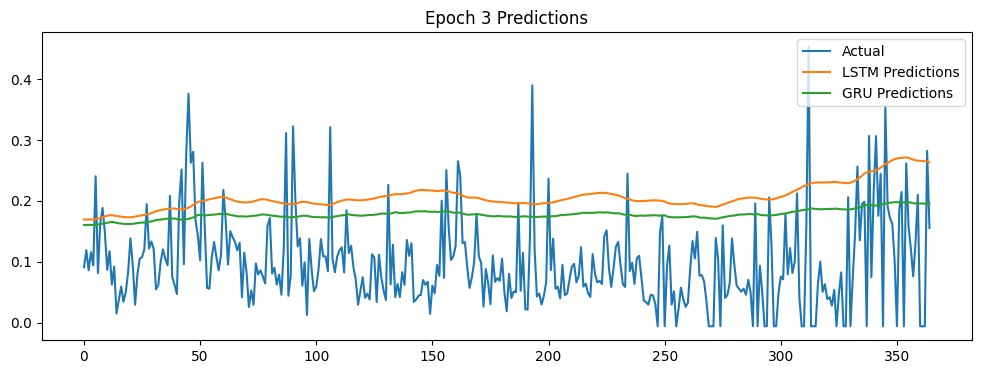

Epoch:  4 LSTM Loss: 0.01345340 GRU Loss: 0.01202197


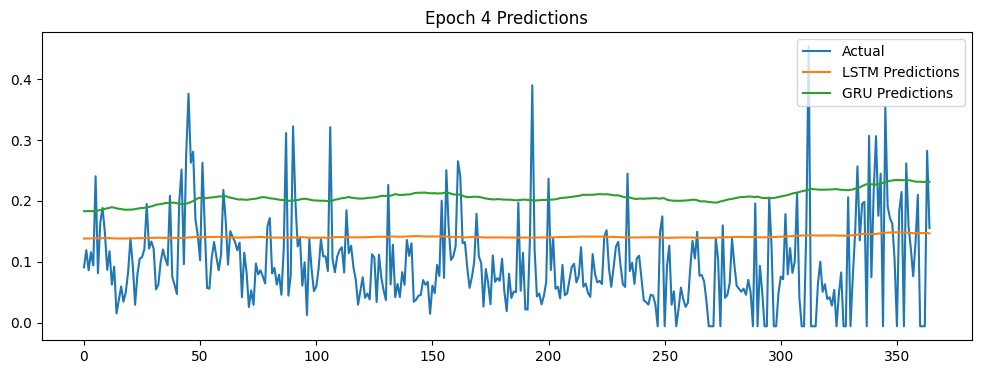

Epoch:  5 LSTM Loss: 0.01203498 GRU Loss: 0.01212499


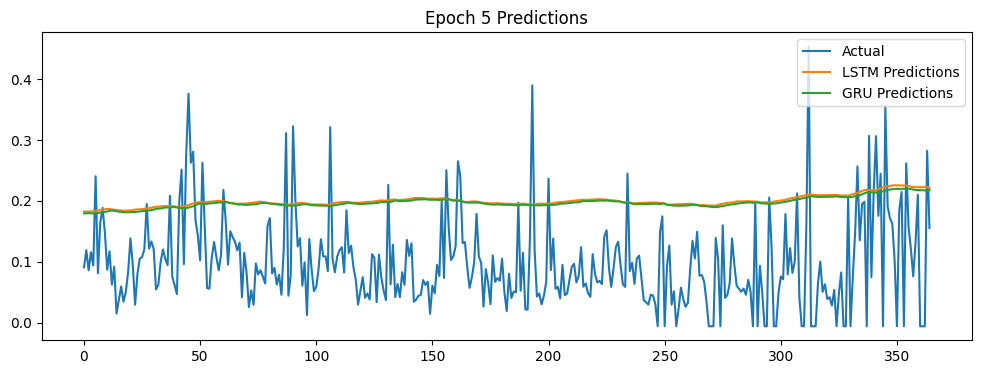

Epoch:  6 LSTM Loss: 0.01178862 GRU Loss: 0.01183748


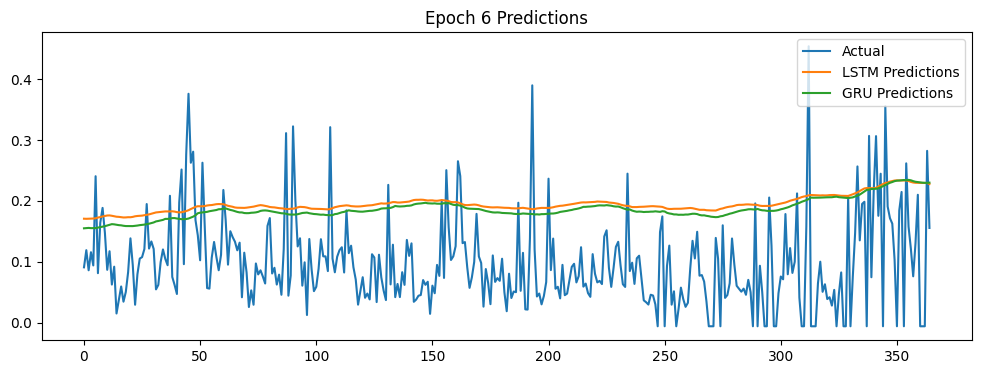

Epoch:  7 LSTM Loss: 0.01177725 GRU Loss: 0.01178578


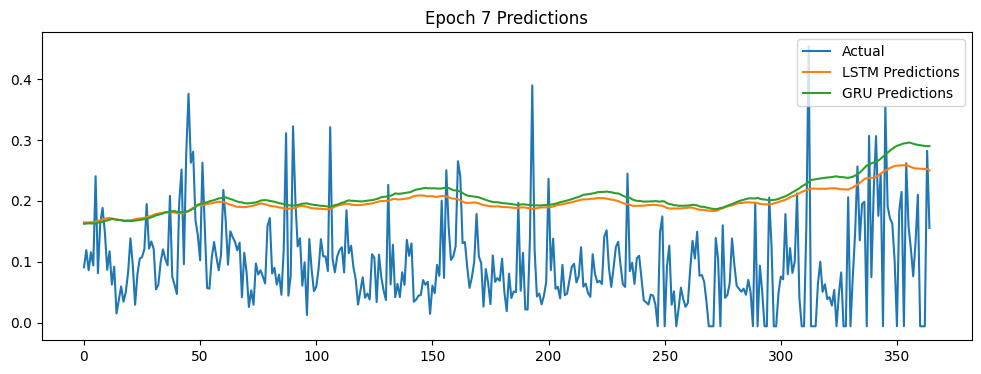

Epoch:  8 LSTM Loss: 0.01163676 GRU Loss: 0.01171389


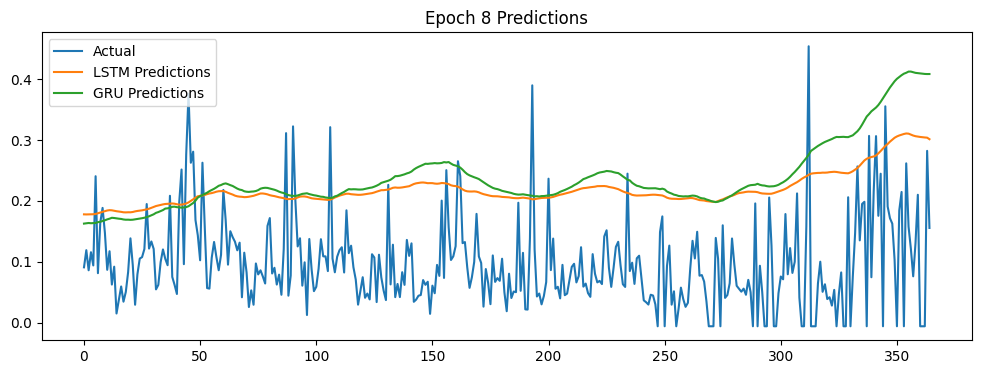

Epoch:  9 LSTM Loss: 0.01180917 GRU Loss: 0.01180081


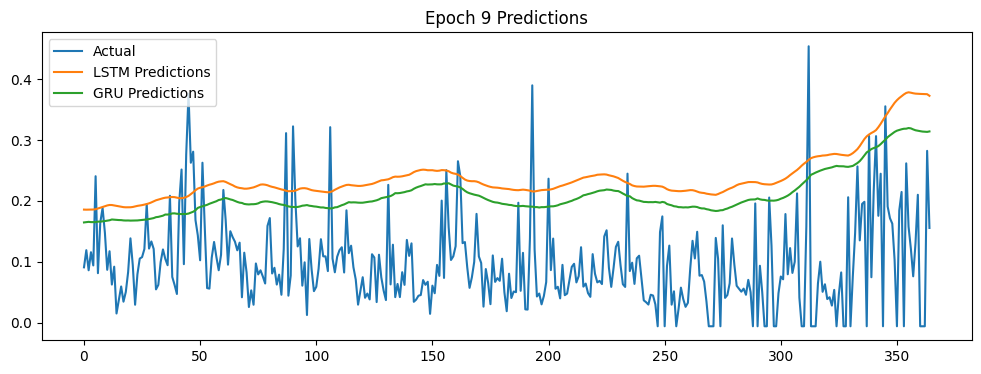

Epoch: 10 LSTM Loss: 0.01146587 GRU Loss: 0.01146569


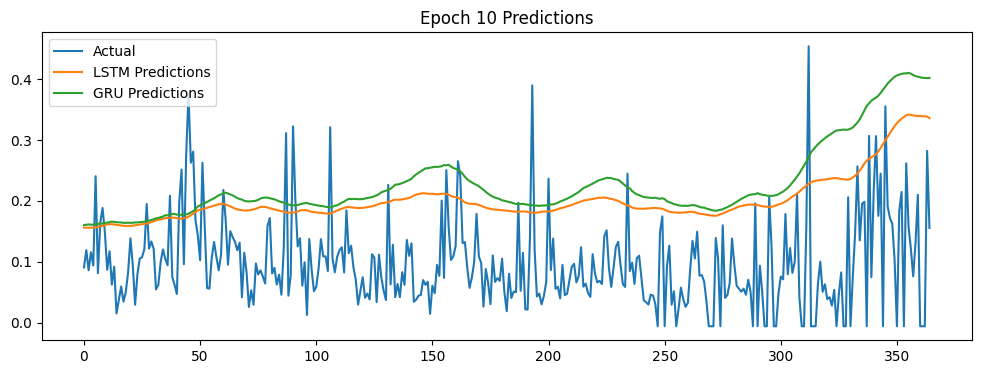

Epoch: 11 LSTM Loss: 0.01163842 GRU Loss: 0.01143382


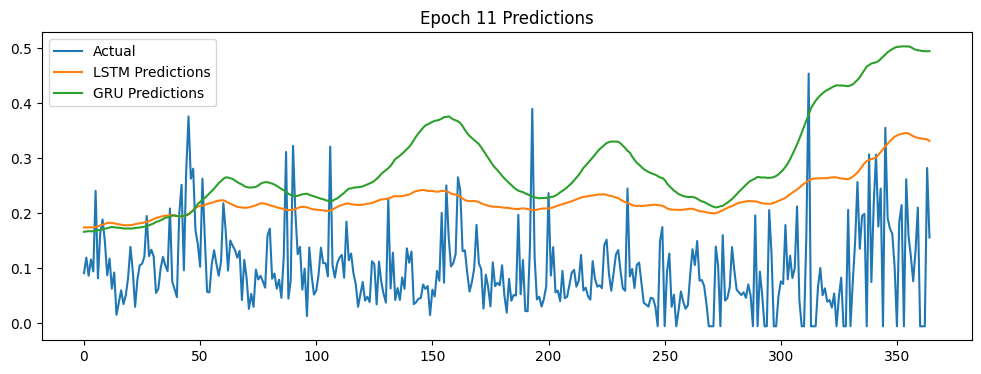

Epoch: 12 LSTM Loss: 0.01143050 GRU Loss: 0.01140269


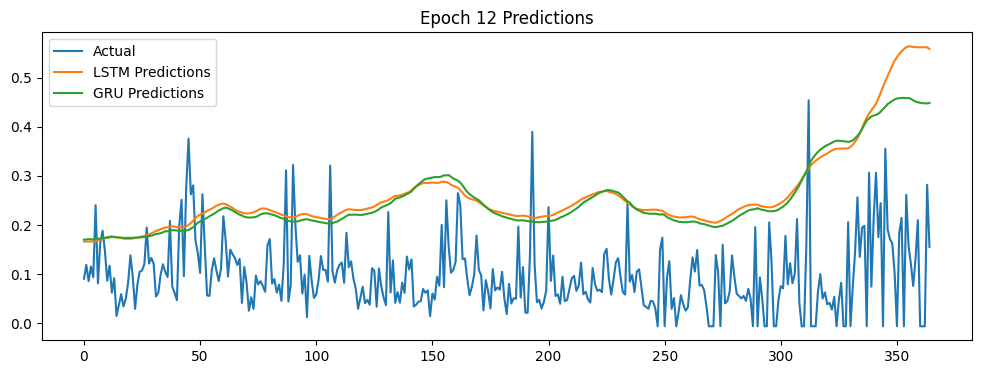

Epoch: 13 LSTM Loss: 0.01137010 GRU Loss: 0.01134382


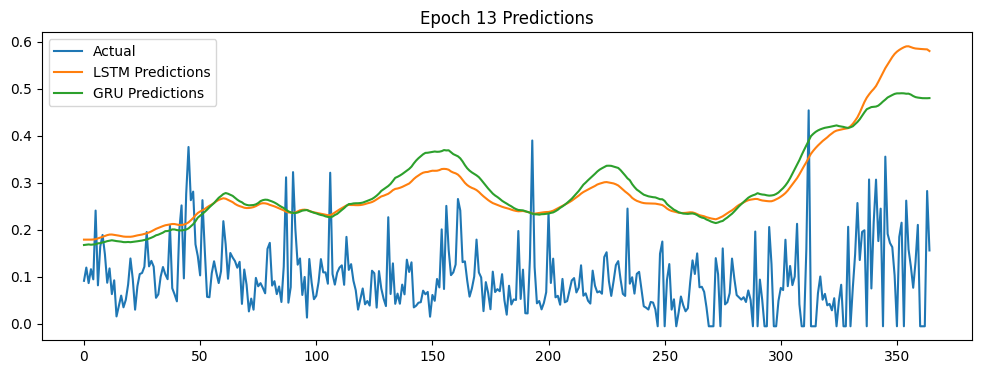

Epoch: 14 LSTM Loss: 0.01141700 GRU Loss: 0.01146100


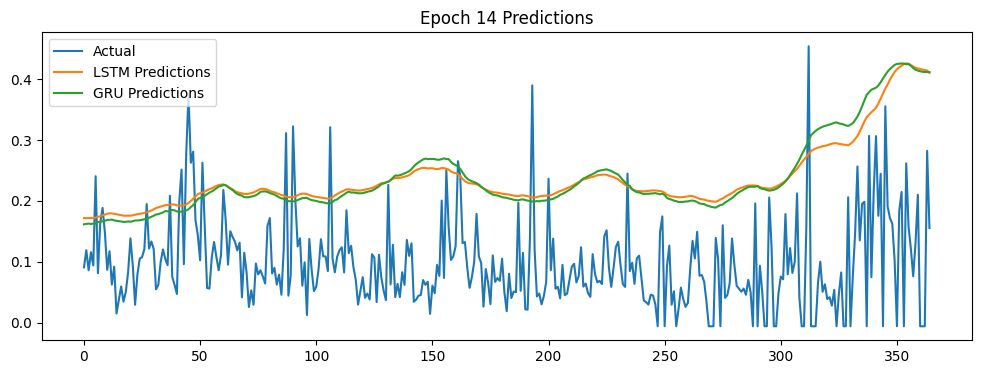

Epoch: 15 LSTM Loss: 0.01132068 GRU Loss: 0.01134533


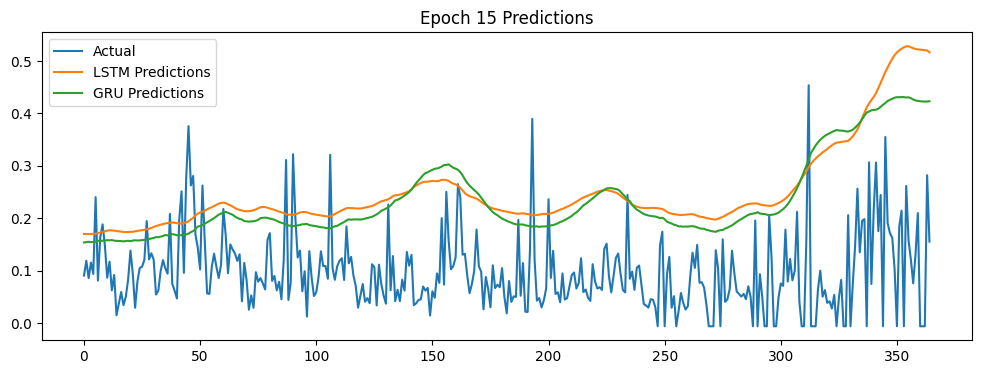

Epoch: 16 LSTM Loss: 0.01128062 GRU Loss: 0.01144979


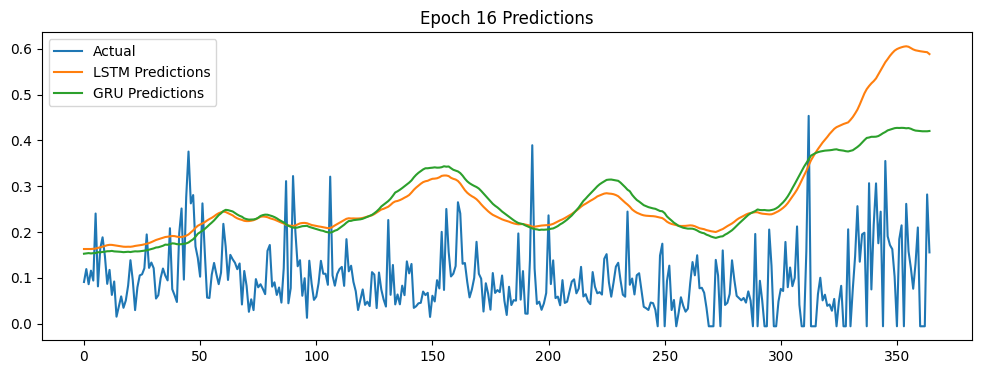

Epoch: 17 LSTM Loss: 0.01127131 GRU Loss: 0.01117291


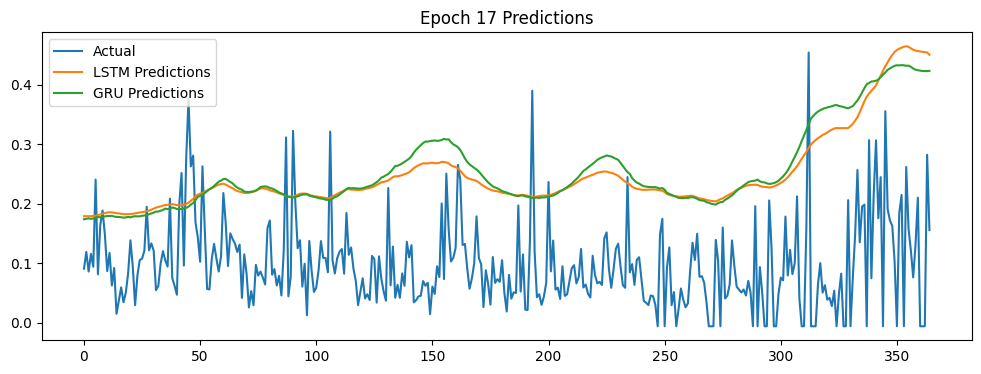

Epoch: 18 LSTM Loss: 0.01134048 GRU Loss: 0.01135114


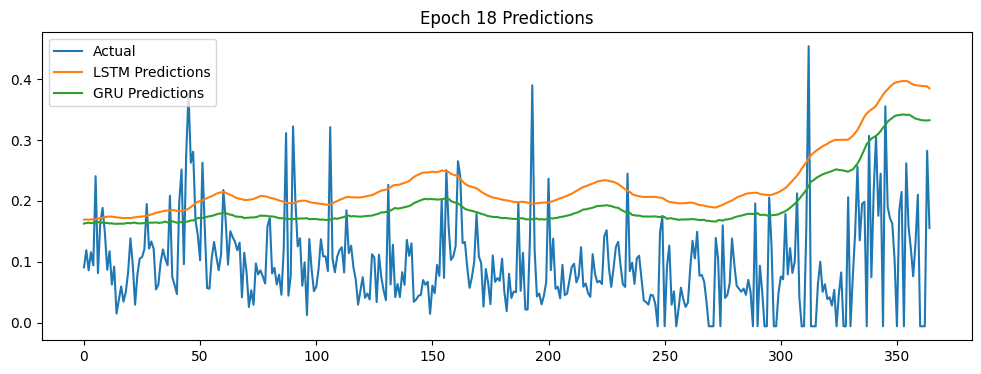

Epoch: 19 LSTM Loss: 0.01120330 GRU Loss: 0.01135198


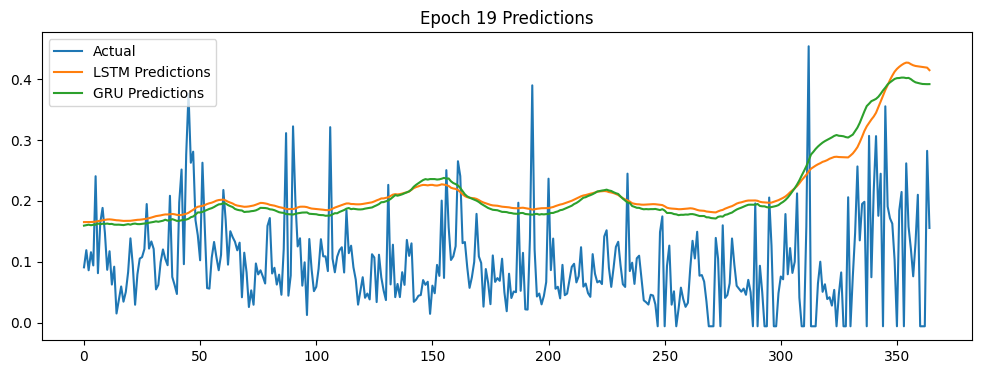

Epoch: 20 LSTM Loss: 0.01131754 GRU Loss: 0.01123453


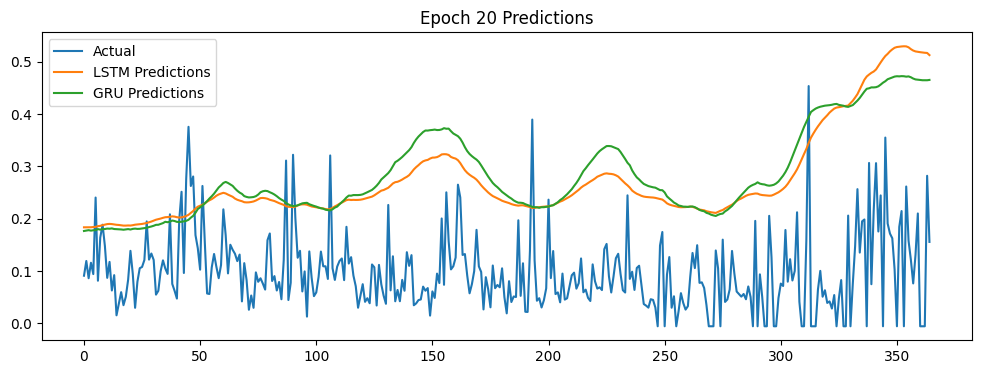

Epoch: 21 LSTM Loss: 0.01120634 GRU Loss: 0.01118531


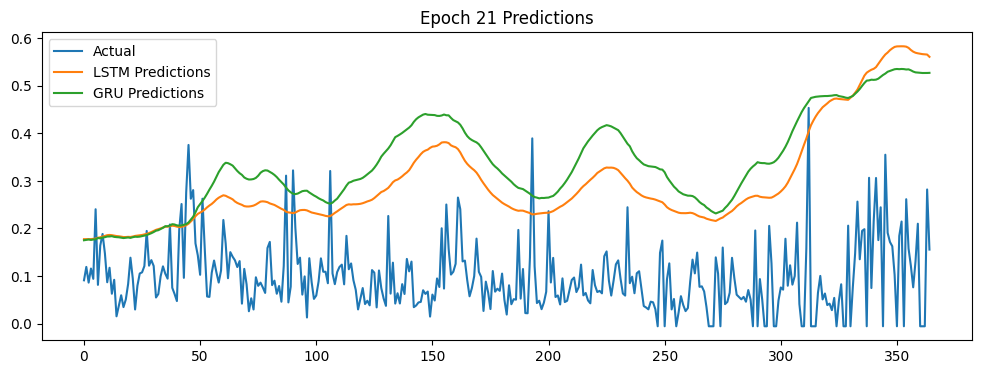

Epoch: 22 LSTM Loss: 0.01125071 GRU Loss: 0.01119466


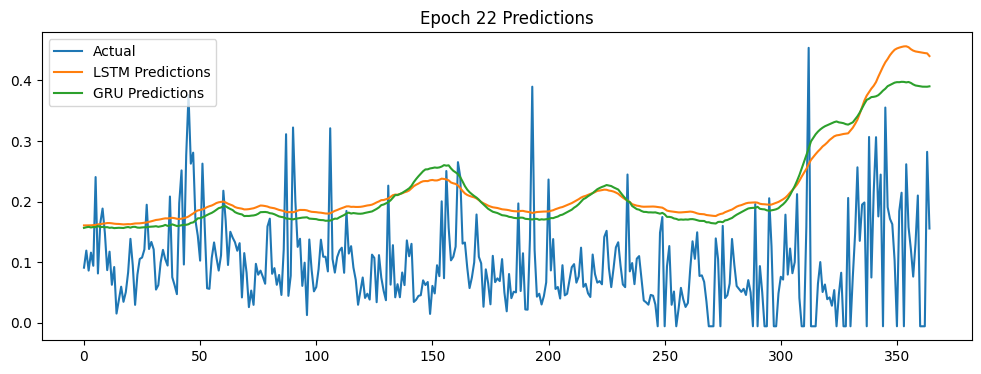

Epoch: 23 LSTM Loss: 0.01117338 GRU Loss: 0.01113616


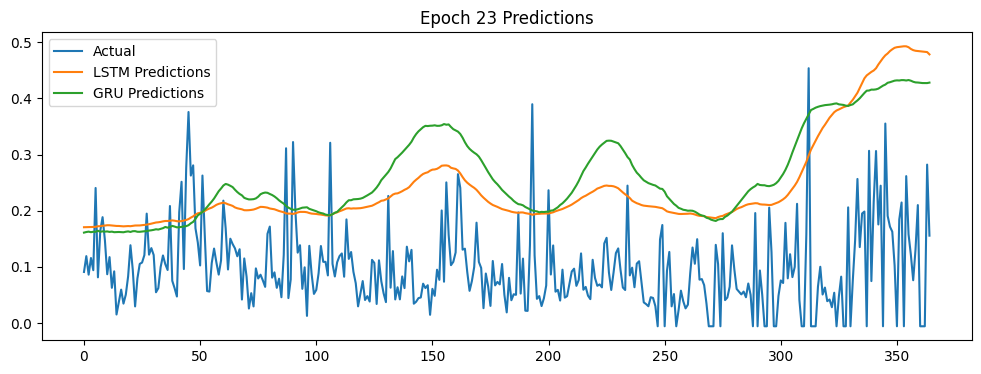

Epoch: 24 LSTM Loss: 0.01120014 GRU Loss: 0.01119613


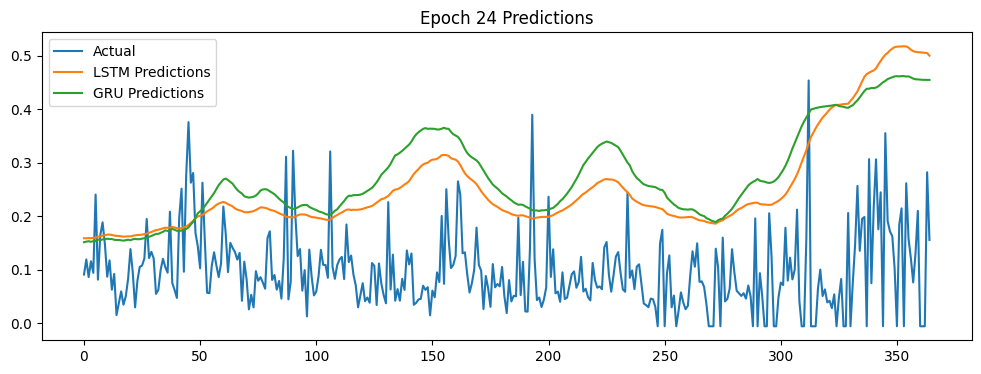

Epoch: 25 LSTM Loss: 0.01124407 GRU Loss: 0.01117856


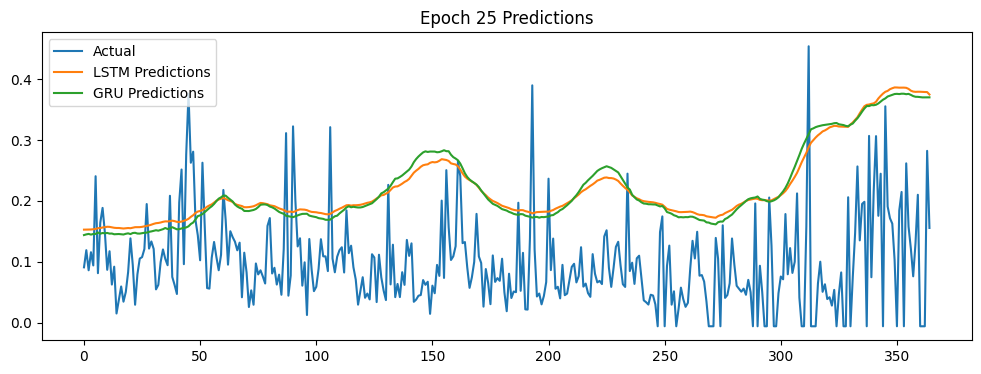

Epoch: 26 LSTM Loss: 0.01131973 GRU Loss: 0.01117044


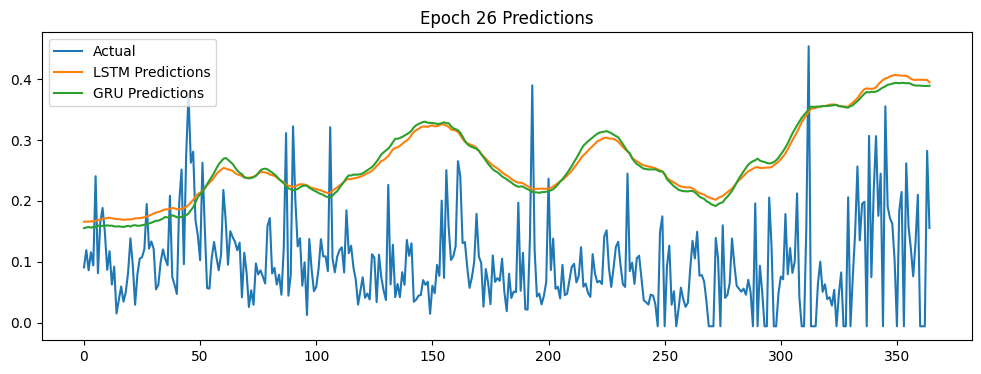

Epoch: 27 LSTM Loss: 0.01106184 GRU Loss: 0.01088703


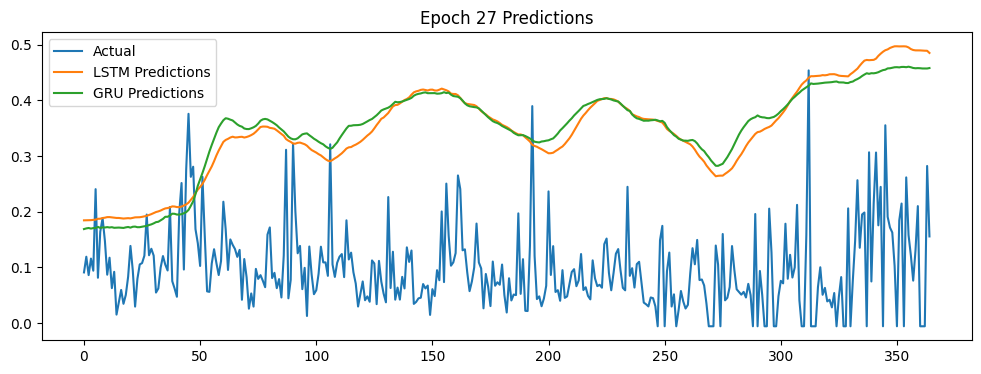

Epoch: 28 LSTM Loss: 0.01120095 GRU Loss: 0.01107759


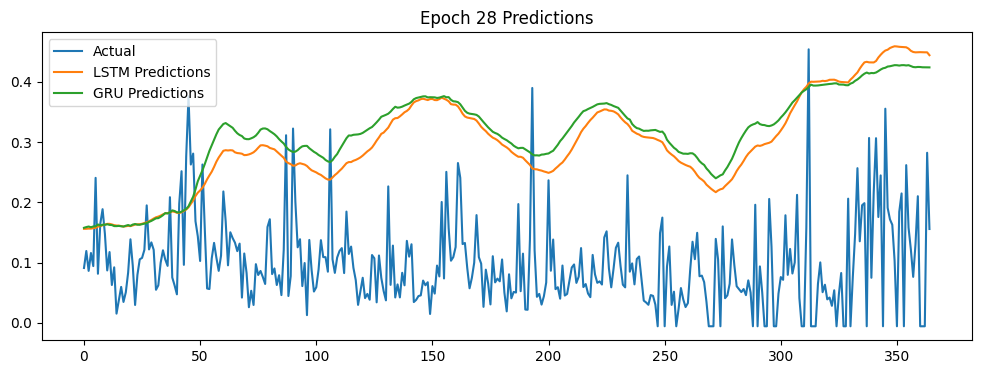

Epoch: 29 LSTM Loss: 0.01141645 GRU Loss: 0.01118913


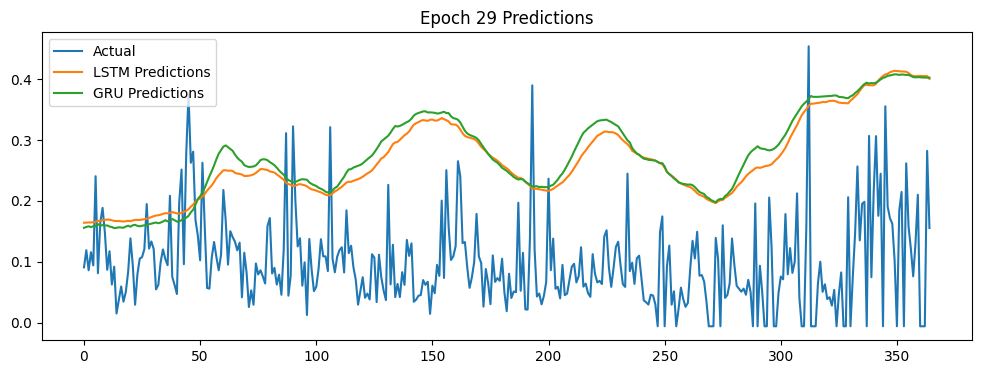

Epoch: 30 LSTM Loss: 0.01115519 GRU Loss: 0.01086219


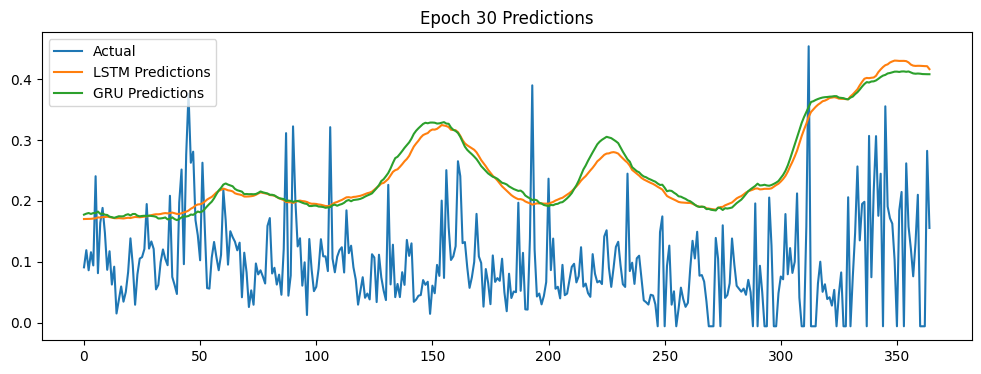

Epoch: 31 LSTM Loss: 0.01113376 GRU Loss: 0.01084563


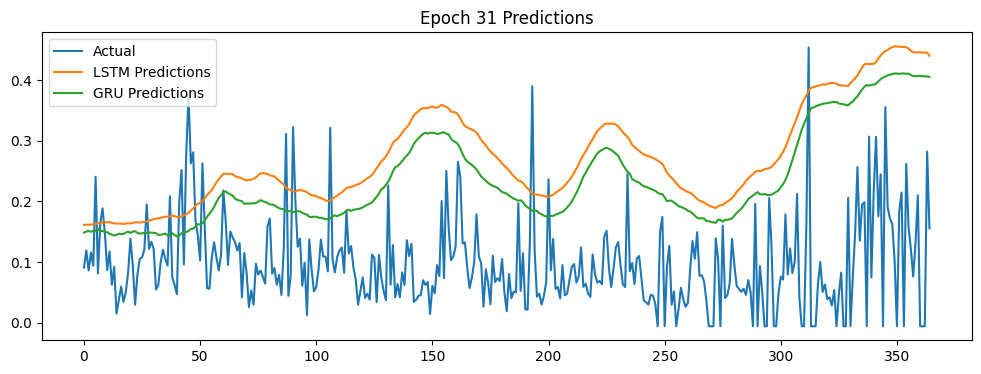

Epoch: 32 LSTM Loss: 0.01119092 GRU Loss: 0.01093750


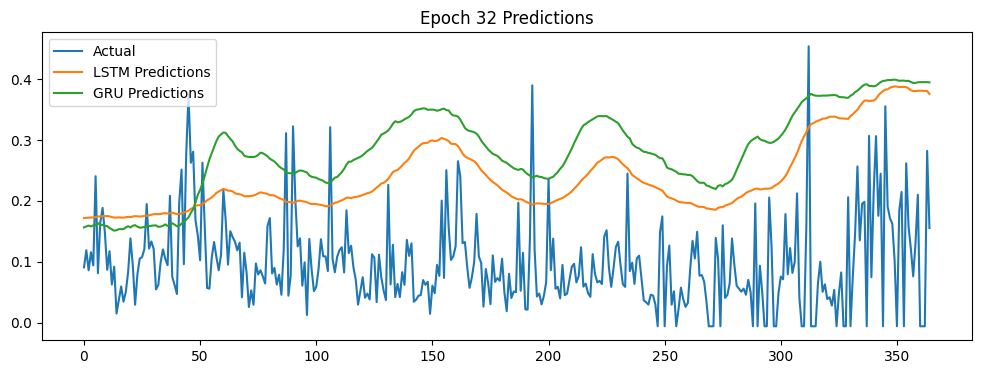

Epoch: 33 LSTM Loss: 0.01105885 GRU Loss: 0.01063817


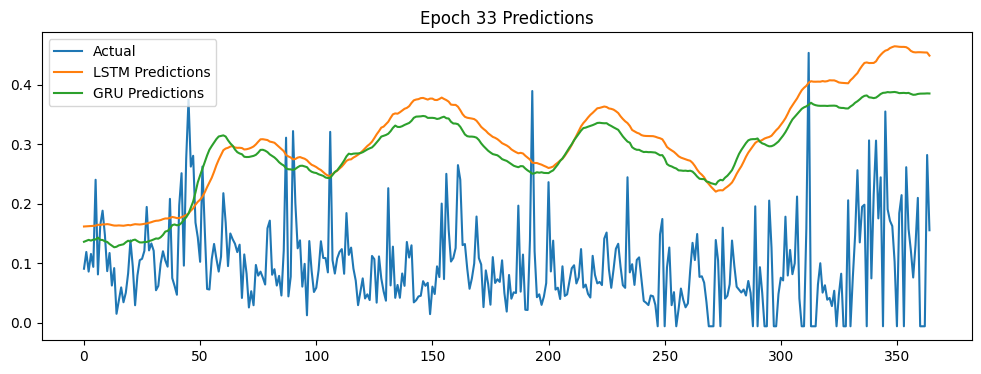

Epoch: 34 LSTM Loss: 0.01118299 GRU Loss: 0.01068108


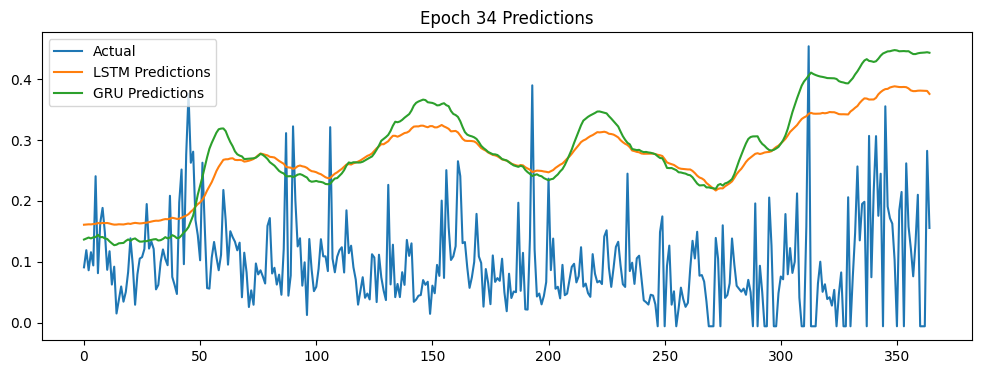

Epoch: 35 LSTM Loss: 0.01124619 GRU Loss: 0.01055918


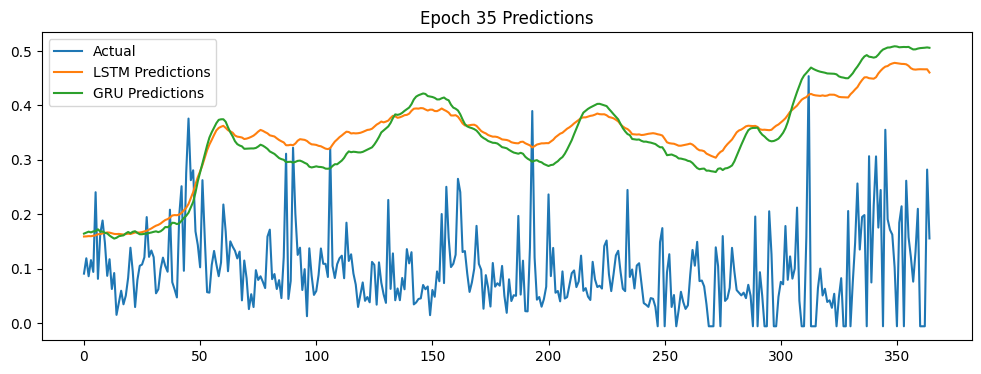

Epoch: 36 LSTM Loss: 0.01115414 GRU Loss: 0.01045824


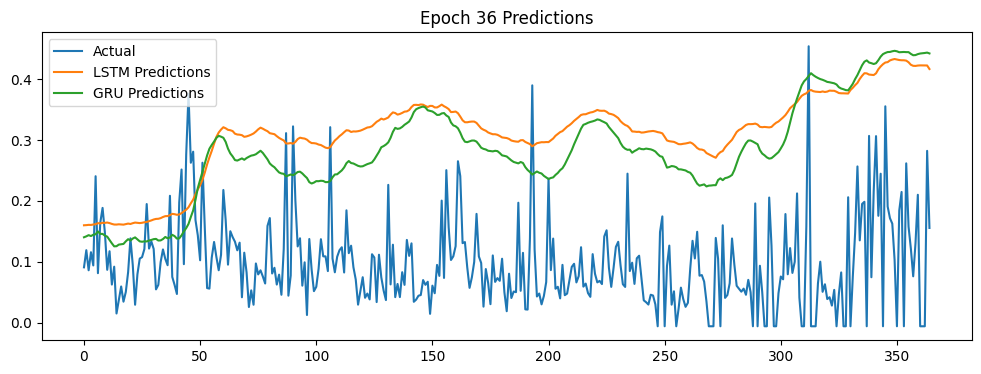

Epoch: 37 LSTM Loss: 0.01102164 GRU Loss: 0.01041918


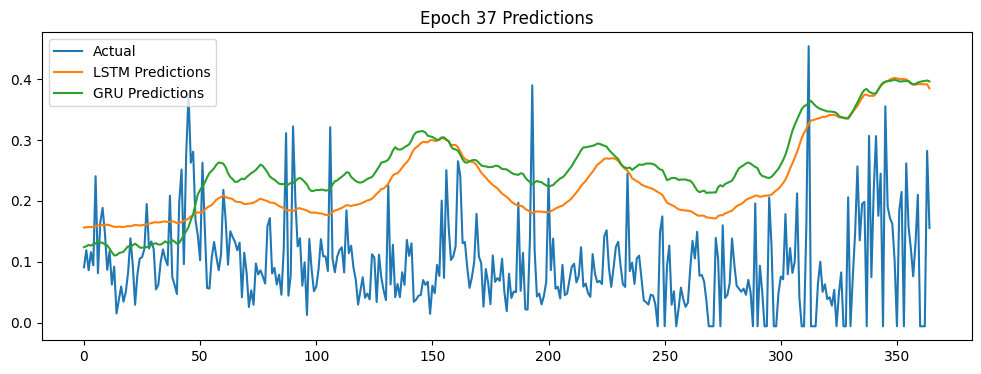

Epoch: 38 LSTM Loss: 0.01108801 GRU Loss: 0.01025245


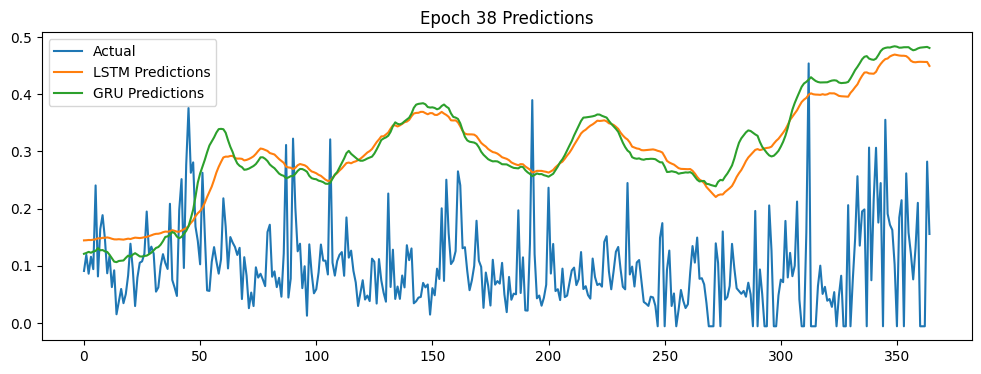

Epoch: 39 LSTM Loss: 0.01099871 GRU Loss: 0.01028092


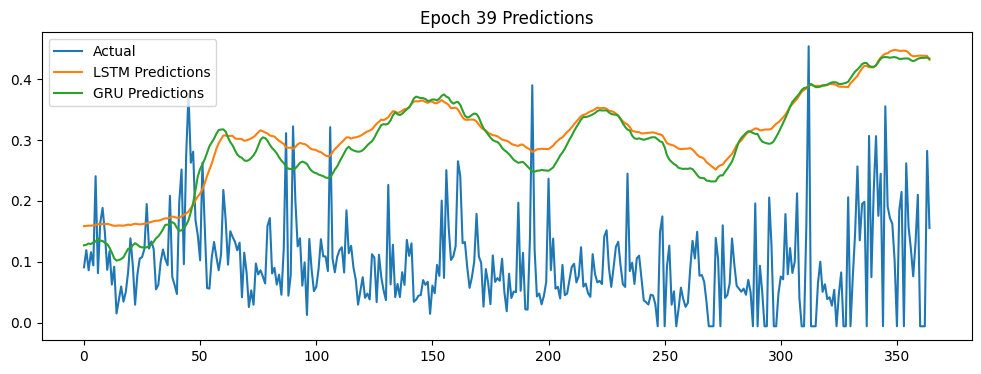

Epoch: 40 LSTM Loss: 0.01101025 GRU Loss: 0.01005041


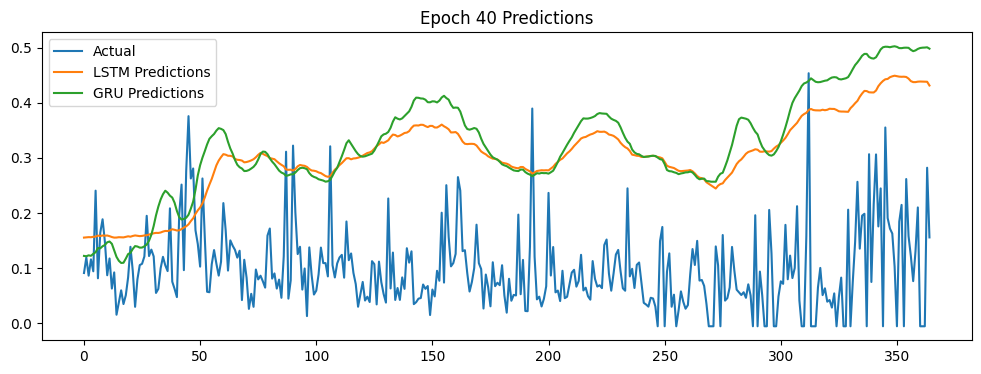

Epoch: 41 LSTM Loss: 0.01101079 GRU Loss: 0.01008069


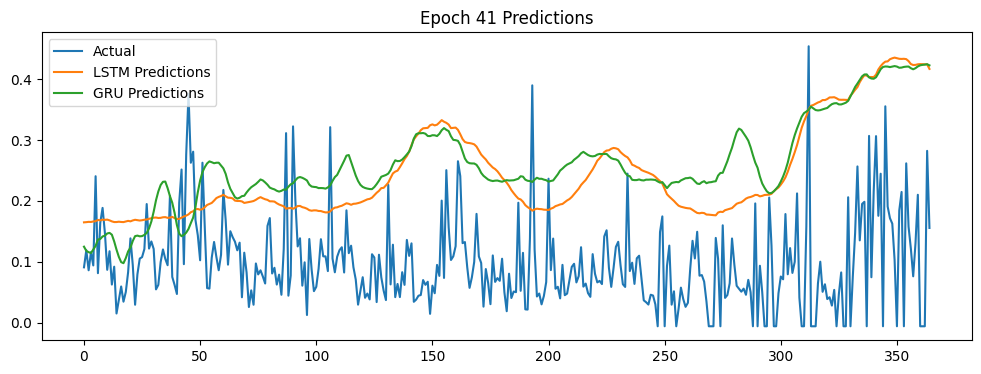

Epoch: 42 LSTM Loss: 0.01098512 GRU Loss: 0.00988584


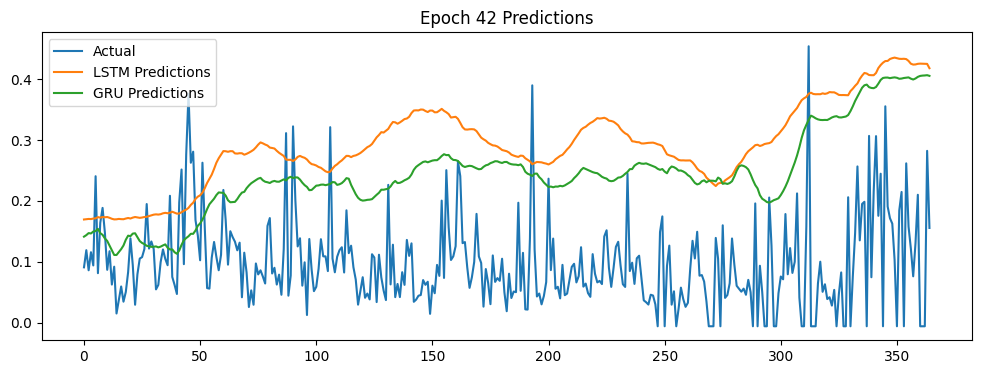

Epoch: 43 LSTM Loss: 0.01101594 GRU Loss: 0.00986322


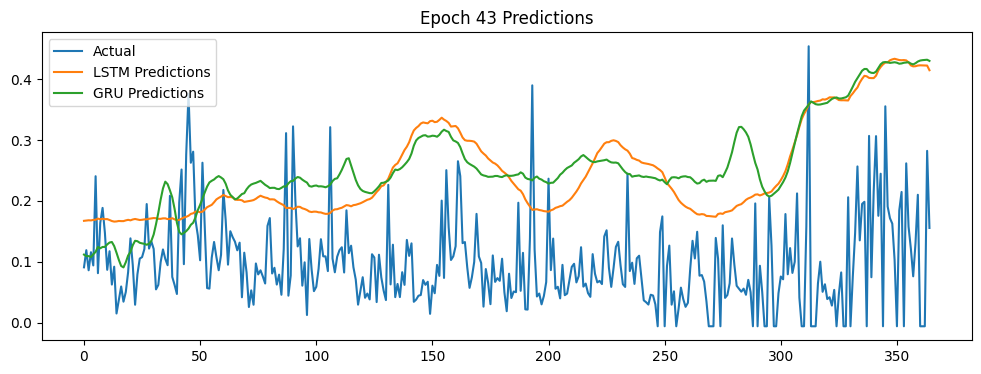

Epoch: 44 LSTM Loss: 0.01097746 GRU Loss: 0.00989494


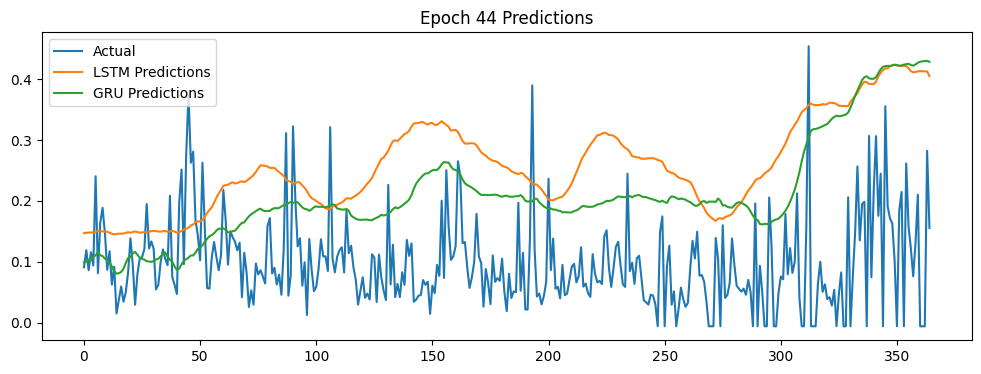

Epoch: 45 LSTM Loss: 0.01102083 GRU Loss: 0.00966794


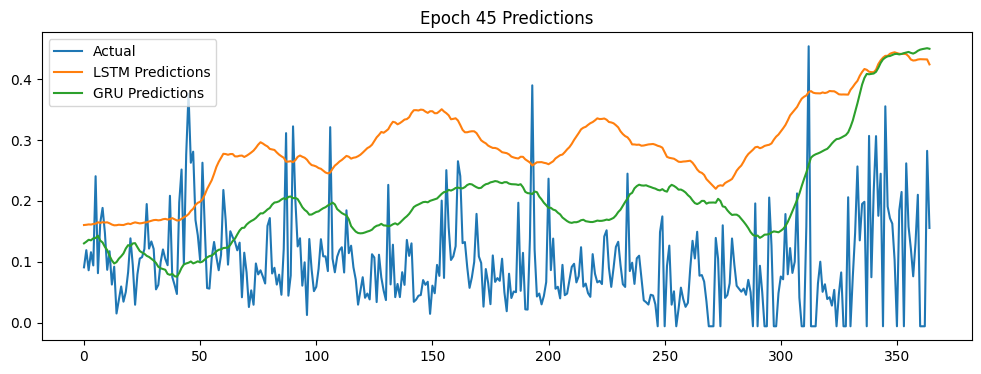

Epoch: 46 LSTM Loss: 0.01090268 GRU Loss: 0.00985360


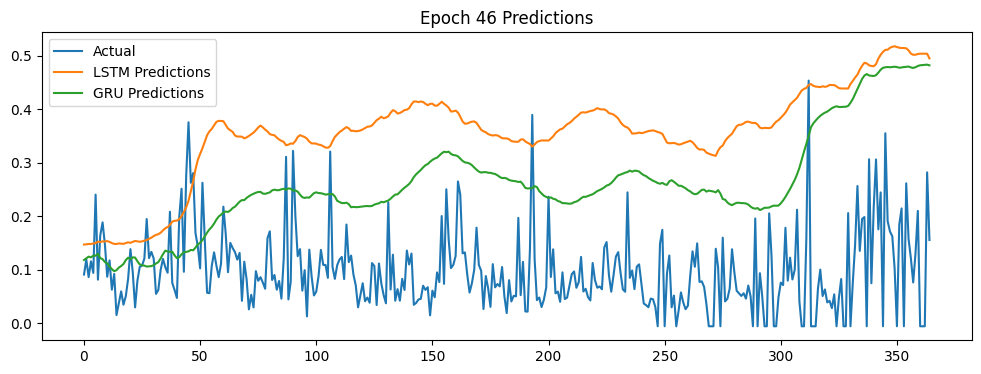

Epoch: 47 LSTM Loss: 0.01100358 GRU Loss: 0.00963428


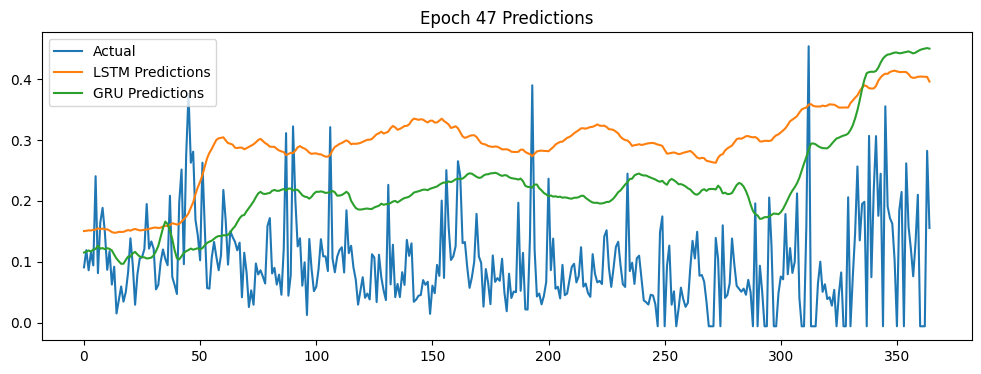

Epoch: 48 LSTM Loss: 0.01095150 GRU Loss: 0.00976328


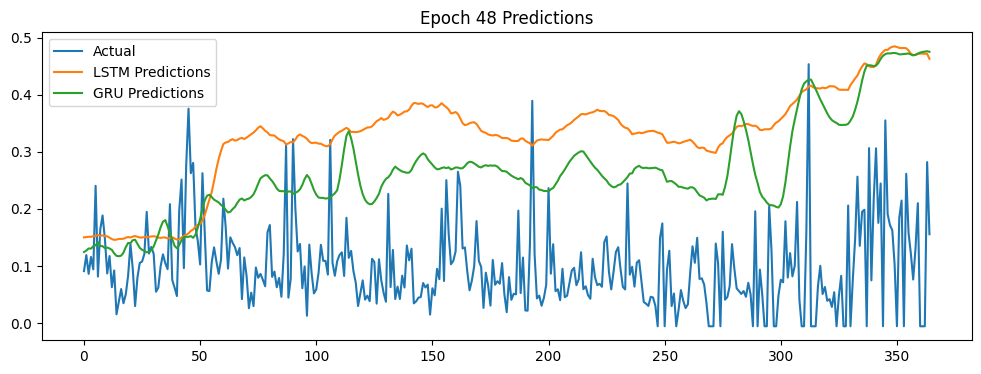

Epoch: 49 LSTM Loss: 0.01098762 GRU Loss: 0.00993133


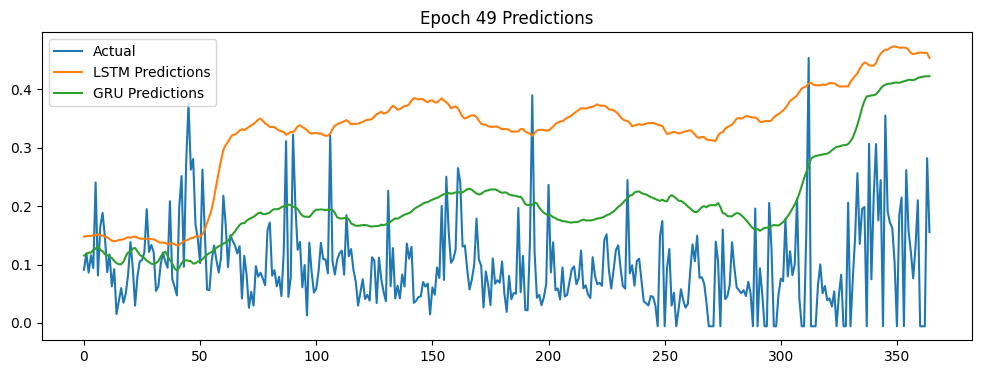

Epoch: 50 LSTM Loss: 0.01089924 GRU Loss: 0.00952798


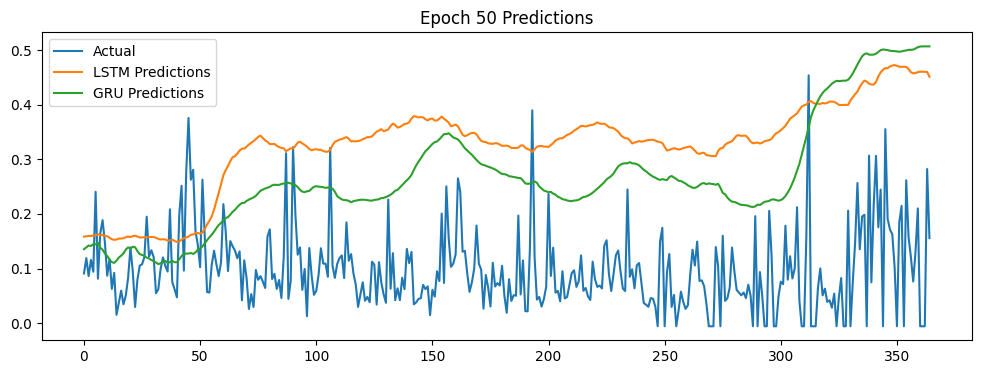

Epoch: 51 LSTM Loss: 0.01077213 GRU Loss: 0.00958094


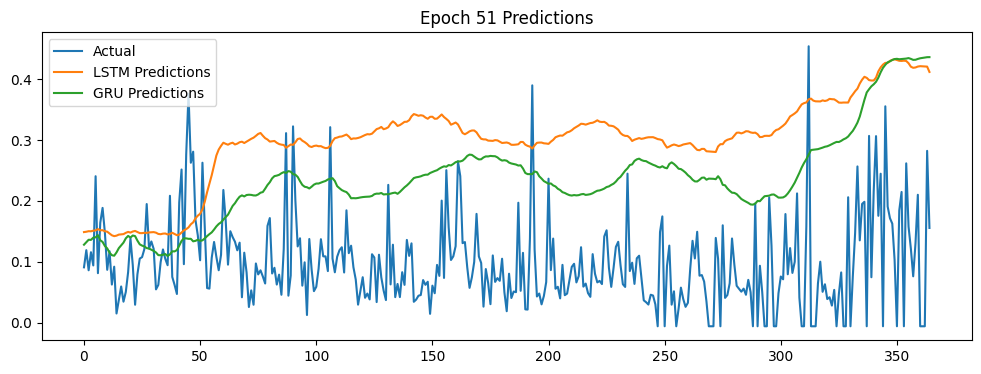

Epoch: 52 LSTM Loss: 0.01077534 GRU Loss: 0.00967034


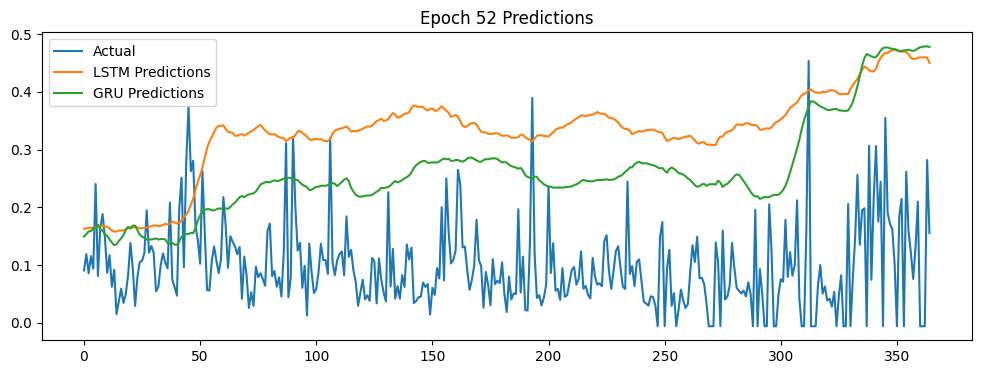

Epoch: 53 LSTM Loss: 0.01067304 GRU Loss: 0.00951826


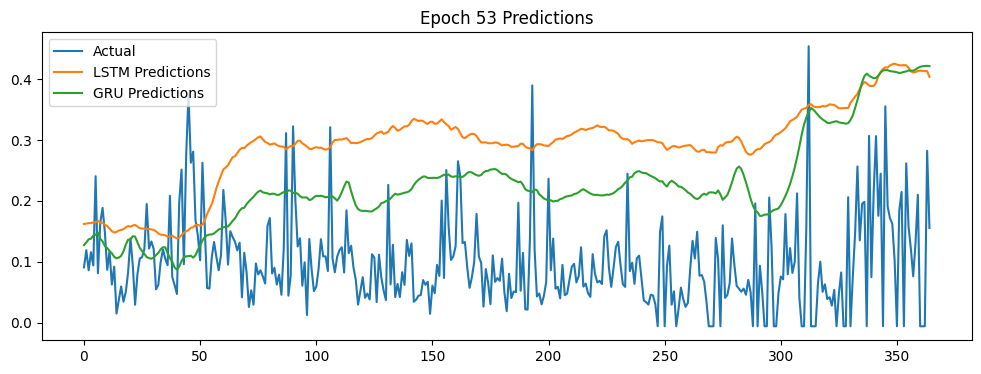

Epoch: 54 LSTM Loss: 0.01068637 GRU Loss: 0.00941098


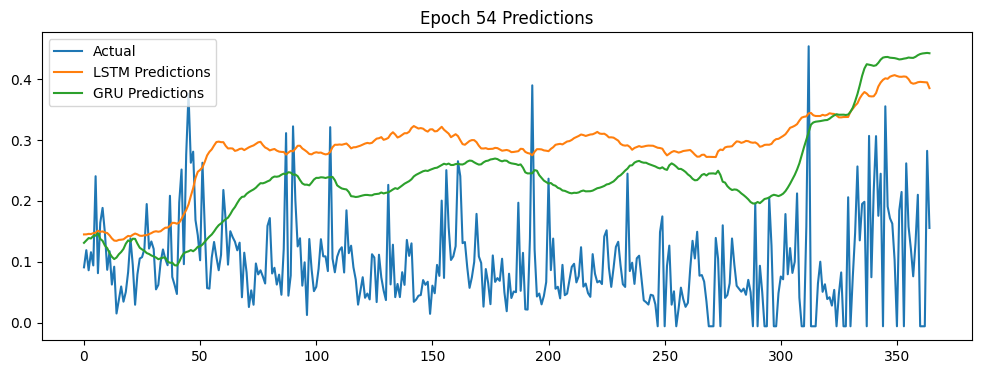

Epoch: 55 LSTM Loss: 0.01079755 GRU Loss: 0.00967000


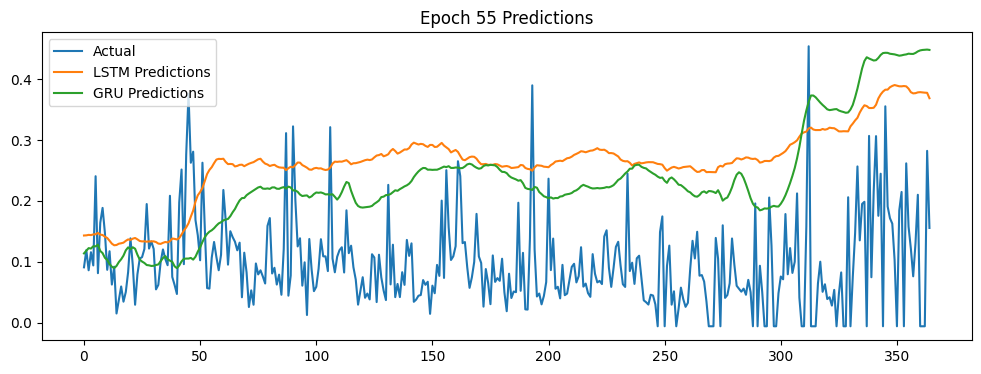

Epoch: 56 LSTM Loss: 0.01078935 GRU Loss: 0.00964115


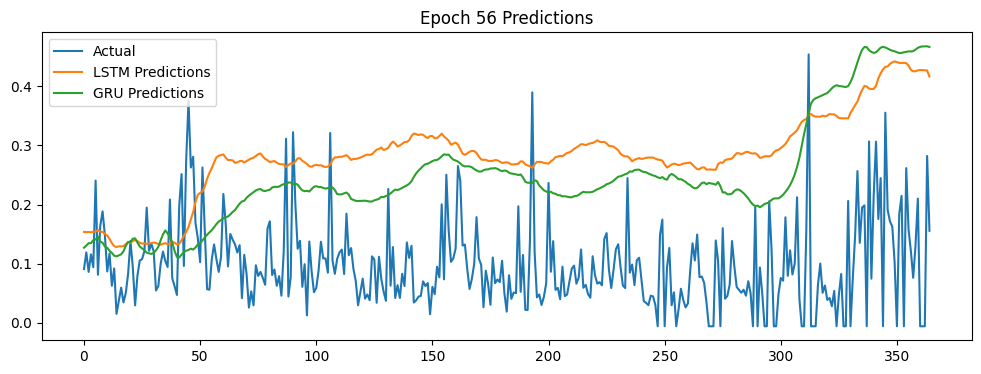

Epoch: 57 LSTM Loss: 0.01057714 GRU Loss: 0.00951204


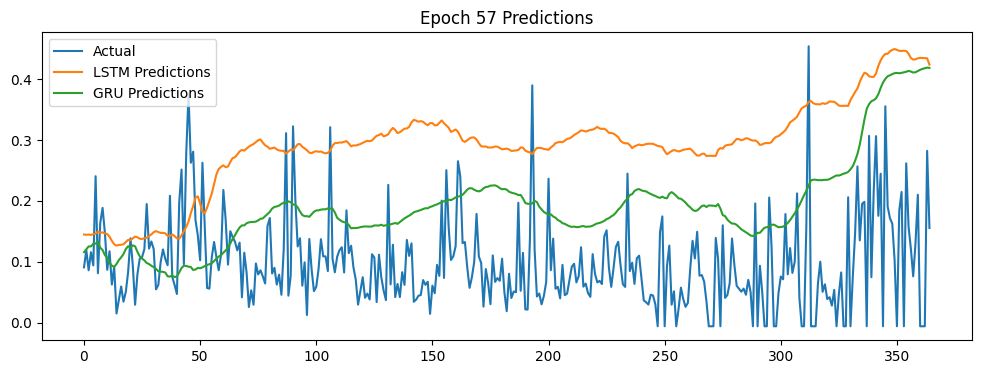

Epoch: 58 LSTM Loss: 0.01049248 GRU Loss: 0.00962077


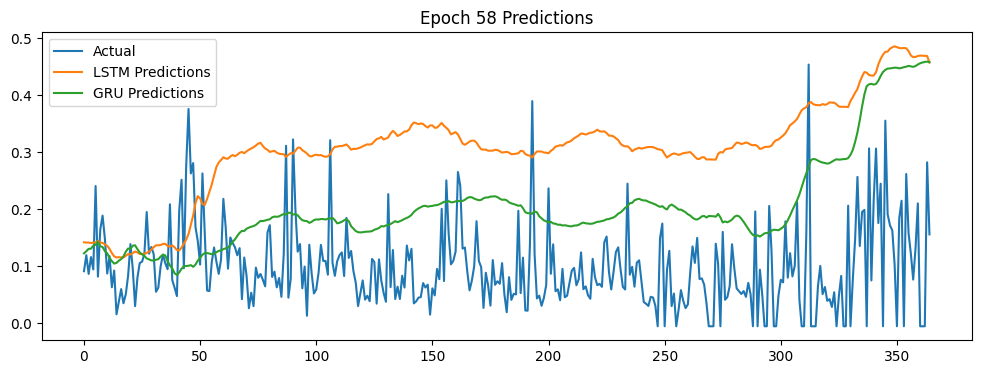

Epoch: 59 LSTM Loss: 0.01050160 GRU Loss: 0.00938631


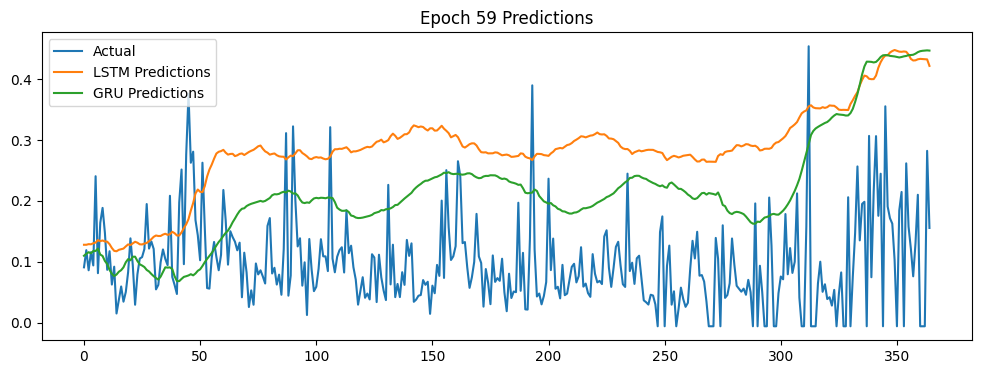

Epoch: 60 LSTM Loss: 0.01029981 GRU Loss: 0.00896355


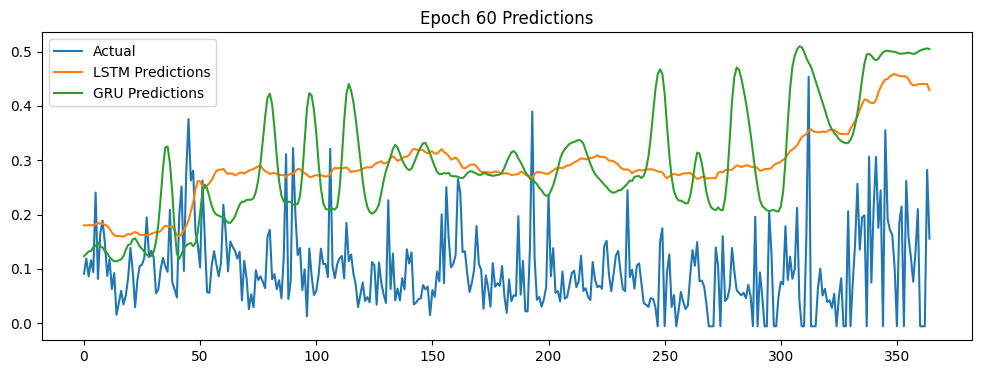

Epoch: 61 LSTM Loss: 0.01054931 GRU Loss: 0.00928853


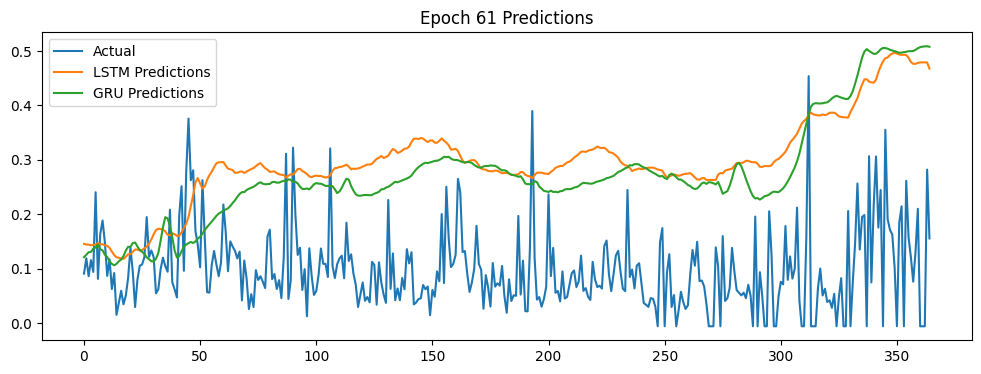

Epoch: 62 LSTM Loss: 0.01030869 GRU Loss: 0.00911298


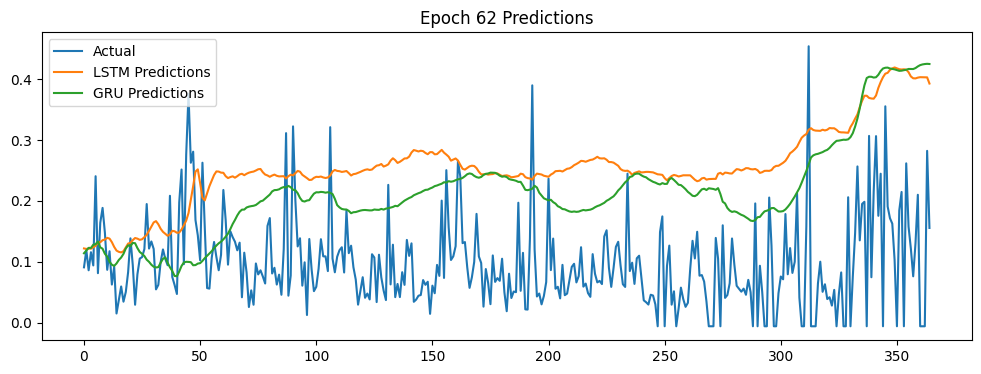

Epoch: 63 LSTM Loss: 0.01032790 GRU Loss: 0.00932644


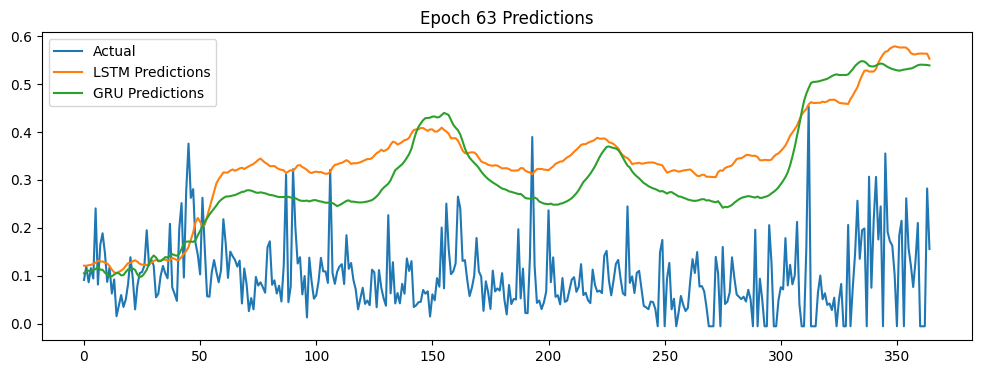

Epoch: 64 LSTM Loss: 0.01024001 GRU Loss: 0.00942161


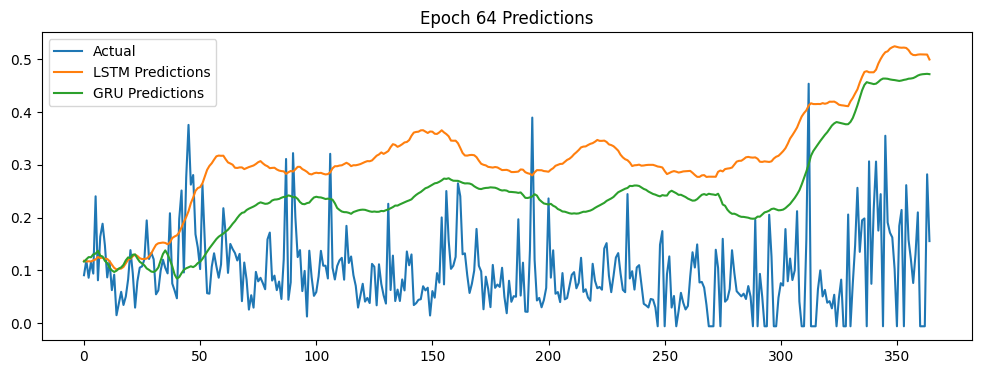

Epoch: 65 LSTM Loss: 0.01024661 GRU Loss: 0.00930341


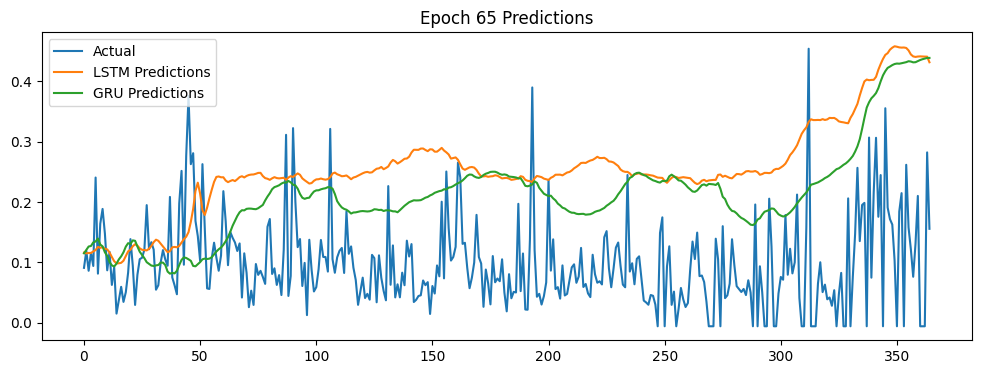

Epoch: 66 LSTM Loss: 0.01033534 GRU Loss: 0.00933086


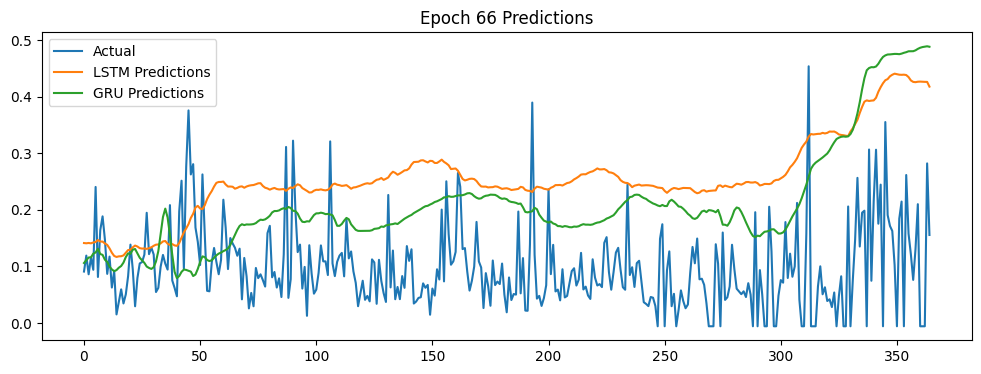

Epoch: 67 LSTM Loss: 0.01035611 GRU Loss: 0.00907998


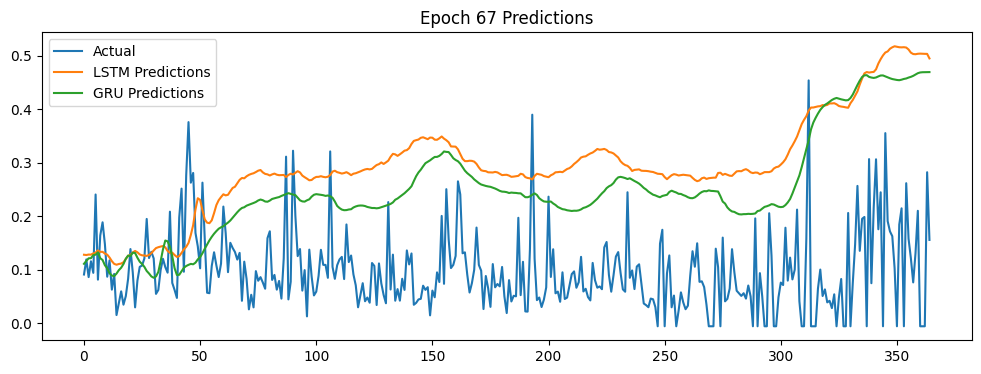

Epoch: 68 LSTM Loss: 0.01024355 GRU Loss: 0.00906964


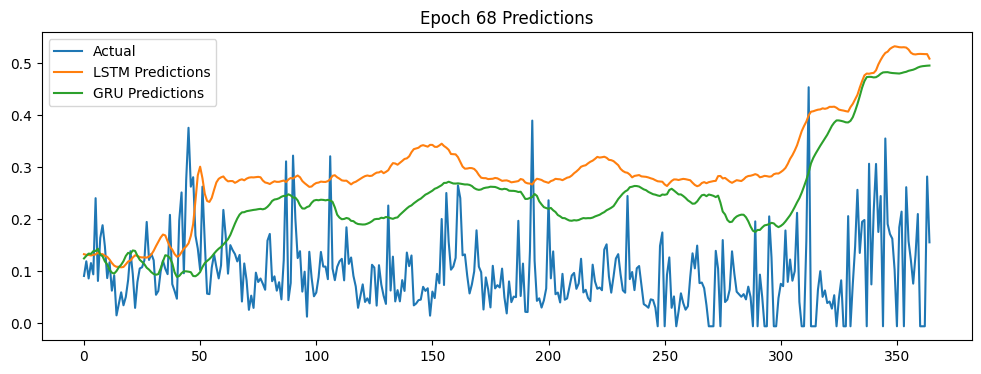

Epoch: 69 LSTM Loss: 0.00994184 GRU Loss: 0.00908670


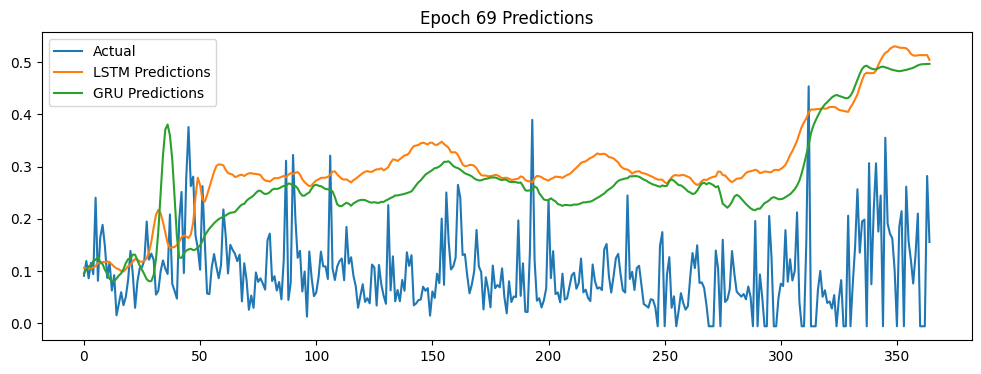

Epoch: 70 LSTM Loss: 0.01021040 GRU Loss: 0.00940627


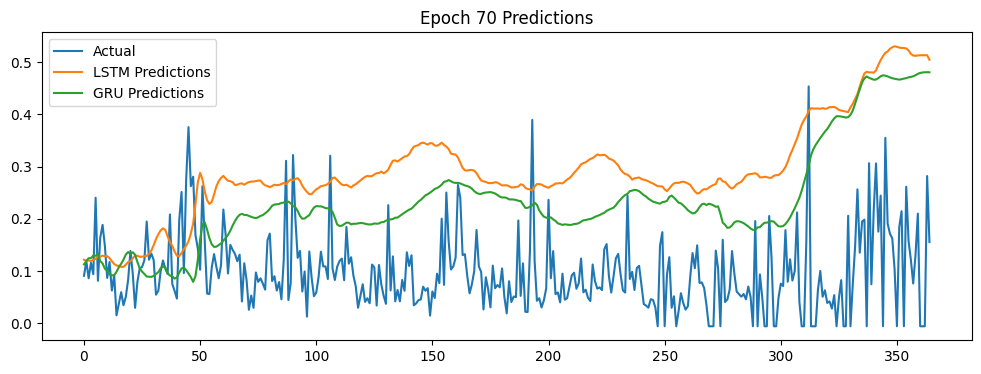

Epoch: 71 LSTM Loss: 0.01011469 GRU Loss: 0.00915463


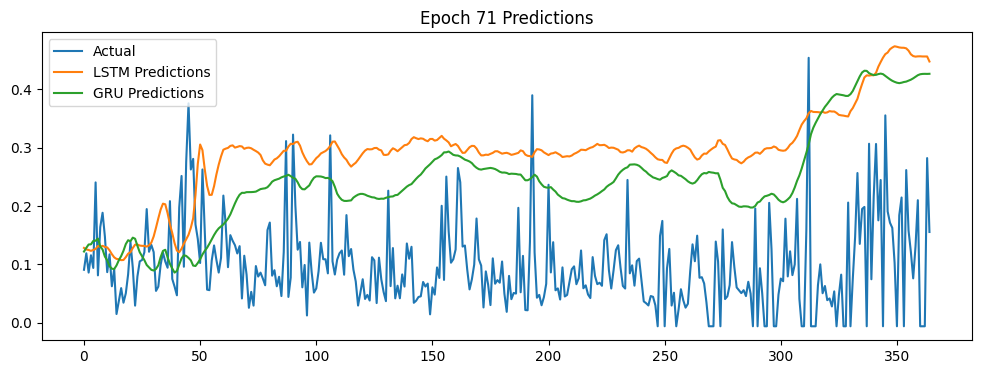

Epoch: 72 LSTM Loss: 0.00997504 GRU Loss: 0.00889862


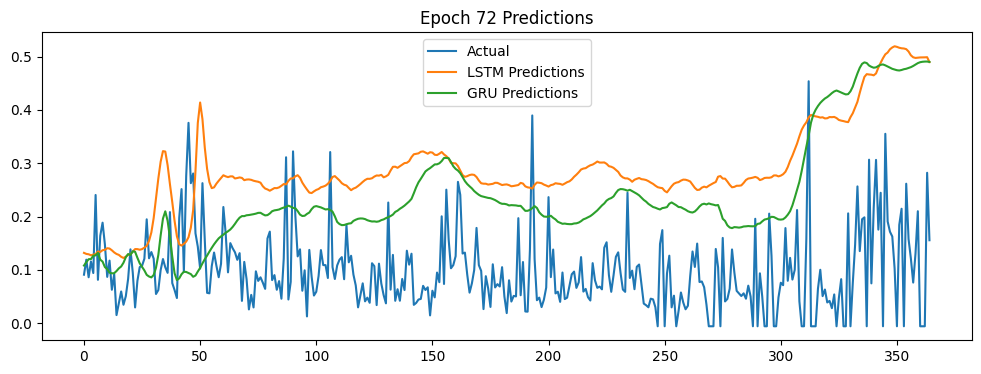

Epoch: 73 LSTM Loss: 0.00984865 GRU Loss: 0.00910182


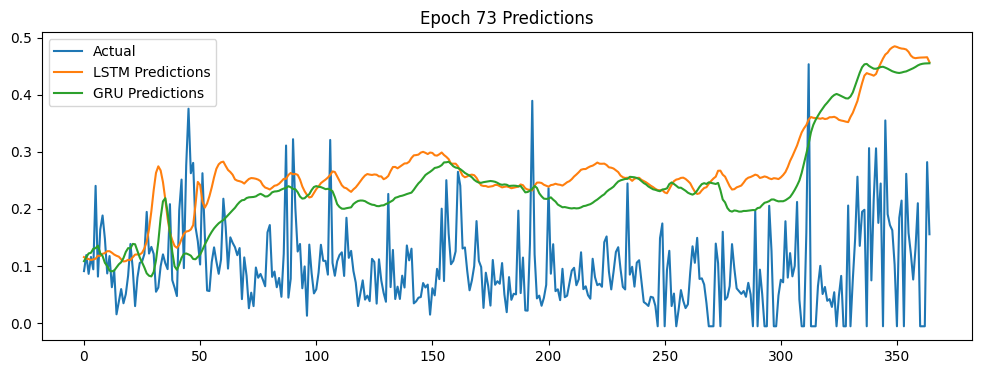

Epoch: 74 LSTM Loss: 0.00978947 GRU Loss: 0.00901932


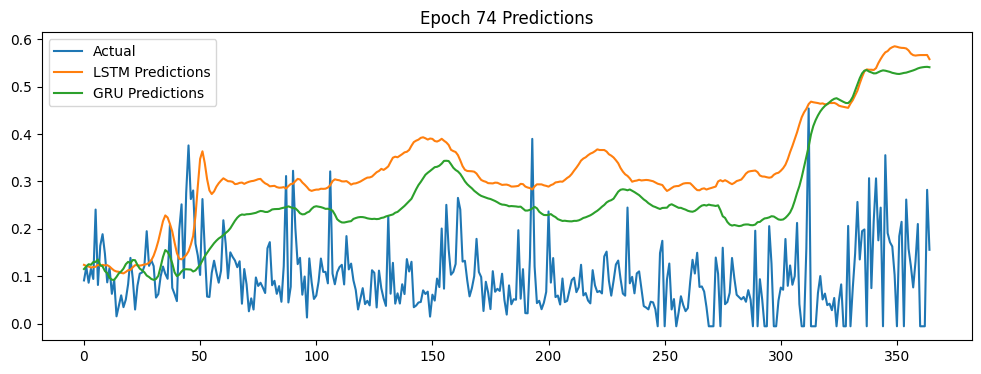

Epoch: 75 LSTM Loss: 0.00996513 GRU Loss: 0.00932836


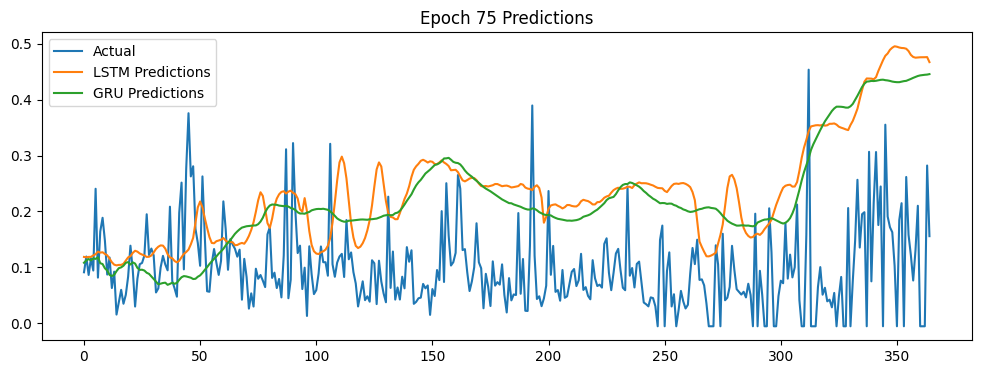

Epoch: 76 LSTM Loss: 0.01005633 GRU Loss: 0.00929785


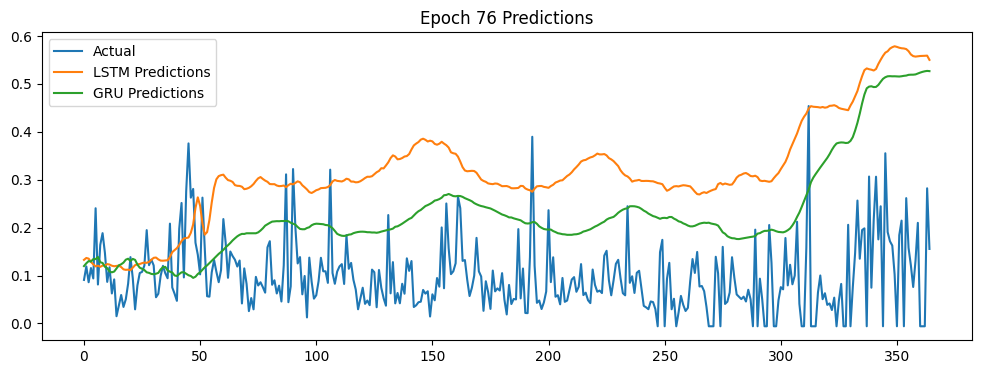

Epoch: 77 LSTM Loss: 0.01002767 GRU Loss: 0.00915814


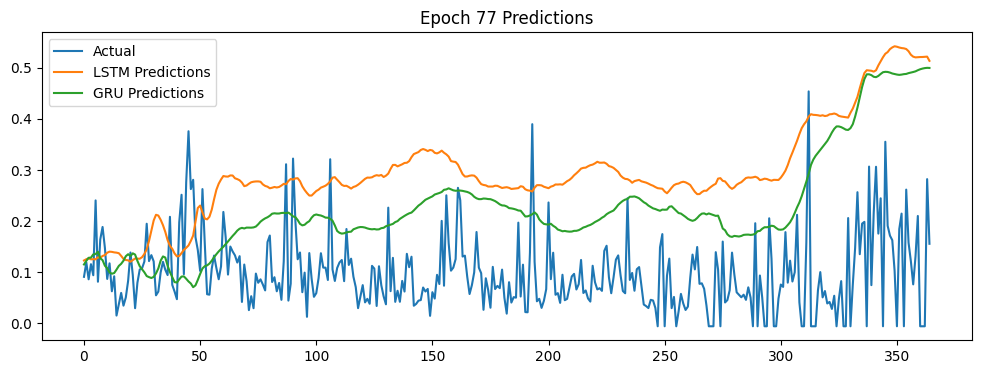

Epoch: 78 LSTM Loss: 0.00947897 GRU Loss: 0.00893591


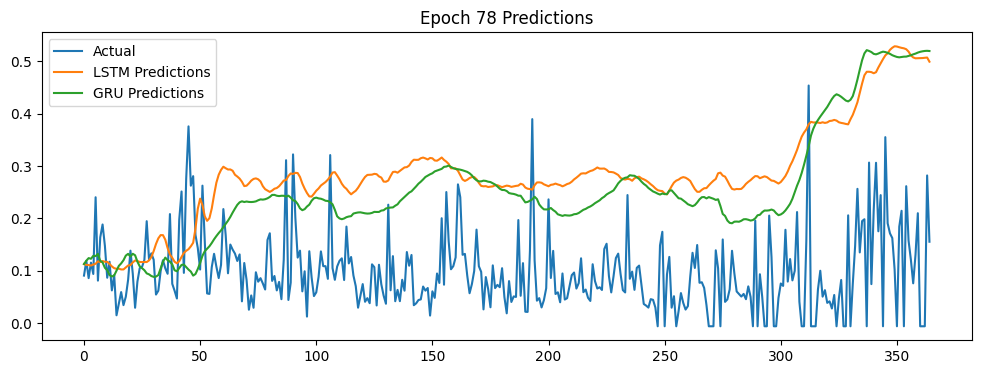

Epoch: 79 LSTM Loss: 0.00963007 GRU Loss: 0.00903291


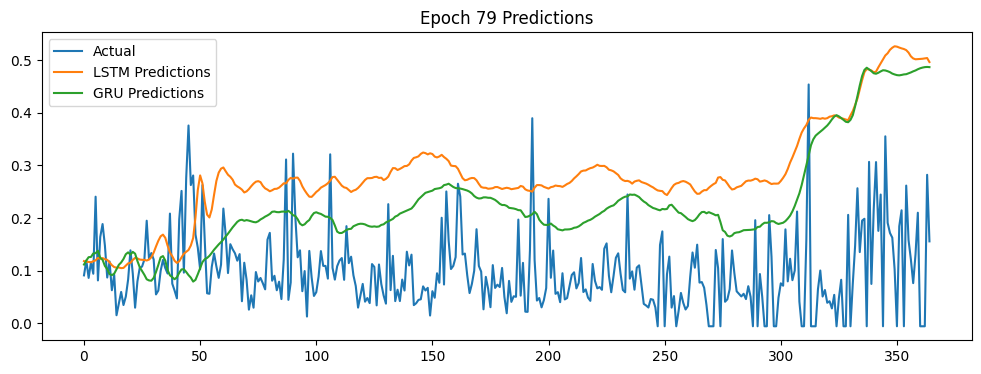

Epoch: 80 LSTM Loss: 0.00949216 GRU Loss: 0.00903421


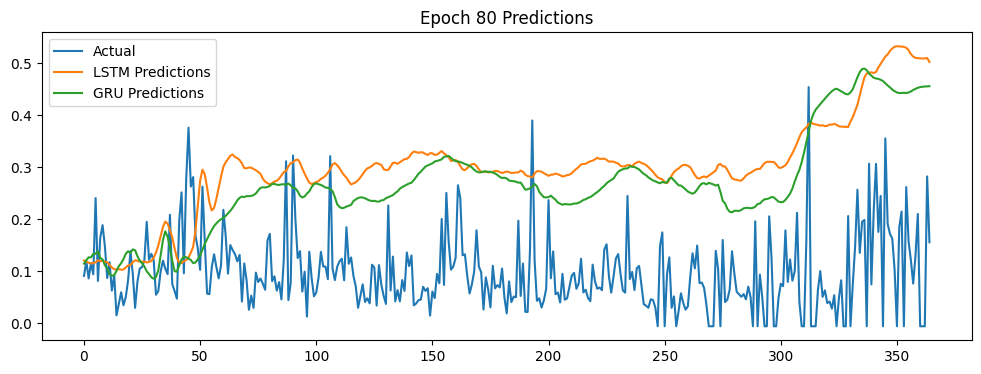

Epoch: 81 LSTM Loss: 0.00977082 GRU Loss: 0.00896251


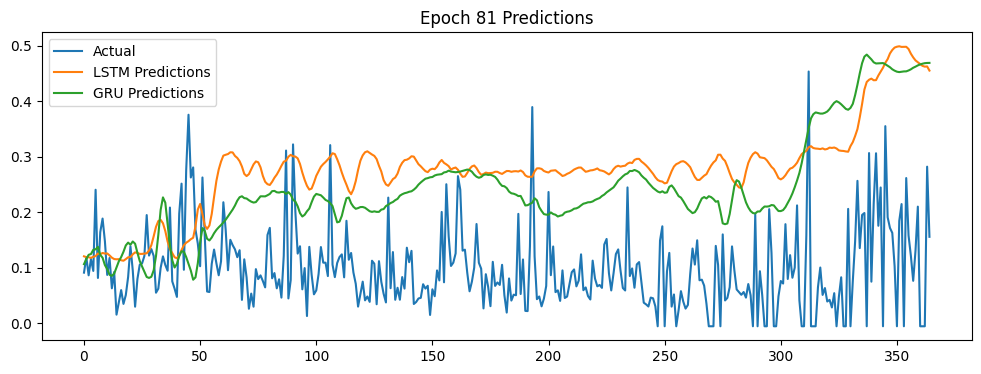

Epoch: 82 LSTM Loss: 0.00971598 GRU Loss: 0.00893690


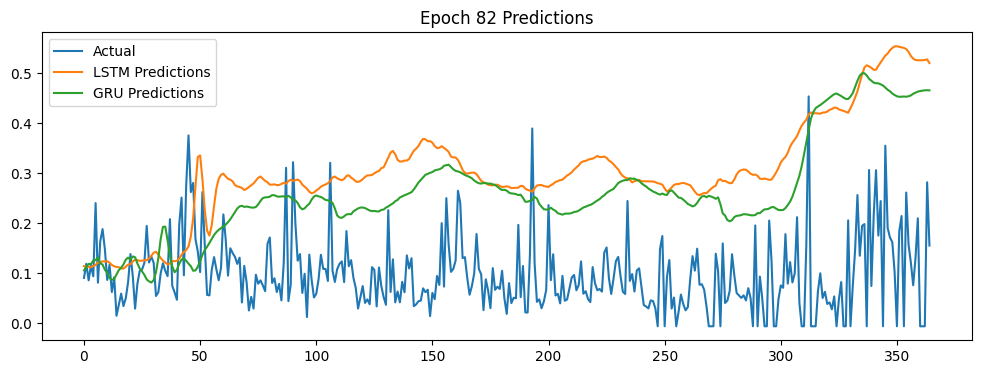

Epoch: 83 LSTM Loss: 0.00978593 GRU Loss: 0.00903833


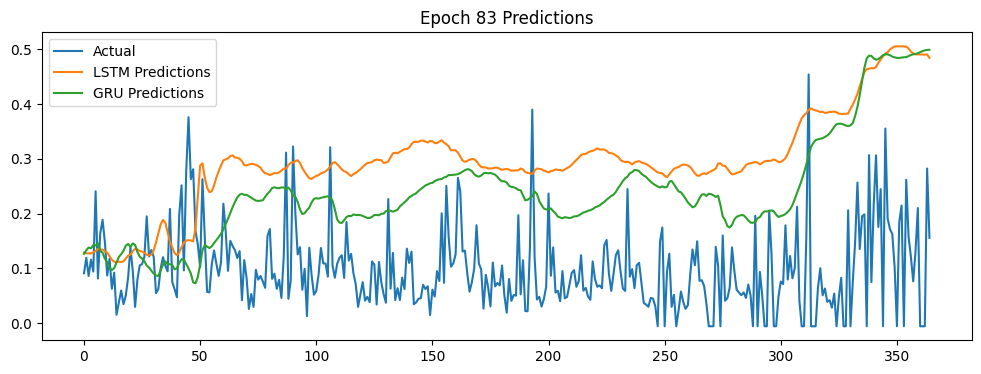

Epoch: 84 LSTM Loss: 0.00942935 GRU Loss: 0.00882725


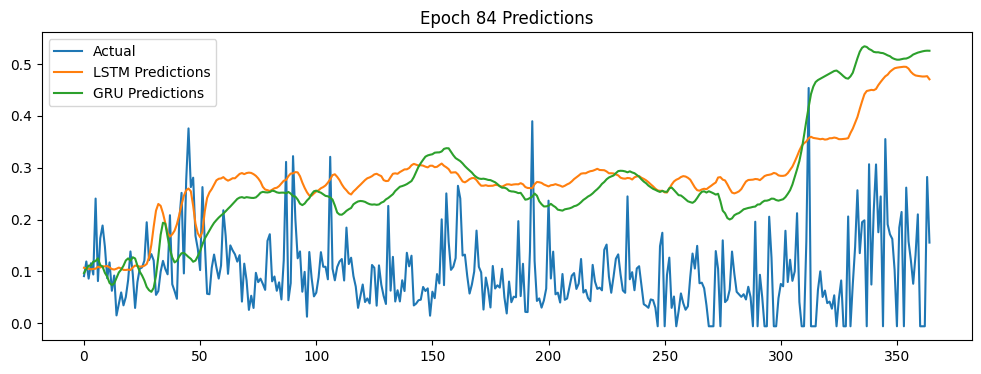

Epoch: 85 LSTM Loss: 0.00938630 GRU Loss: 0.00877639


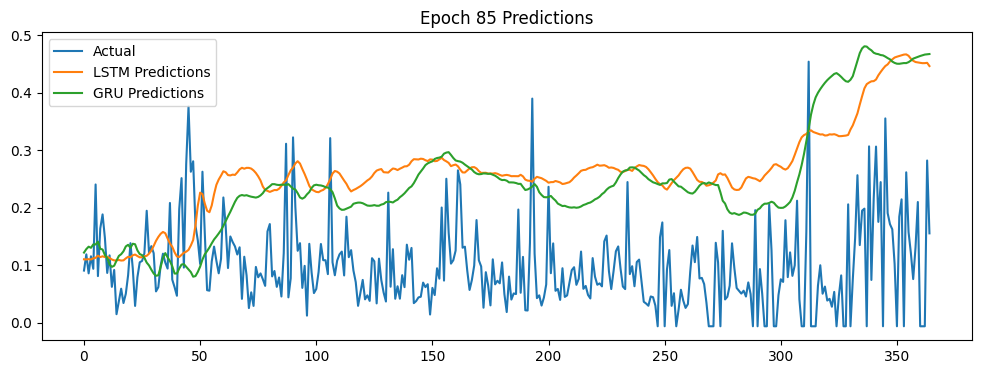

Epoch: 86 LSTM Loss: 0.00932197 GRU Loss: 0.00893824


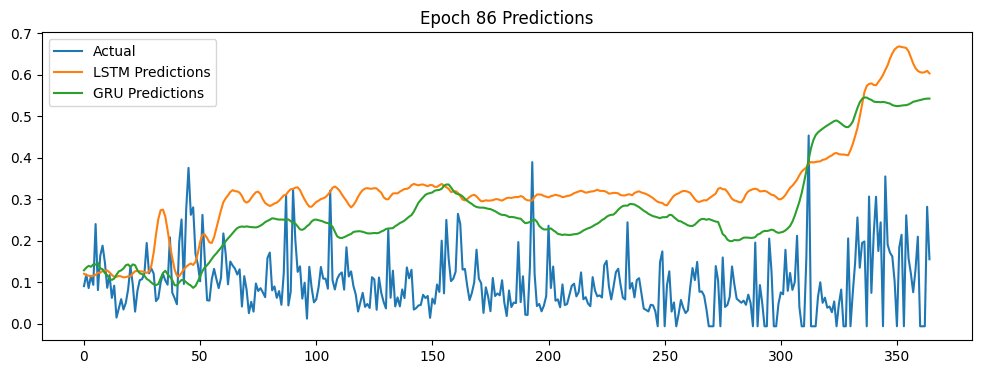

Epoch: 87 LSTM Loss: 0.00948761 GRU Loss: 0.00877038


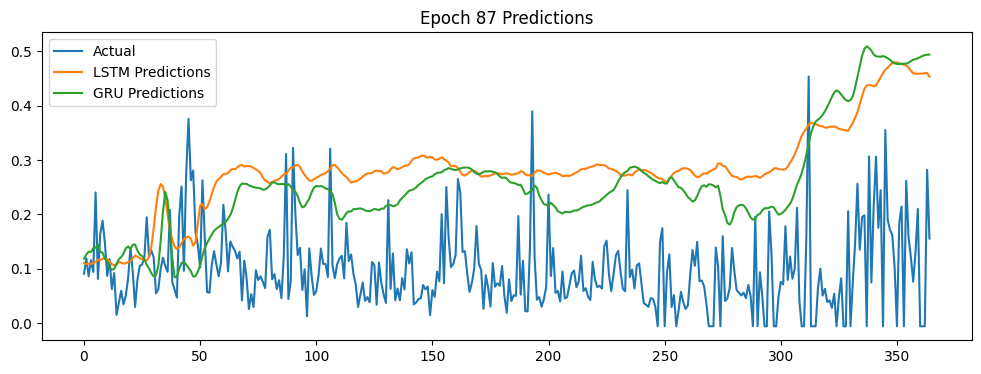

Epoch: 88 LSTM Loss: 0.00929099 GRU Loss: 0.00873387


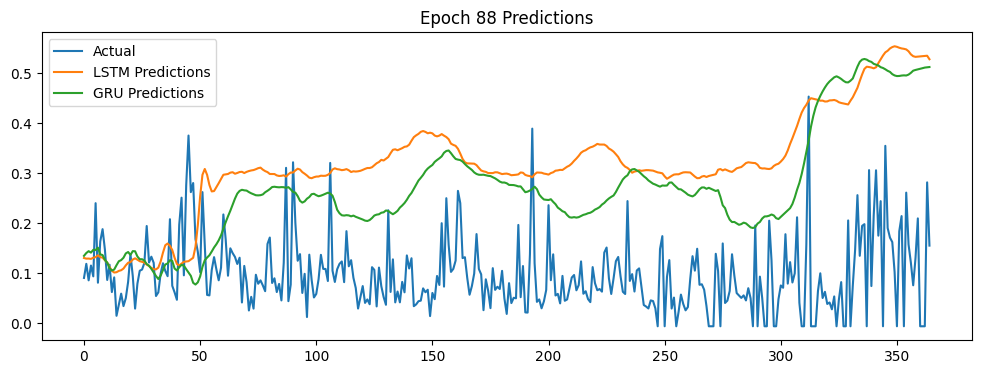

Epoch: 89 LSTM Loss: 0.00959134 GRU Loss: 0.00873011


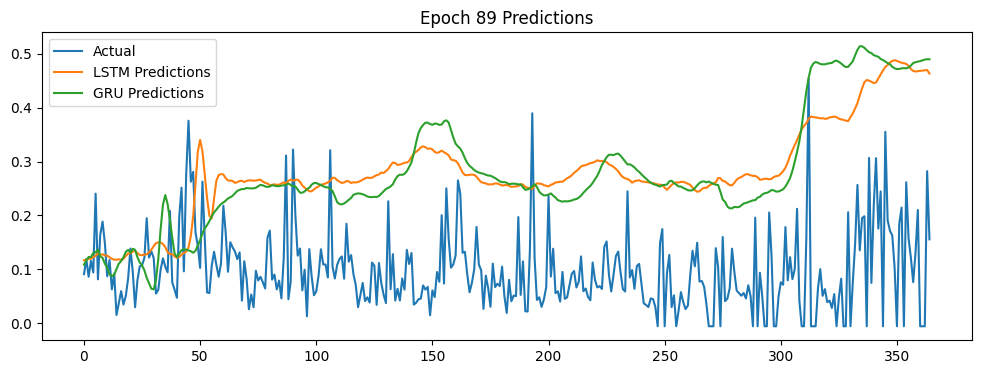

Epoch: 90 LSTM Loss: 0.00933805 GRU Loss: 0.00876678


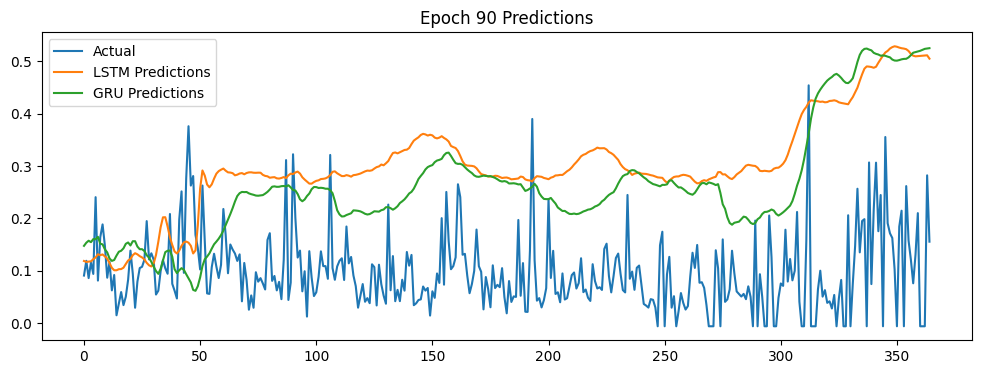

Epoch: 91 LSTM Loss: 0.00915171 GRU Loss: 0.00883263


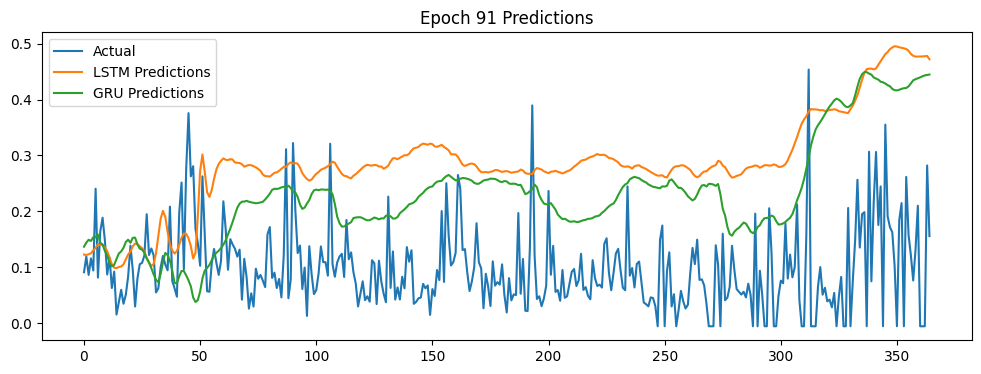

Epoch: 92 LSTM Loss: 0.00906579 GRU Loss: 0.00856181


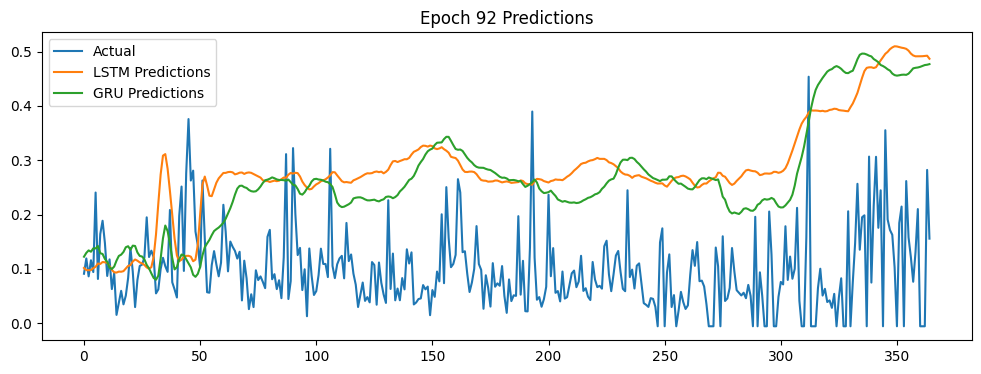

Epoch: 93 LSTM Loss: 0.00914452 GRU Loss: 0.00870661


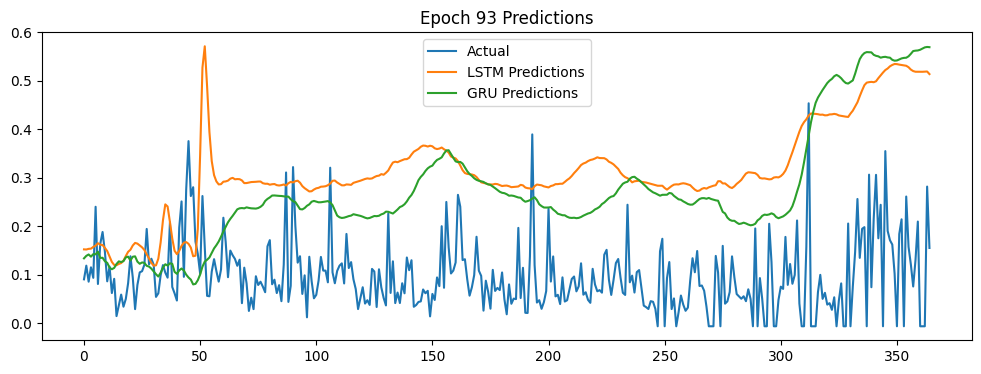

Epoch: 94 LSTM Loss: 0.00972480 GRU Loss: 0.00894604


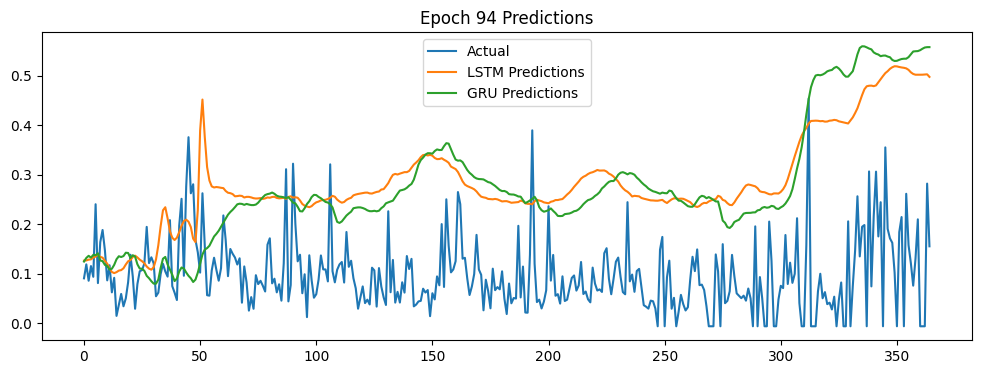

Epoch: 95 LSTM Loss: 0.00942259 GRU Loss: 0.00874657


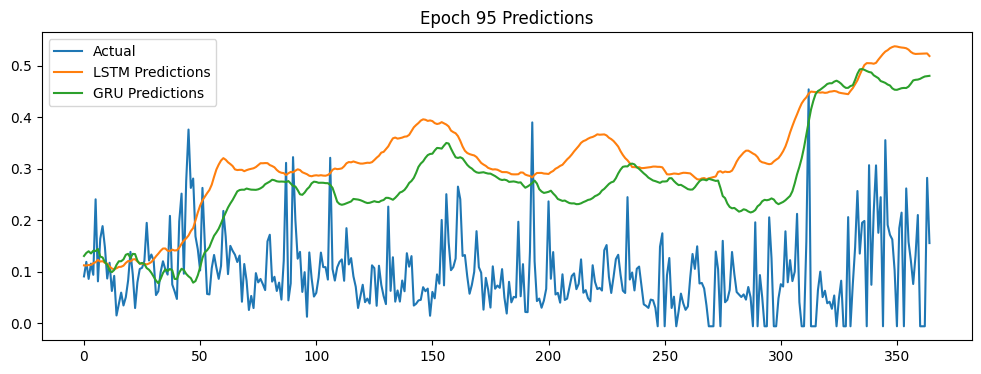

Epoch: 96 LSTM Loss: 0.00919759 GRU Loss: 0.00879741


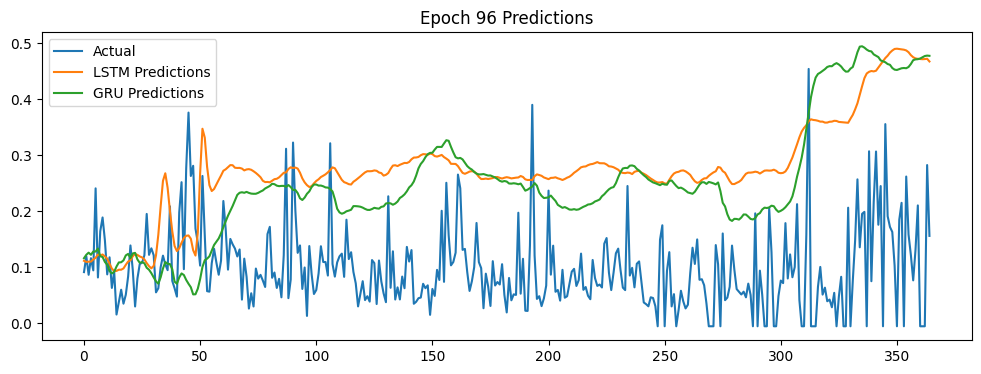

Epoch: 97 LSTM Loss: 0.00937246 GRU Loss: 0.00860332


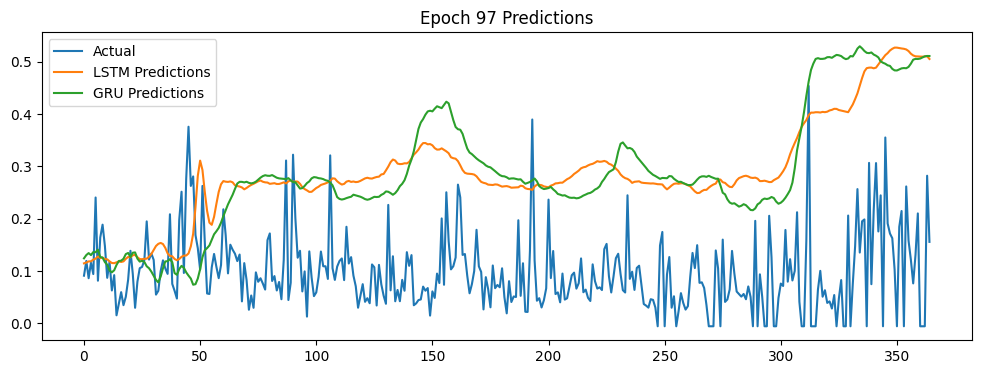

Epoch: 98 LSTM Loss: 0.00947404 GRU Loss: 0.00878478


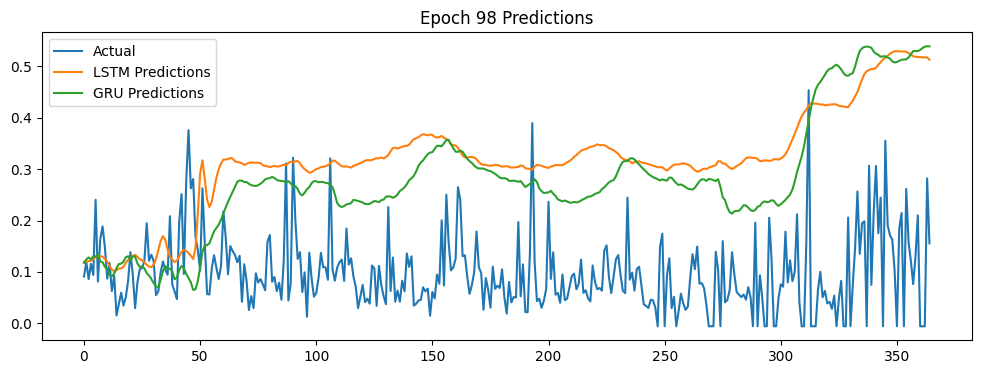

Epoch: 99 LSTM Loss: 0.00912420 GRU Loss: 0.00857093


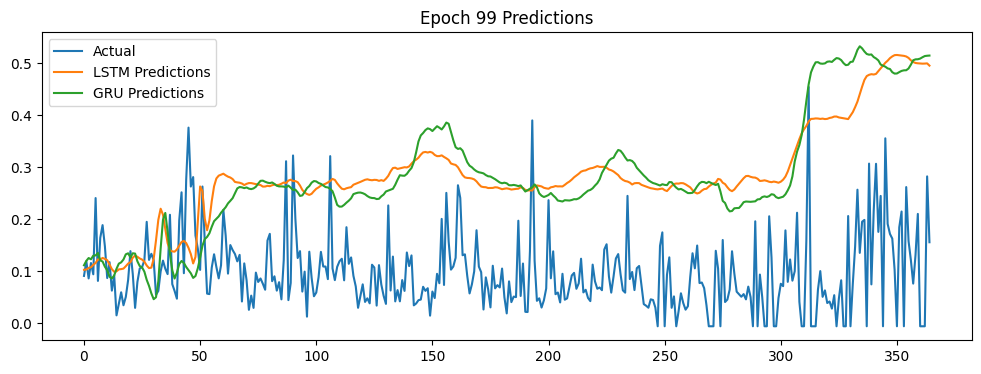

Epoch: 100 LSTM Loss: 0.00901583 GRU Loss: 0.00854881


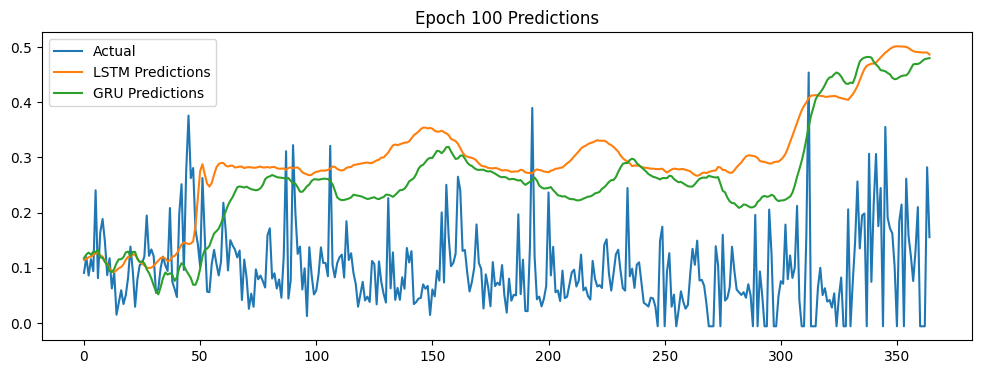

Epoch: 101 LSTM Loss: 0.00967694 GRU Loss: 0.00873206


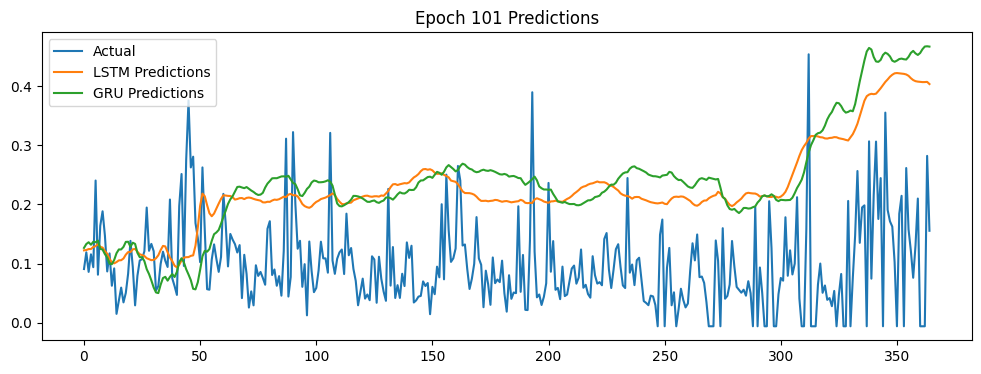

Epoch: 102 LSTM Loss: 0.00921594 GRU Loss: 0.00857707


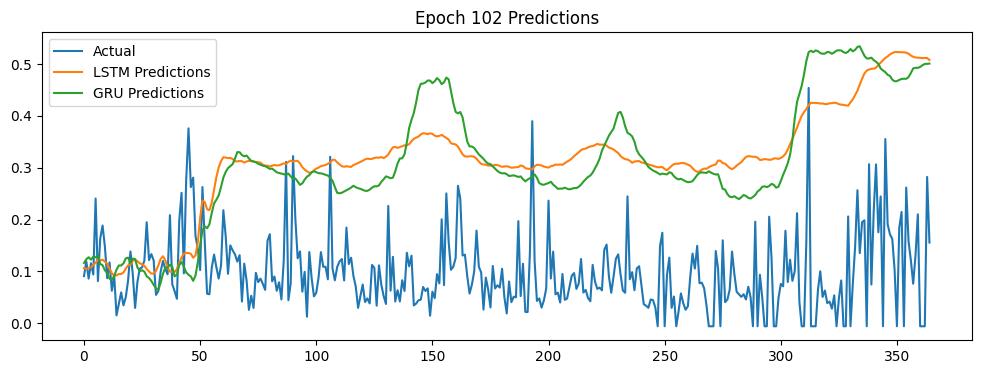

Epoch: 103 LSTM Loss: 0.00908971 GRU Loss: 0.00871022


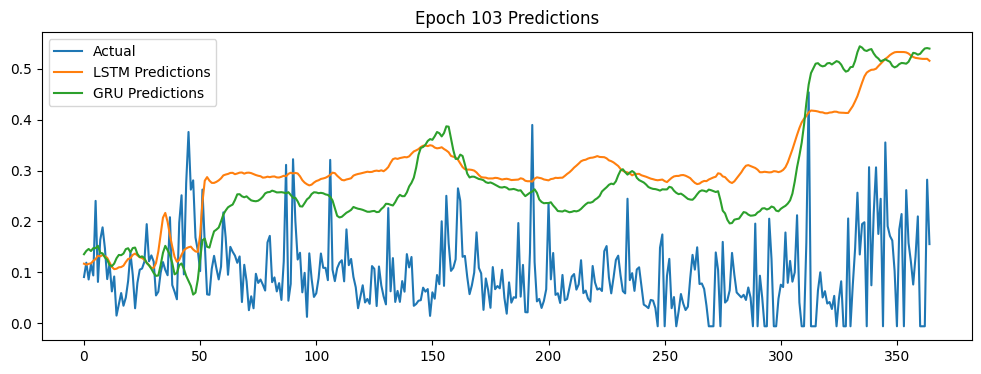

Epoch: 104 LSTM Loss: 0.00899299 GRU Loss: 0.00843180


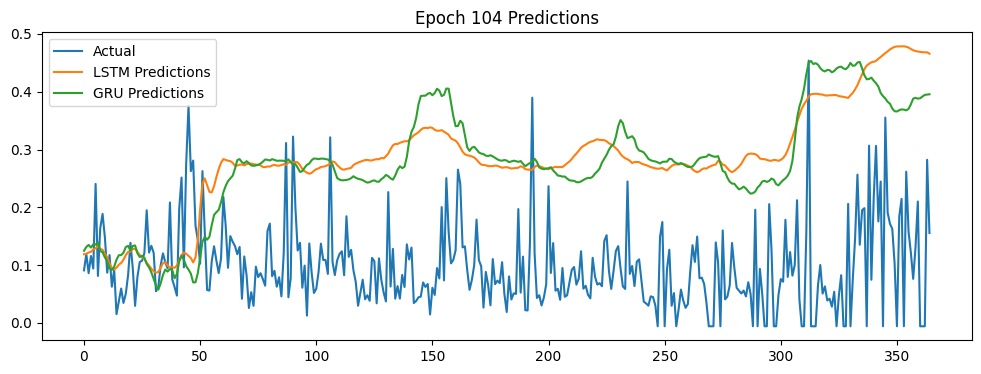

Epoch: 105 LSTM Loss: 0.00911311 GRU Loss: 0.00854590


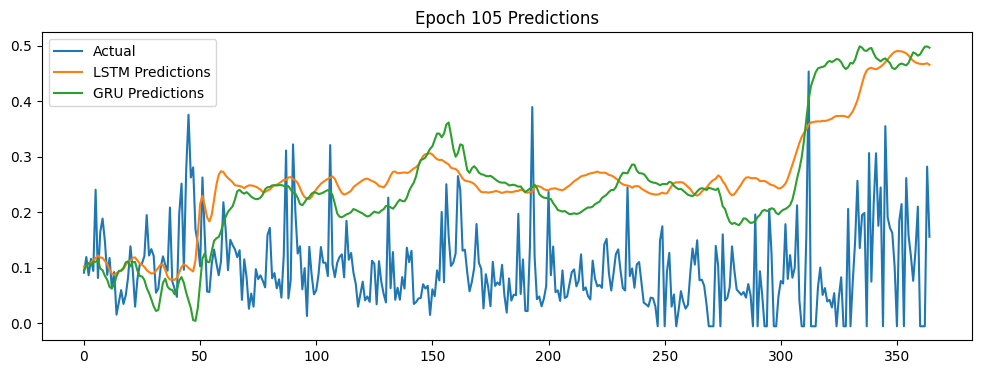

Epoch: 106 LSTM Loss: 0.00888089 GRU Loss: 0.00849719


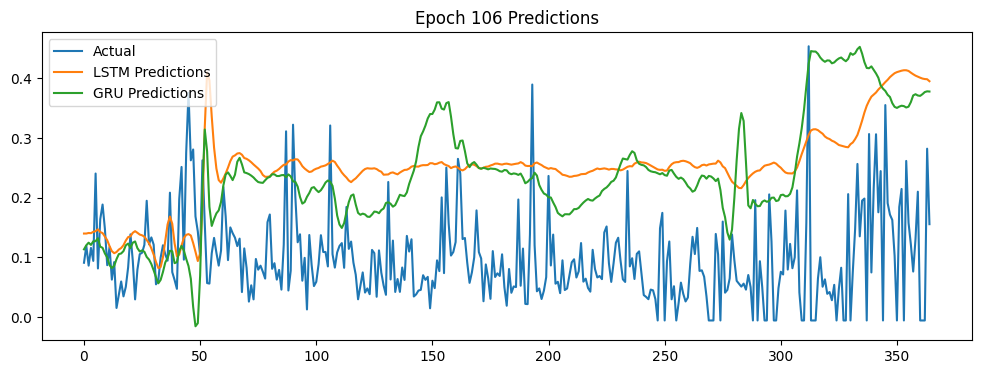

Epoch: 107 LSTM Loss: 0.01006705 GRU Loss: 0.00848201


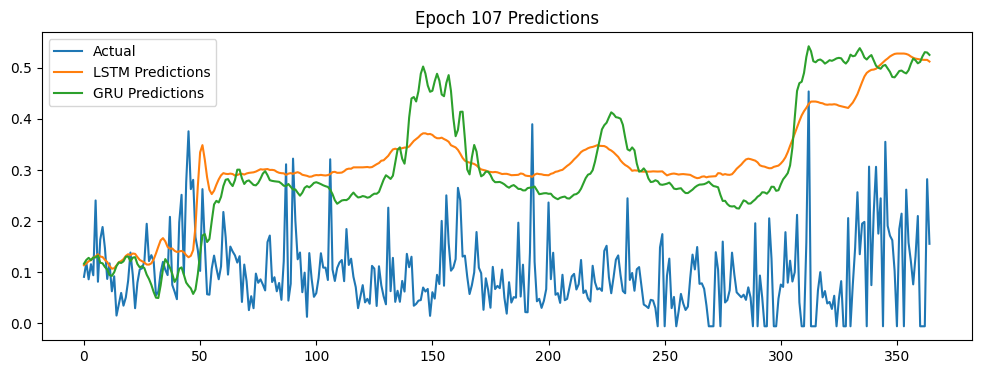

Epoch: 108 LSTM Loss: 0.00907427 GRU Loss: 0.00852078


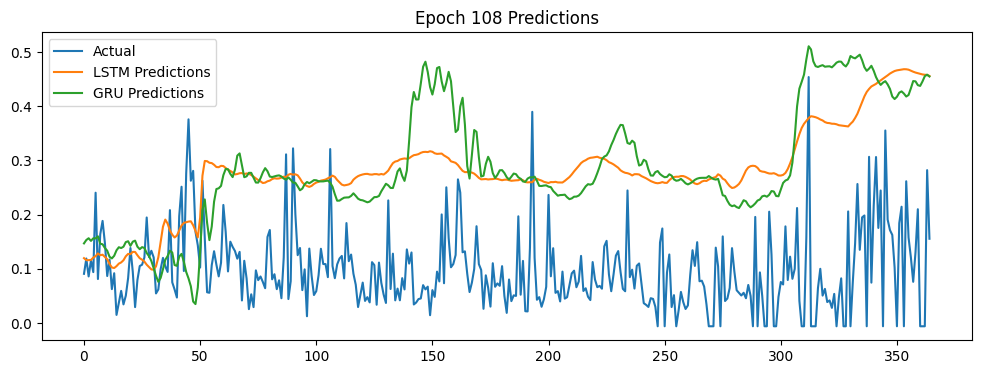

Epoch: 109 LSTM Loss: 0.00899820 GRU Loss: 0.00850719


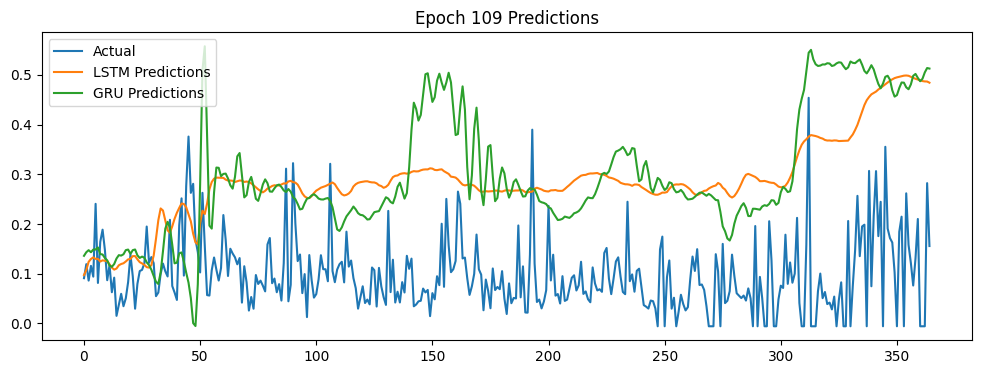

Epoch: 110 LSTM Loss: 0.00961855 GRU Loss: 0.00836451


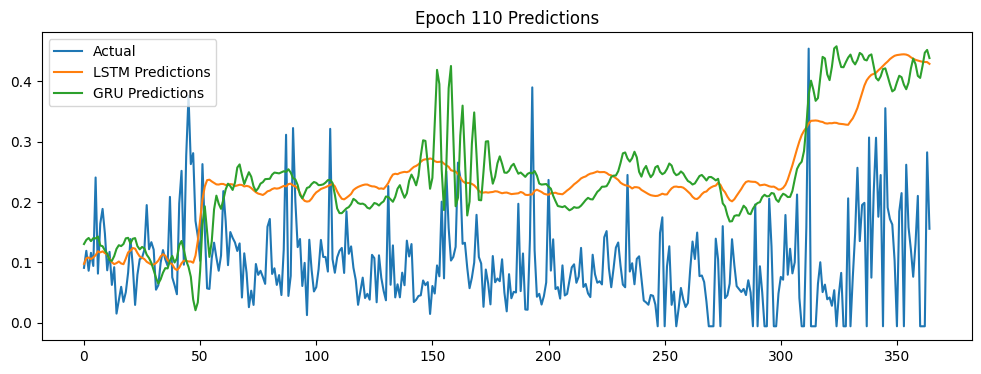

Epoch: 111 LSTM Loss: 0.01026060 GRU Loss: 0.00881928


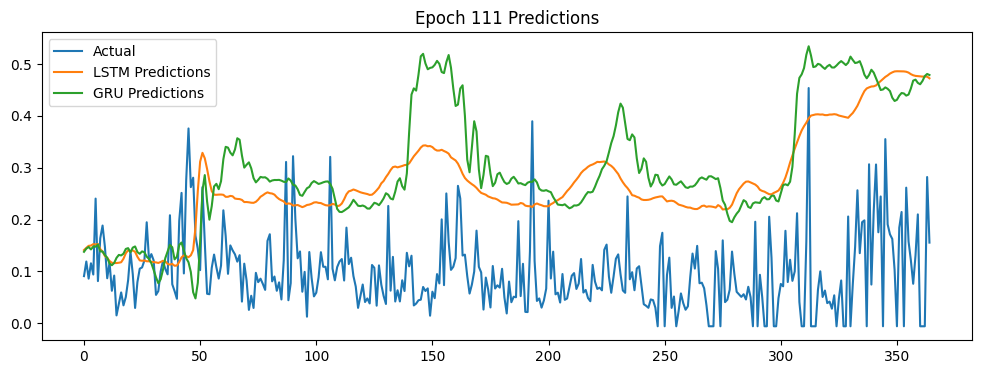

Epoch: 112 LSTM Loss: 0.00949716 GRU Loss: 0.00854189


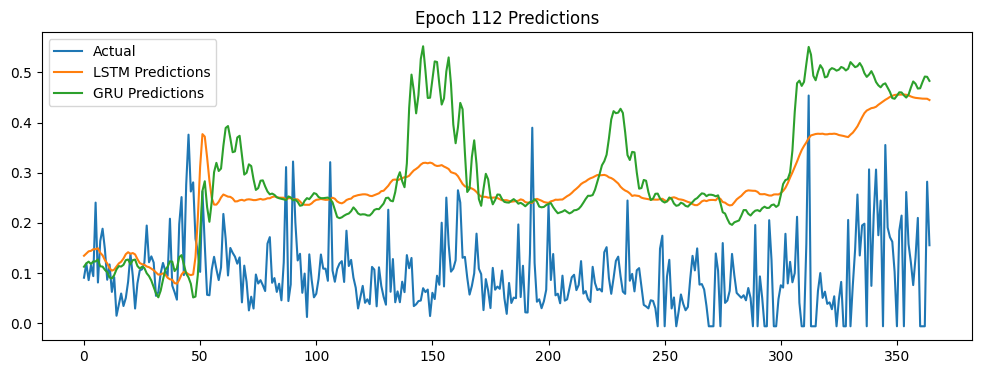

Epoch: 113 LSTM Loss: 0.00929111 GRU Loss: 0.00830754


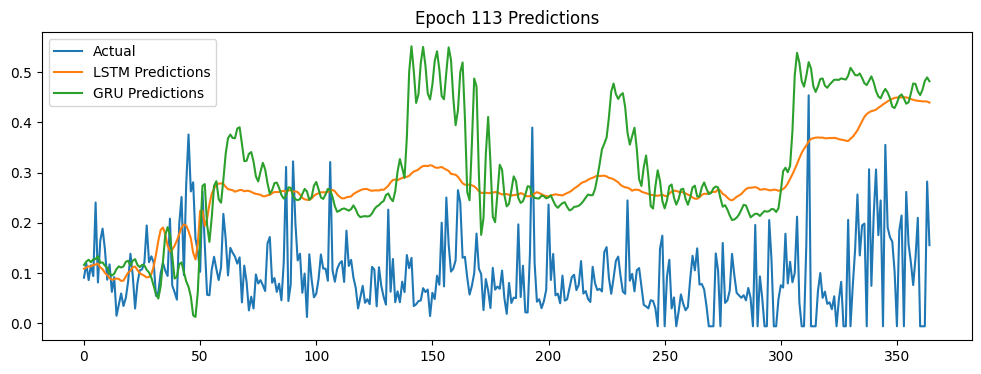

Epoch: 114 LSTM Loss: 0.00913753 GRU Loss: 0.00836400


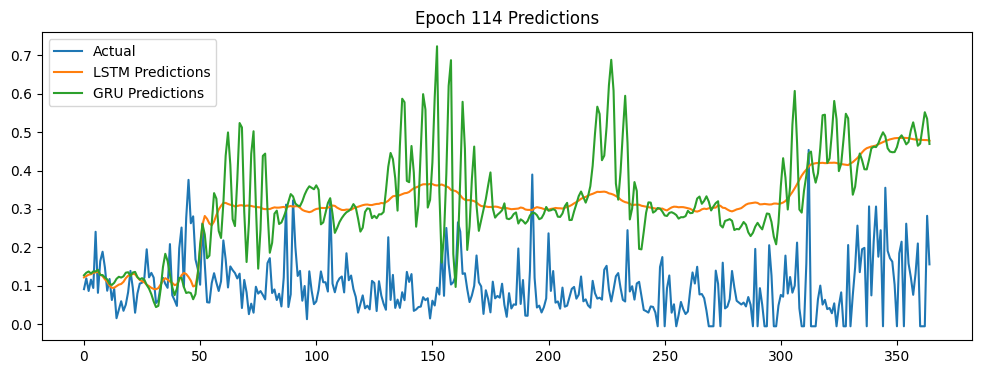

Epoch: 115 LSTM Loss: 0.00967130 GRU Loss: 0.00841772


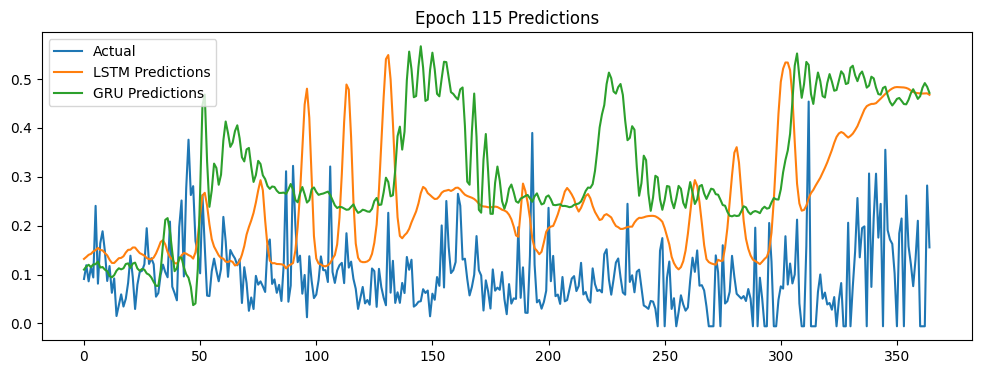

Epoch: 116 LSTM Loss: 0.00940322 GRU Loss: 0.00832696


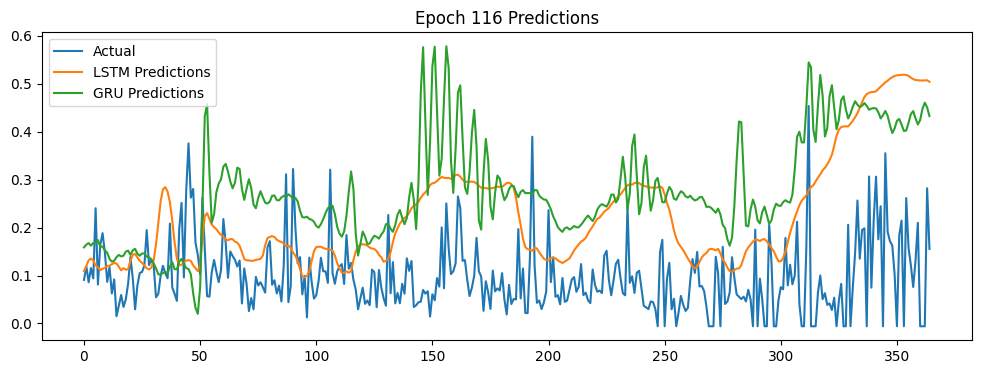

Epoch: 117 LSTM Loss: 0.00965535 GRU Loss: 0.00833921


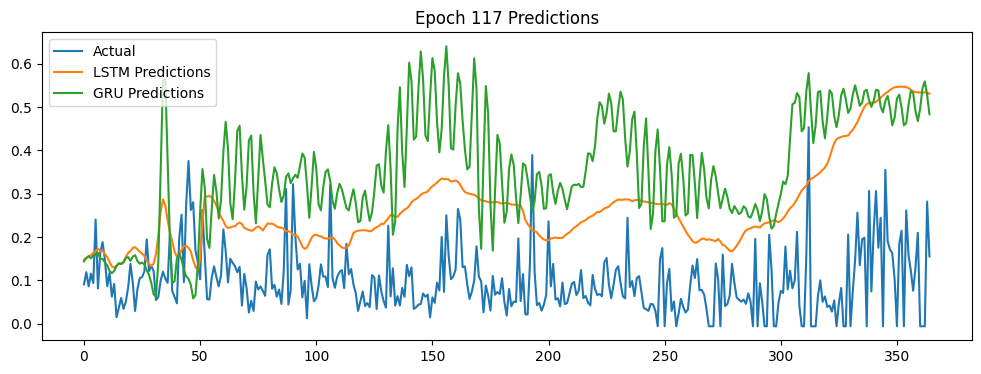

Epoch: 118 LSTM Loss: 0.00943587 GRU Loss: 0.00845930


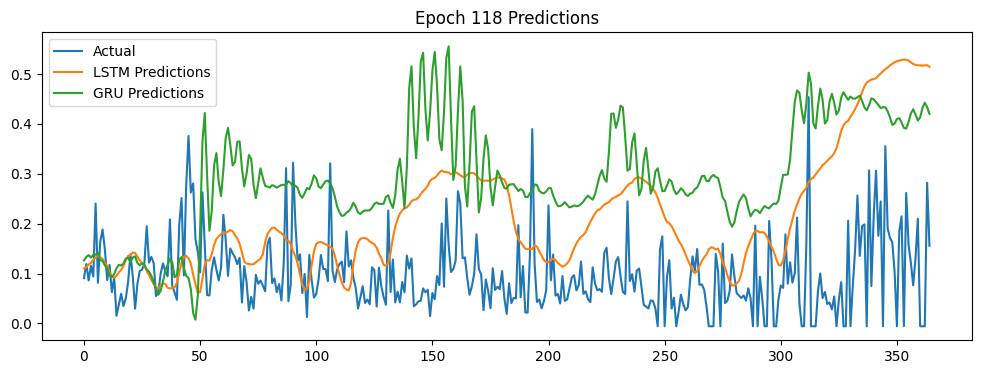

Epoch: 119 LSTM Loss: 0.00922501 GRU Loss: 0.00835881


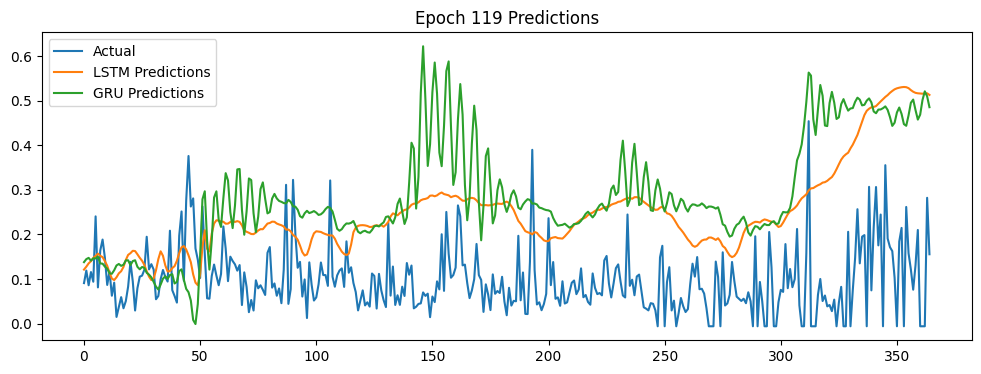

Epoch: 120 LSTM Loss: 0.00962064 GRU Loss: 0.00868913


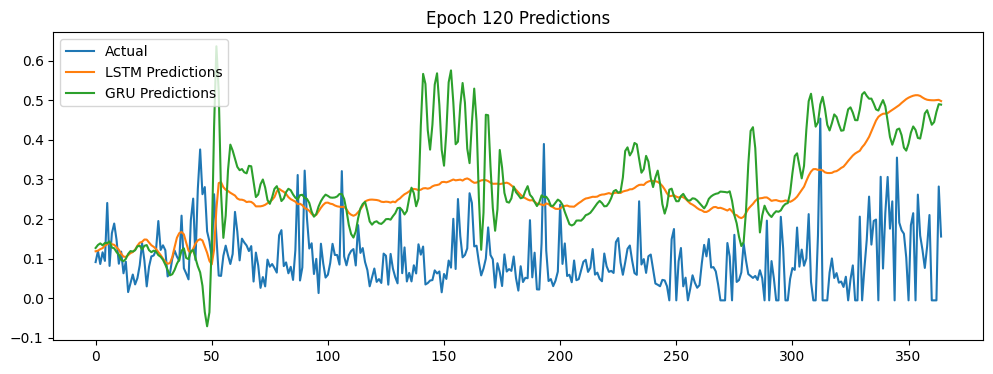

Epoch: 121 LSTM Loss: 0.00931490 GRU Loss: 0.00835129


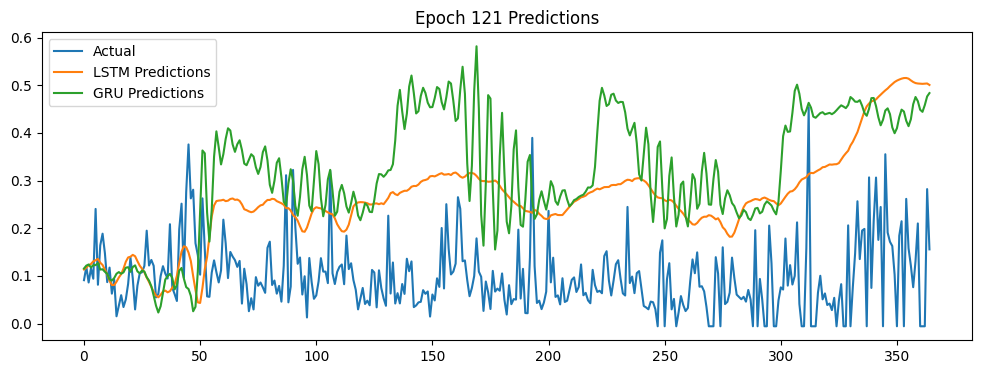

Epoch: 122 LSTM Loss: 0.00916508 GRU Loss: 0.00825399


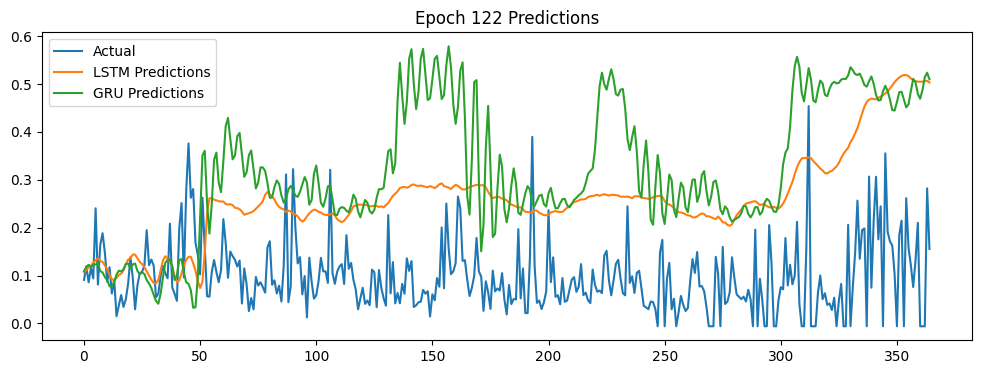

Epoch: 123 LSTM Loss: 0.00897988 GRU Loss: 0.00818759


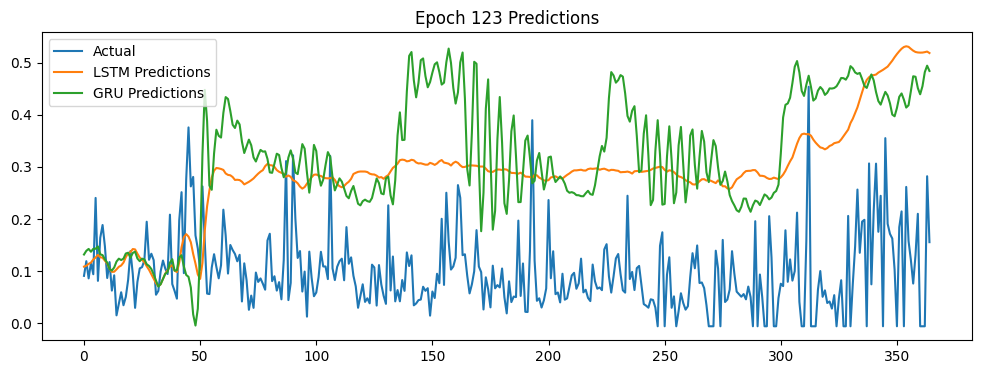

Epoch: 124 LSTM Loss: 0.00933734 GRU Loss: 0.00810437


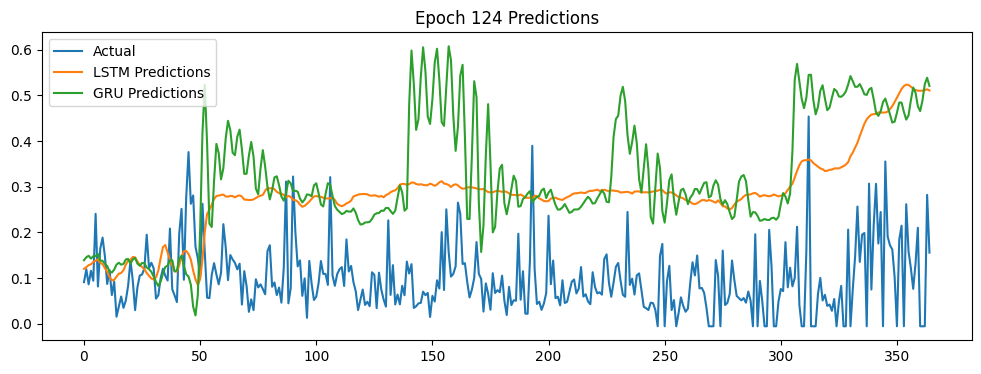

Epoch: 125 LSTM Loss: 0.00894069 GRU Loss: 0.00817564


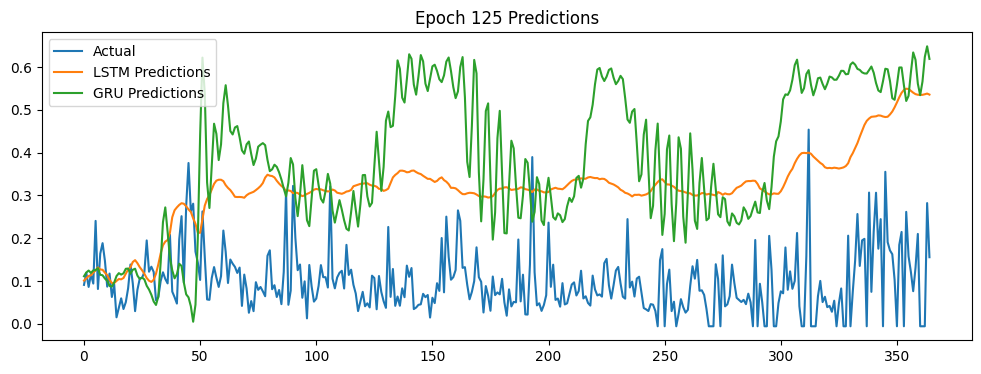

Epoch: 126 LSTM Loss: 0.00911628 GRU Loss: 0.00828829


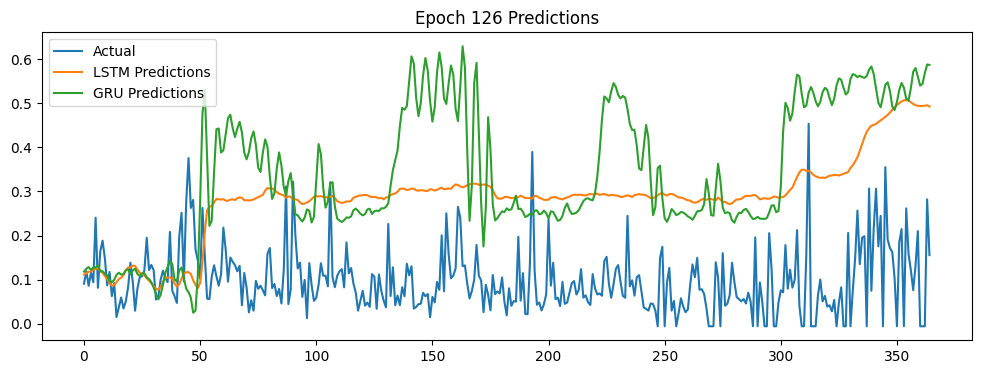

Epoch: 127 LSTM Loss: 0.00906617 GRU Loss: 0.00811253


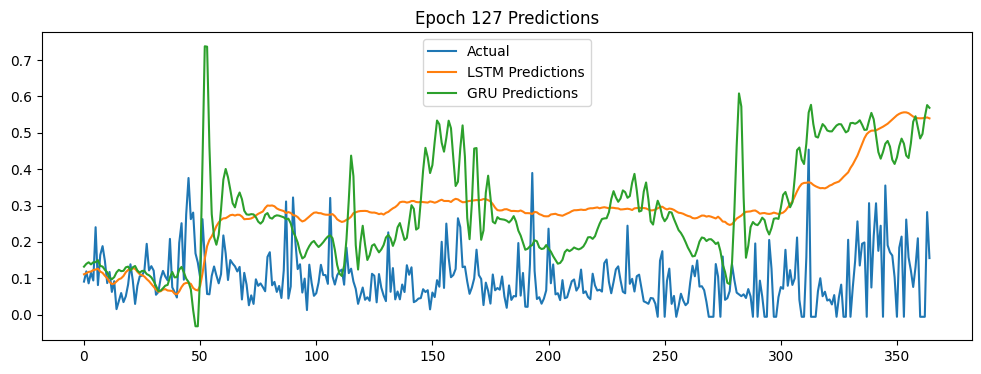

Epoch: 128 LSTM Loss: 0.00883244 GRU Loss: 0.00821048


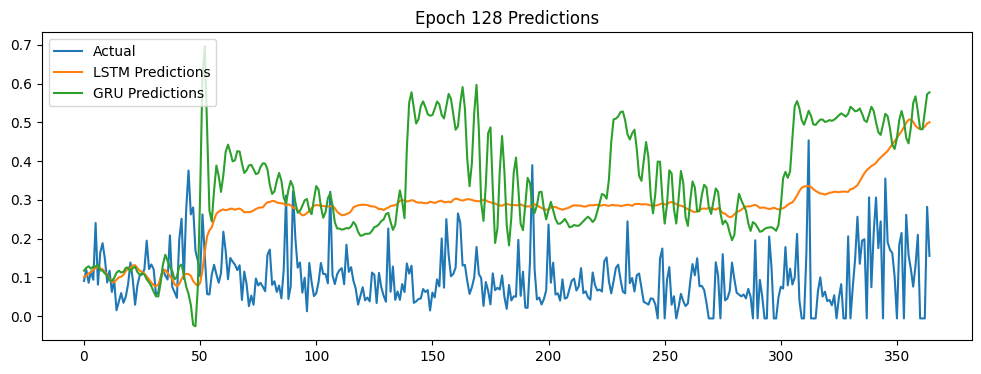

Epoch: 129 LSTM Loss: 0.00880015 GRU Loss: 0.00822431


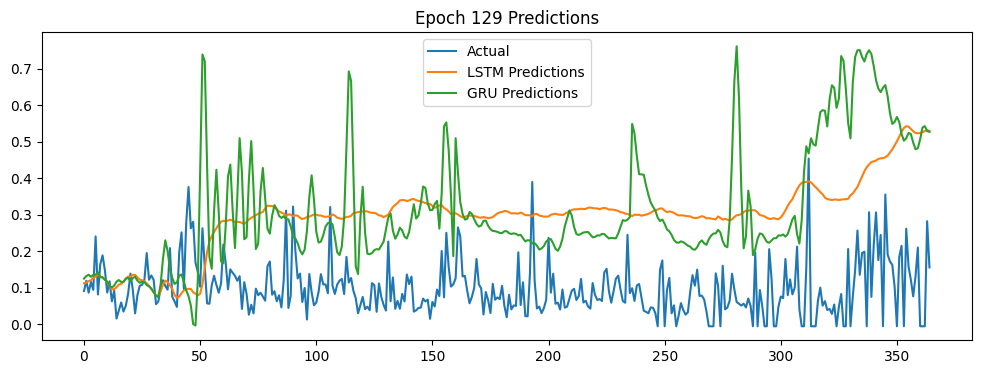

Epoch: 130 LSTM Loss: 0.00877639 GRU Loss: 0.00827918


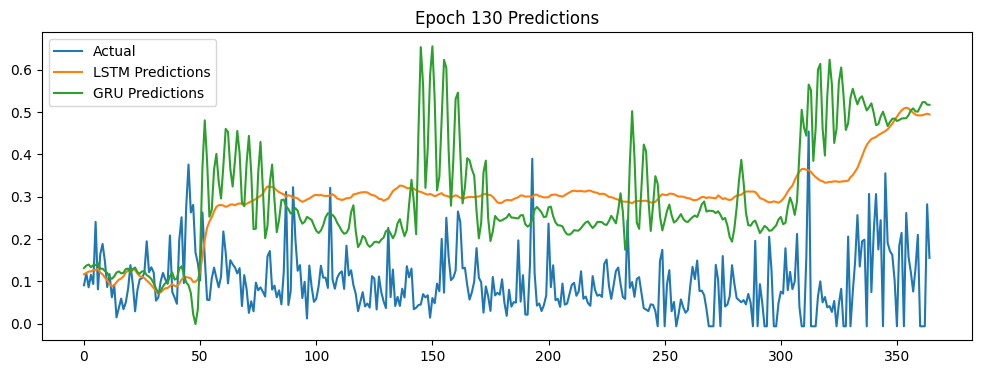

Epoch: 131 LSTM Loss: 0.00902593 GRU Loss: 0.00821710


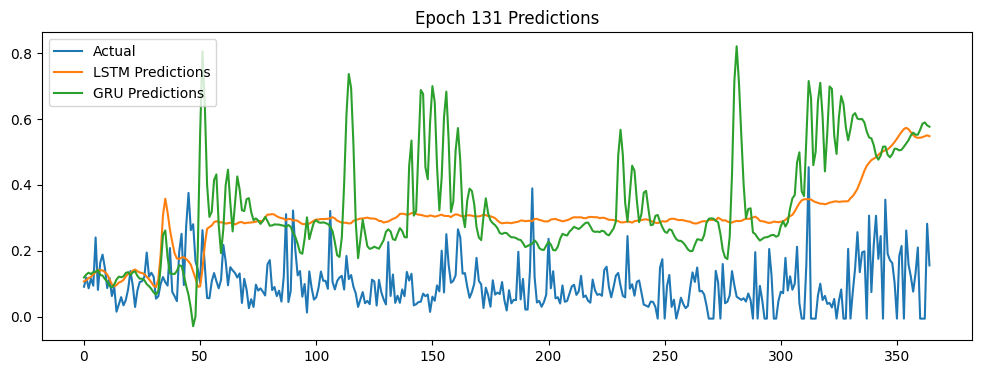

Epoch: 132 LSTM Loss: 0.00886233 GRU Loss: 0.00815240


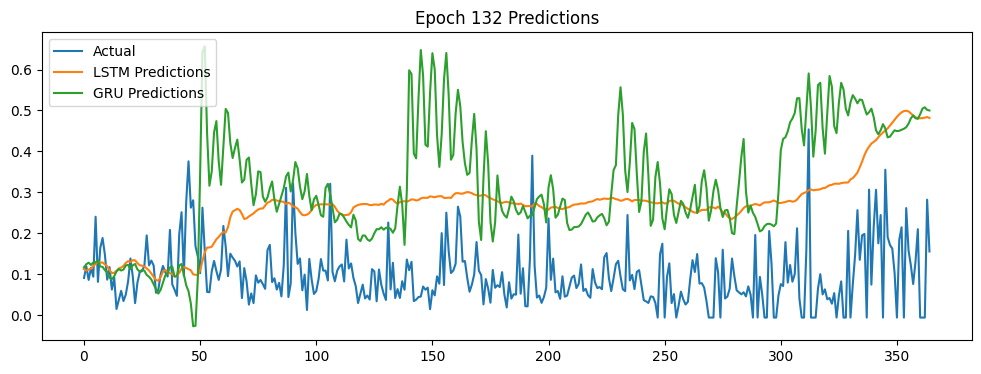

Epoch: 133 LSTM Loss: 0.00941043 GRU Loss: 0.00824561


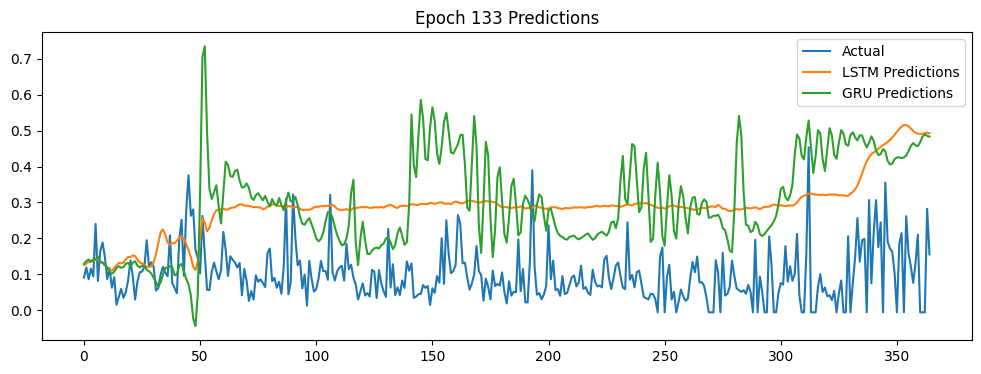

Epoch: 134 LSTM Loss: 0.00905627 GRU Loss: 0.00840492


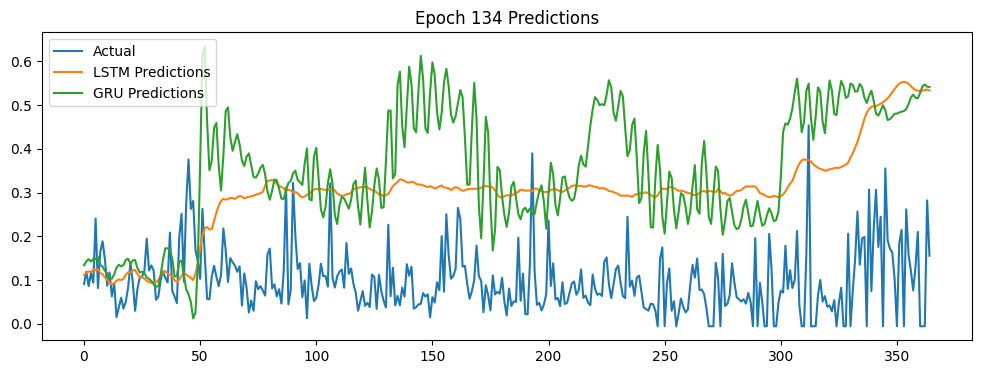

Epoch: 135 LSTM Loss: 0.00895986 GRU Loss: 0.00818494


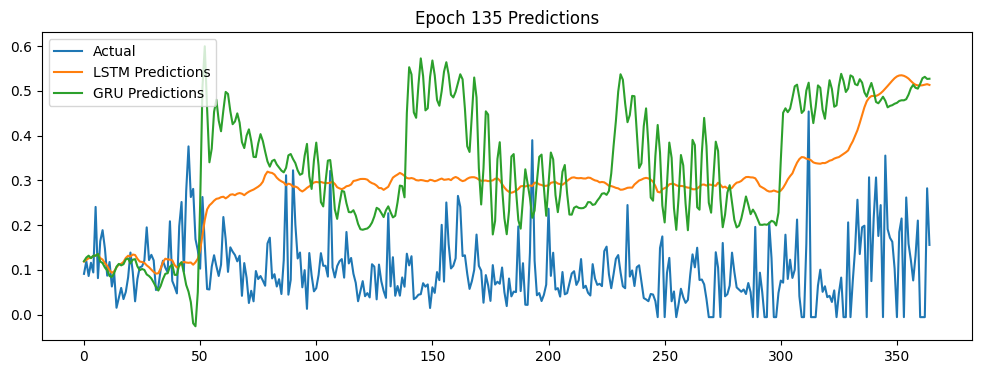

Epoch: 136 LSTM Loss: 0.00880030 GRU Loss: 0.00815109


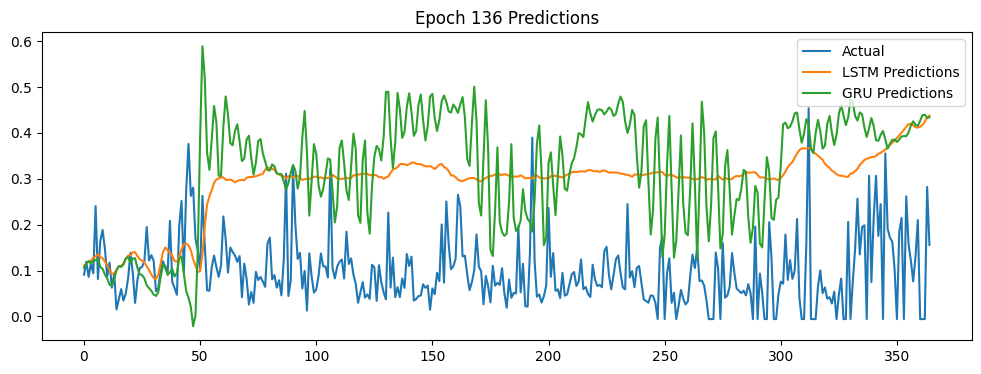

Epoch: 137 LSTM Loss: 0.00884468 GRU Loss: 0.00812850


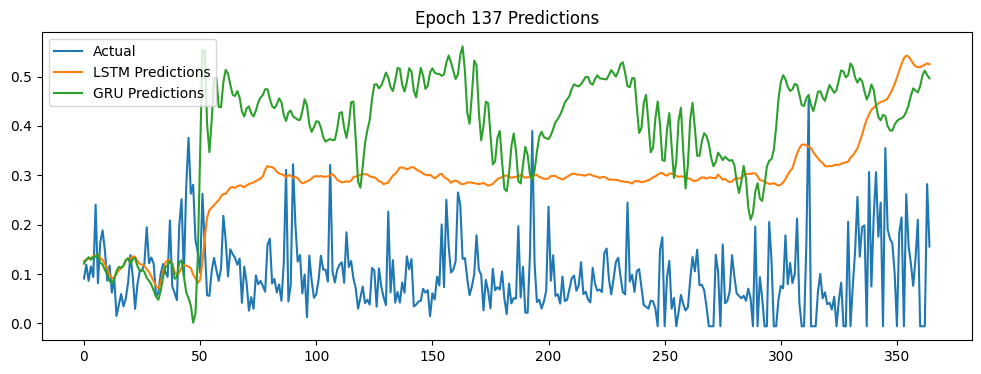

Epoch: 138 LSTM Loss: 0.00900361 GRU Loss: 0.00825602


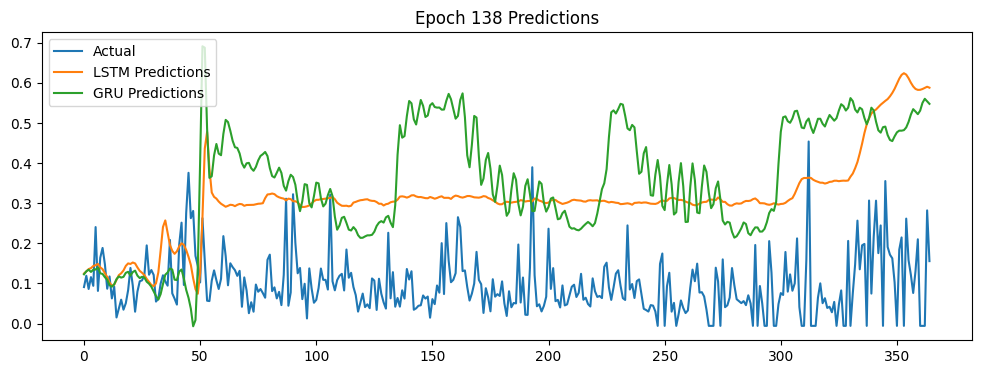

Epoch: 139 LSTM Loss: 0.00928062 GRU Loss: 0.00809430


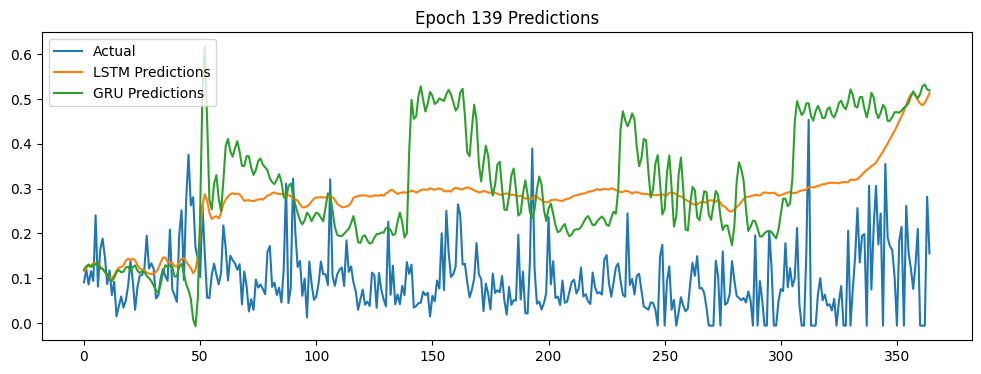

Epoch: 140 LSTM Loss: 0.00885759 GRU Loss: 0.00790665


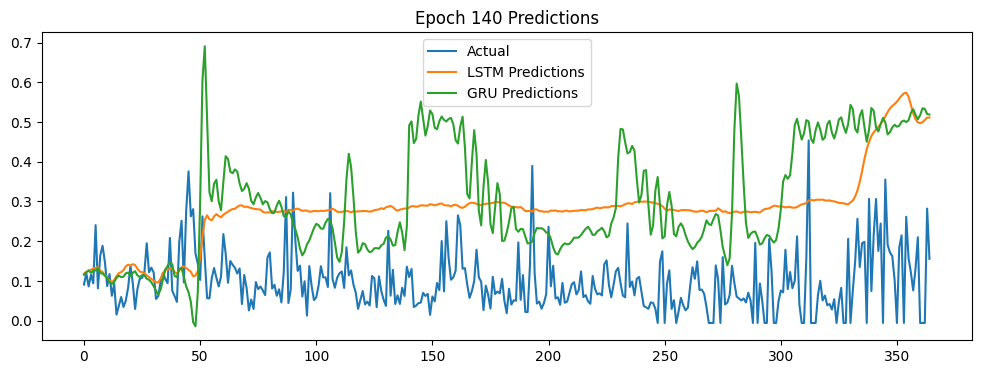

Epoch: 141 LSTM Loss: 0.00888373 GRU Loss: 0.00815487


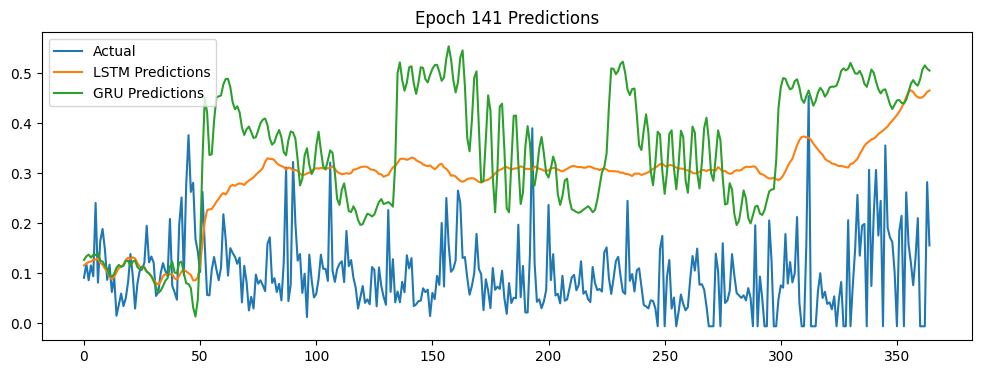

Epoch: 142 LSTM Loss: 0.00887988 GRU Loss: 0.00821297


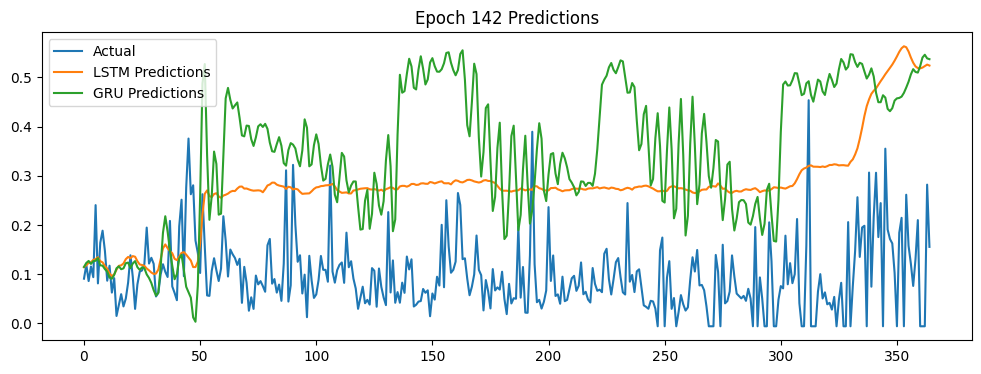

Epoch: 143 LSTM Loss: 0.00864607 GRU Loss: 0.00797798


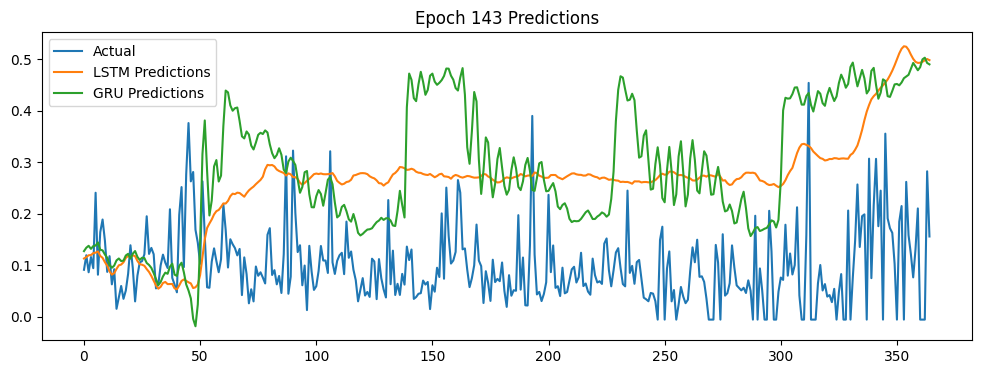

Epoch: 144 LSTM Loss: 0.00871086 GRU Loss: 0.00809246


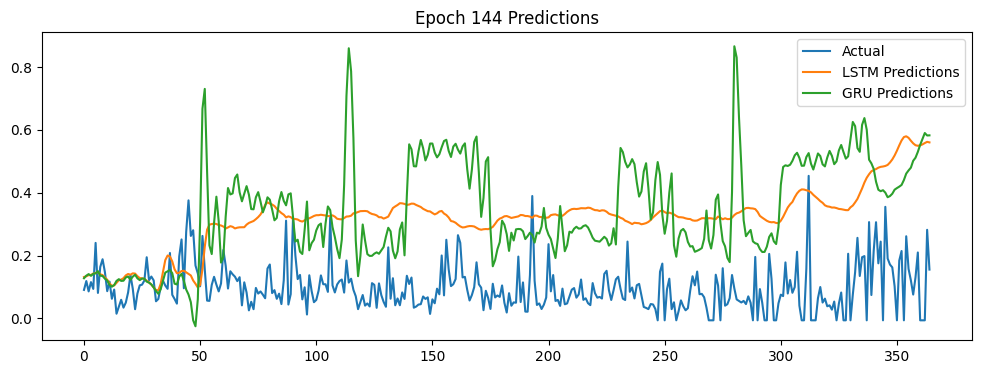

Epoch: 145 LSTM Loss: 0.00904837 GRU Loss: 0.00844904


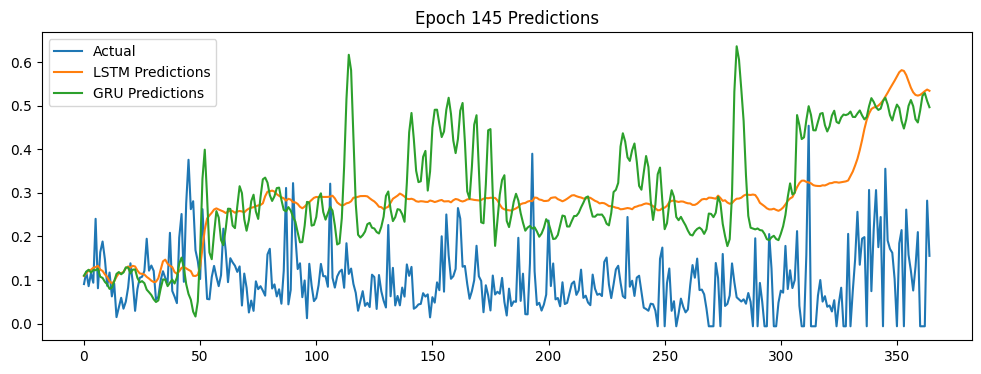

Epoch: 146 LSTM Loss: 0.00887387 GRU Loss: 0.00807851


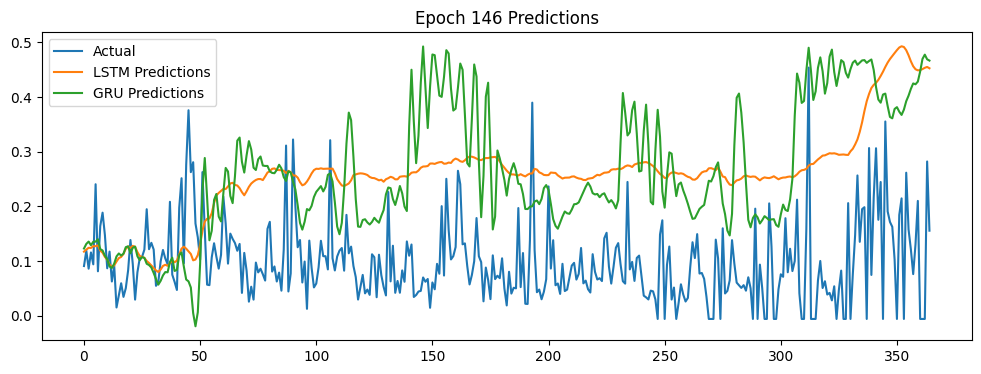

Epoch: 147 LSTM Loss: 0.00902946 GRU Loss: 0.00804611


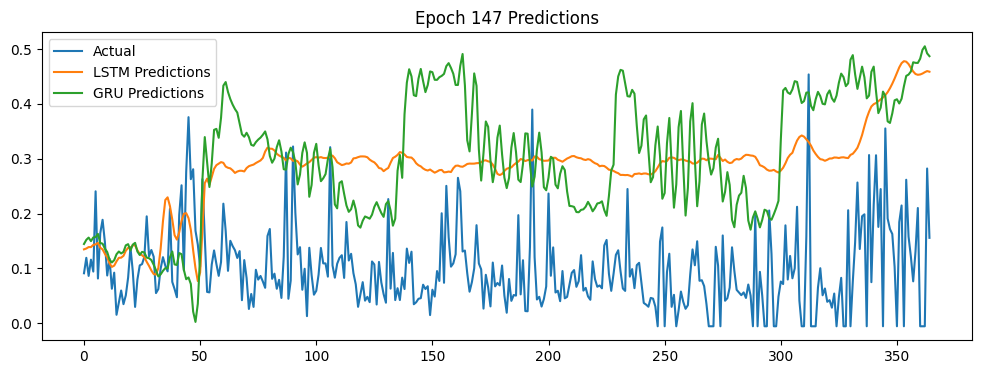

Epoch: 148 LSTM Loss: 0.00872507 GRU Loss: 0.00807929


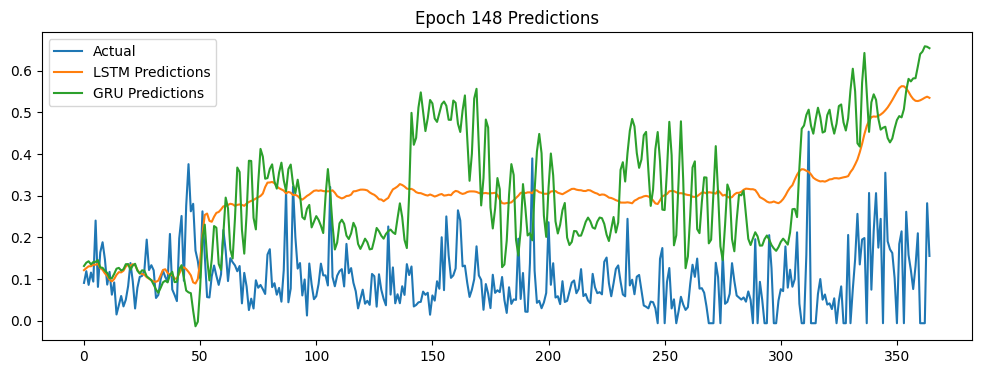

Epoch: 149 LSTM Loss: 0.00884639 GRU Loss: 0.00808807


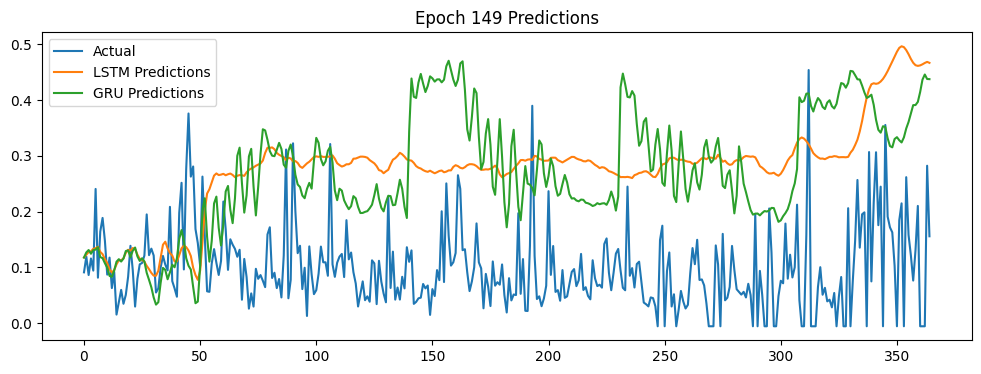

Epoch: 150 LSTM Loss: 0.00871991 GRU Loss: 0.00803436


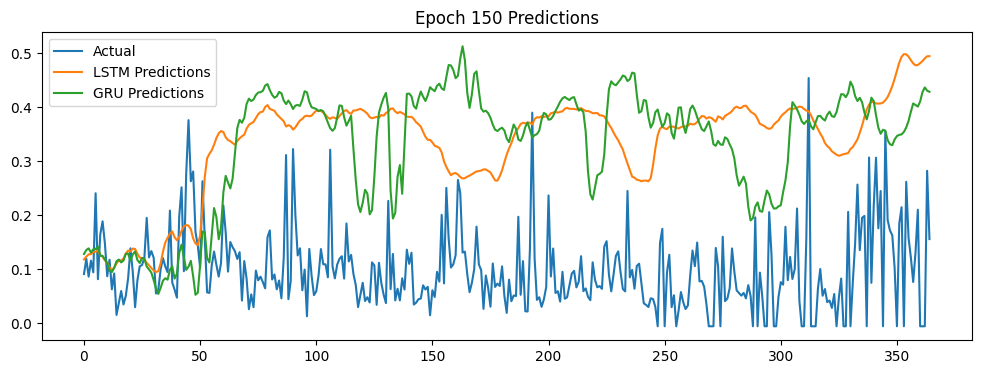

In [ ]:
lstm_model = LSTM(input_size=4, hidden_size=50, num_layers=1, output_size=1)
gru_model = GRU(input_size=4, hidden_size=50, num_layers=1, output_size=1)

criterion = nn.MSELoss()
lstm_optimizer = optim.Adam(lstm_model.parameters(), lr=0.001)
gru_optimizer = optim.Adam(gru_model.parameters(), lr=0.001)

epochs = 150
for epoch in range(epochs):
    lstm_model.train()
    gru_model.train()

    lstm_epoch_loss = 0
    gru_epoch_loss = 0
    for batch_idx, (data, target) in enumerate(train_loader):
        # Train LSTM
        lstm_optimizer.zero_grad()
        lstm_output = lstm_model(data)
        lstm_loss = criterion(lstm_output, target)
        lstm_loss.backward()
        lstm_optimizer.step()
        lstm_epoch_loss += lstm_loss.item()

        # Train GRU
        gru_optimizer.zero_grad()
        gru_output = gru_model(data)
        gru_loss = criterion(gru_output, target)
        gru_loss.backward()
        gru_optimizer.step()
        gru_epoch_loss += gru_loss.item()


    print(f'Epoch: {epoch+1:2} LSTM Loss: {lstm_epoch_loss/len(train_loader):10.8f} GRU Loss: {gru_epoch_loss/len(train_loader):10.8f}')

    # Evaluation and plotting
    lstm_model.eval()
    gru_model.eval()

    with torch.no_grad():
        lstm_predictions = []
        gru_predictions = []
        for data, target in test_loader:
            lstm_pred = lstm_model(data)
            gru_pred = gru_model(data)
            lstm_predictions.extend(lstm_pred.numpy().tolist())
            gru_predictions.extend(gru_pred.numpy().tolist())

        plt.figure(figsize=(12, 4))
        plt.title(f"Epoch {epoch+1} Predictions")
        plt.plot(y_test_normalized, label="Actual")
        plt.plot(lstm_predictions, label="LSTM Predictions")
        plt.plot(gru_predictions, label="GRU Predictions")
        plt.legend()
        plt.show()
